# <ins>Capstone: Patient Survival Prediction<ins>

## 1. Loading Modules 

In [70]:
import numpy as np
from numpy import mean, std
import pandas as pd
import sklearn
from matplotlib import pyplot as plt


#Model metrics
from sklearn import  metrics
from sklearn.model_selection import train_test_split, GridSearchCV, cross_validate
from sklearn.metrics import accuracy_score, roc_auc_score, precision_recall_curve, roc_curve, auc 
from sklearn.metrics import confusion_matrix, precision_score, recall_score, average_precision_score,classification_report
from sklearn import datasets, linear_model
from sklearn.model_selection import cross_val_score, RepeatedStratifiedKFold
from sklearn.pipeline import make_pipeline
from imblearn.pipeline import Pipeline
from sklearn.preprocessing import OrdinalEncoder, MinMaxScaler
from sklearn.datasets import make_classification
from numpy import mean, where
from sklearn import preprocessing

import warnings

# Models 
from sklearn.svm import SVC,LinearSVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier, AdaBoostClassifier, GradientBoostingClassifier, VotingClassifier, BaggingClassifier 
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB 
from sklearn.dummy import DummyClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.neural_network import MLPClassifier
from sklearn.linear_model import LogisticRegression
!pip install catboost
from catboost import CatBoostClassifier, cv
from sklearn.linear_model import SGDClassifier
from sklearn.naive_bayes import BernoulliNB
from sklearn.model_selection import RepeatedStratifiedKFold
import xgboost as xgb
from xgboost.sklearn import XGBClassifier
from sklearn.linear_model import LinearRegression

# Sampling Methods 
from mlxtend.classifier import StackingClassifier
from sklearn.utils import resample
from collections import Counter
from imblearn.under_sampling import RandomUnderSampler
warnings.simplefilter(action='ignore', category=FutureWarning)
from imblearn import under_sampling, over_sampling
from imblearn.over_sampling import SMOTE

# visualization
from matplotlib import pyplot
import seaborn as sns
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.express as px

import time

## Loading Dataset

In [2]:
patient_csv = 'dataset.csv'
data= pd.read_csv(patient_csv)

## <ins>2. Exploring the Dataset<ins>

In [3]:
data.shape

(91713, 85)

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 91713 entries, 0 to 91712
Data columns (total 85 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   encounter_id                   91713 non-null  int64  
 1   patient_id                     91713 non-null  int64  
 2   hospital_id                    91713 non-null  int64  
 3   age                            87485 non-null  float64
 4   bmi                            88284 non-null  float64
 5   elective_surgery               91713 non-null  int64  
 6   ethnicity                      90318 non-null  object 
 7   gender                         91688 non-null  object 
 8   height                         90379 non-null  float64
 9   icu_admit_source               91601 non-null  object 
 10  icu_id                         91713 non-null  int64  
 11  icu_stay_type                  91713 non-null  object 
 12  icu_type                       91713 non-null 

In [5]:
data.columns

Index(['encounter_id', 'patient_id', 'hospital_id', 'age', 'bmi',
       'elective_surgery', 'ethnicity', 'gender', 'height', 'icu_admit_source',
       'icu_id', 'icu_stay_type', 'icu_type', 'pre_icu_los_days', 'weight',
       'apache_2_diagnosis', 'apache_3j_diagnosis', 'apache_post_operative',
       'arf_apache', 'gcs_eyes_apache', 'gcs_motor_apache',
       'gcs_unable_apache', 'gcs_verbal_apache', 'heart_rate_apache',
       'intubated_apache', 'map_apache', 'resprate_apache', 'temp_apache',
       'ventilated_apache', 'd1_diasbp_max', 'd1_diasbp_min',
       'd1_diasbp_noninvasive_max', 'd1_diasbp_noninvasive_min',
       'd1_heartrate_max', 'd1_heartrate_min', 'd1_mbp_max', 'd1_mbp_min',
       'd1_mbp_noninvasive_max', 'd1_mbp_noninvasive_min', 'd1_resprate_max',
       'd1_resprate_min', 'd1_spo2_max', 'd1_spo2_min', 'd1_sysbp_max',
       'd1_sysbp_min', 'd1_sysbp_noninvasive_max', 'd1_sysbp_noninvasive_min',
       'd1_temp_max', 'd1_temp_min', 'h1_diasbp_max', 'h1_diasbp_

In [6]:
data.describe(include='all')

,encounter_id,patient_id,hospital_id,age,bmi,elective_surgery,ethnicity,gender,height,icu_admit_source,...,diabetes_mellitus,hepatic_failure,immunosuppression,leukemia,lymphoma,solid_tumor_with_metastasis,apache_3j_bodysystem,apache_2_bodysystem,Unnamed: 83,hospital_death
count,91713.000000,91713.000000,91713.000000,87485.000000,88284.000000,91713.000000,90318,91688,90379.000000,91601,...,90998.000000,90998.000000,90998.000000,90998.000000,90998.000000,90998.000000,90051,90051,0.0,91713.000000
unique,NaN,NaN,NaN,NaN,NaN,NaN,6,2,NaN,5,...,NaN,NaN,NaN,NaN,NaN,NaN,11,10,NaN,NaN
top,NaN,NaN,NaN,NaN,NaN,NaN,Caucasian,M,NaN,Accident & Emergency,...,NaN,NaN,NaN,NaN,NaN,NaN,Cardiovascular,Cardiovascular,NaN,NaN
freq,NaN,NaN,NaN,NaN,NaN,NaN,70684,49469,NaN,54060,...,NaN,NaN,NaN,NaN,NaN,NaN,29999,38816,NaN,NaN
mean,65606.079280,65537.131464,105.669262,62.309516,29.185818,0.183736,NaN,NaN,169.641588,NaN,...,0.225192,0.012989,0.026165,0.007066,0.004132,0.020638,NaN,NaN,NaN,0.086302
std,37795.088538,37811.252183,62.854406,16.775119,8.275142,0.387271,NaN,NaN,10.795378,NaN,...,0.417711,0.113229,0.159628,0.083763,0.064148,0.142169,NaN,NaN,NaN,0.280811
min,1.000000,1.000000,2.000000,16.000000,14.844926,0.000000,NaN,NaN,137.200000,NaN,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,NaN,NaN,0.000000
25%,32852.000000,32830.000000,47.000000,52.000000,23.641975,0.000000,NaN,NaN,162.500000,NaN,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,NaN,NaN,0.000000
50%,65665.000000,65413.000000,109.000000,65.000000,27.654655,0.000000,NaN,NaN,170.100000,NaN,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,NaN,NaN,0.000000
75%,98342.000000,98298.000000,161.000000,75.000000,32.930206,0.000000,NaN,NaN,177.800000,NaN,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,NaN,NaN,0.000000


## <ins>3. Data Cleaning / Preprocessing <ins>

In [7]:
# No duplicates
data.duplicated().sum()

0

In [8]:
# 3% of the Data is missing
data.isnull().sum().sum()/(data.size)*100

3.694979414683017

In [9]:
data.nunique()

encounter_id                   91713
patient_id                     91713
hospital_id                      147
age                               74
bmi                            34888
                               ...  
solid_tumor_with_metastasis        2
apache_3j_bodysystem              11
apache_2_bodysystem               10
Unnamed: 83                        0
hospital_death                     2
Length: 85, dtype: int64

In [10]:
null_counts = data.isnull().sum()
null_counts[null_counts > 0].sort_values(ascending=False)

Unnamed: 83               91713
d1_potassium_min           9585
d1_potassium_max           9585
h1_mbp_noninvasive_max     9084
h1_mbp_noninvasive_min     9084
                          ...  
d1_sysbp_min                159
d1_heartrate_max            145
d1_heartrate_min            145
icu_admit_source            112
gender                       25
Length: 75, dtype: int64

In [11]:
data.select_dtypes(include=[np.object])

C:\Users\61425\AppData\Local\Temp/ipykernel_7312/2582097960.py:1: DeprecationWarning: `np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  data.select_dtypes(include=[np.object])


,ethnicity,gender,icu_admit_source,icu_stay_type,icu_type,apache_3j_bodysystem,apache_2_bodysystem
0,Caucasian,M,Floor,admit,CTICU,Sepsis,Cardiovascular
1,Caucasian,F,Floor,admit,Med-Surg ICU,Respiratory,Respiratory
2,Caucasian,F,Accident & Emergency,admit,Med-Surg ICU,Metabolic,Metabolic
3,Caucasian,F,Operating Room / Recovery,admit,CTICU,Cardiovascular,Cardiovascular
4,Caucasian,M,Accident & Emergency,admit,Med-Surg ICU,Trauma,Trauma
...,...,...,...,...,...,...,...
91708,Caucasian,M,Floor,admit,Cardiac ICU,Sepsis,Cardiovascular
91709,Caucasian,F,Floor,admit,Med-Surg ICU,Sepsis,Cardiovascular
91710,Caucasian,M,Accident & Emergency,admit,Med-Surg ICU,Metabolic,Metabolic
91711,Caucasian,F,Accident & Emergency,admit,Med-Surg ICU,Respiratory,Respiratory


In [12]:
# droping this column because theirs nothing in it 
data.drop(["encounter_id" ,"patient_id" ,"hospital_id","Unnamed: 83", ],axis =1, inplace=True)

data['gender'] = data['gender'].fillna("Not Specified")

In [13]:
null_counts = data.isnull().sum()
null_counts[null_counts > 0].sort_values(ascending=False)

d1_potassium_min            9585
d1_potassium_max            9585
h1_mbp_noninvasive_max      9084
h1_mbp_noninvasive_min      9084
apache_4a_icu_death_prob    7947
                            ... 
d1_sysbp_min                 159
d1_sysbp_max                 159
d1_heartrate_min             145
d1_heartrate_max             145
icu_admit_source             112
Length: 73, dtype: int64

#### Making Catagorical Data Numrical

In [14]:
Num=[]
for col in data.columns:
    if (data[col].dtype==int)or (data[col].dtype==float):
        Num.append(col)
print (Num)

for col in data.columns:
    if col in Num :
        data[col].fillna(data[col].median(), inplace=True)


['age', 'bmi', 'height', 'pre_icu_los_days', 'weight', 'apache_2_diagnosis', 'apache_3j_diagnosis', 'arf_apache', 'gcs_eyes_apache', 'gcs_motor_apache', 'gcs_unable_apache', 'gcs_verbal_apache', 'heart_rate_apache', 'intubated_apache', 'map_apache', 'resprate_apache', 'temp_apache', 'ventilated_apache', 'd1_diasbp_max', 'd1_diasbp_min', 'd1_diasbp_noninvasive_max', 'd1_diasbp_noninvasive_min', 'd1_heartrate_max', 'd1_heartrate_min', 'd1_mbp_max', 'd1_mbp_min', 'd1_mbp_noninvasive_max', 'd1_mbp_noninvasive_min', 'd1_resprate_max', 'd1_resprate_min', 'd1_spo2_max', 'd1_spo2_min', 'd1_sysbp_max', 'd1_sysbp_min', 'd1_sysbp_noninvasive_max', 'd1_sysbp_noninvasive_min', 'd1_temp_max', 'd1_temp_min', 'h1_diasbp_max', 'h1_diasbp_min', 'h1_diasbp_noninvasive_max', 'h1_diasbp_noninvasive_min', 'h1_heartrate_max', 'h1_heartrate_min', 'h1_mbp_max', 'h1_mbp_min', 'h1_mbp_noninvasive_max', 'h1_mbp_noninvasive_min', 'h1_resprate_max', 'h1_resprate_min', 'h1_spo2_max', 'h1_spo2_min', 'h1_sysbp_max', '

In [15]:
categorical=[]
for col in data.columns:
    if  (data[col].dtype==object):
        categorical.append(col)
print (categorical)

['ethnicity', 'gender', 'icu_admit_source', 'icu_stay_type', 'icu_type', 'apache_3j_bodysystem', 'apache_2_bodysystem']


In [16]:
ord_enc = OrdinalEncoder()
data["apache_2_bodysystem"] = ord_enc.fit_transform(data[["apache_2_bodysystem"]])
data["apache_3j_bodysystem"] = ord_enc.fit_transform(data[["apache_3j_bodysystem"]])
data["icu_type"] = ord_enc.fit_transform(data[["icu_type"]])
data["icu_stay_type"] = ord_enc.fit_transform(data[["icu_stay_type"]])
data["icu_admit_source"] = ord_enc.fit_transform(data[["icu_admit_source"]])
data["gender"] = ord_enc.fit_transform(data[["gender"]])
data["ethnicity"] = ord_enc.fit_transform(data[["ethnicity"]])

### Removing Nulls

In [17]:
# Checking 
data.isnull().sum(axis=0).sort_values(ascending=False)

apache_2_bodysystem     1662
apache_3j_bodysystem    1662
ethnicity               1395
icu_admit_source         112
age                        0
                        ... 
d1_diasbp_min              0
d1_diasbp_max              0
ventilated_apache          0
temp_apache                0
hospital_death             0
Length: 81, dtype: int64

In [18]:
pd.set_option('display.max_rows', None)
data.isnull().sum(axis=0).sort_values(ascending=False)


apache_2_bodysystem              1662
apache_3j_bodysystem             1662
ethnicity                        1395
icu_admit_source                  112
age                                 0
h1_heartrate_min                    0
h1_spo2_max                         0
h1_resprate_min                     0
h1_resprate_max                     0
h1_mbp_noninvasive_min              0
h1_mbp_noninvasive_max              0
h1_mbp_min                          0
h1_mbp_max                          0
h1_diasbp_noninvasive_min           0
h1_heartrate_max                    0
h1_sysbp_max                        0
h1_diasbp_noninvasive_max           0
h1_diasbp_min                       0
h1_diasbp_max                       0
d1_temp_min                         0
d1_temp_max                         0
h1_spo2_min                         0
h1_sysbp_noninvasive_min            0
h1_sysbp_min                        0
h1_sysbp_noninvasive_max            0
solid_tumor_with_metastasis         0
lymphoma    

In [19]:
# Dropping the remaining null values 
data2=data.dropna()

In [20]:
data2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 88589 entries, 0 to 91712
Data columns (total 81 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   age                            88589 non-null  float64
 1   bmi                            88589 non-null  float64
 2   elective_surgery               88589 non-null  int64  
 3   ethnicity                      88589 non-null  float64
 4   gender                         88589 non-null  float64
 5   height                         88589 non-null  float64
 6   icu_admit_source               88589 non-null  float64
 7   icu_id                         88589 non-null  int64  
 8   icu_stay_type                  88589 non-null  float64
 9   icu_type                       88589 non-null  float64
 10  pre_icu_los_days               88589 non-null  float64
 11  weight                         88589 non-null  float64
 12  apache_2_diagnosis             88589 non-null 

# <ins>4.EDA<ins>

In [21]:
patient_csv = 'dataset.csv'
dataG= pd.read_csv(patient_csv)
dataG.drop(["encounter_id" ,"patient_id" ,"hospital_id","Unnamed: 83", ],axis =1, inplace=True)
dataG['gender'] = dataG['gender'].fillna("Not Specified")


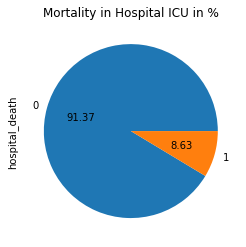

In [22]:
_=data.hospital_death.value_counts().plot(kind='pie',autopct="%.2f",title ='Mortality in Hospital ICU in %')

C:\Users\61425\AppData\Local\Temp/ipykernel_7312/2606884334.py:3: UserWarning: DelftStack
  warnings.warn('DelftStack')
C:\Users\61425\AppData\Local\Temp/ipykernel_7312/2606884334.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(2,


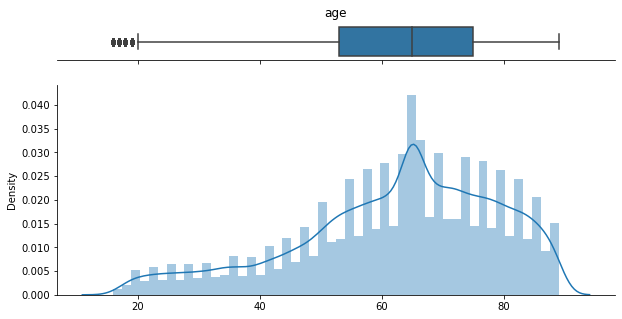

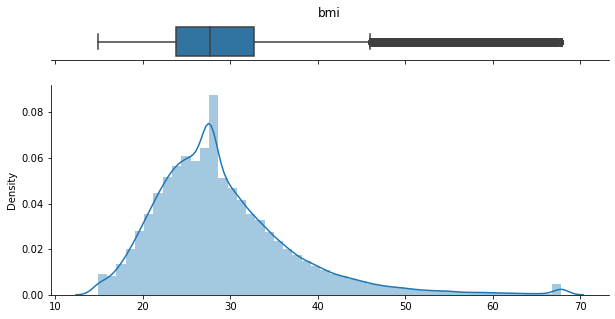

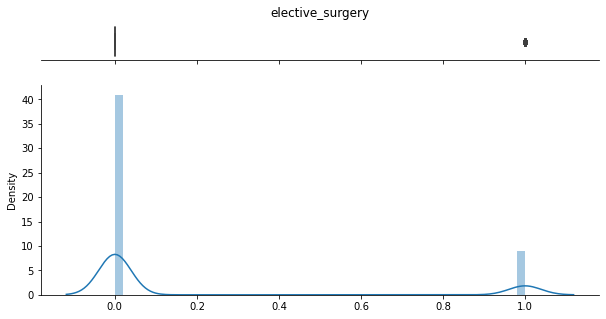

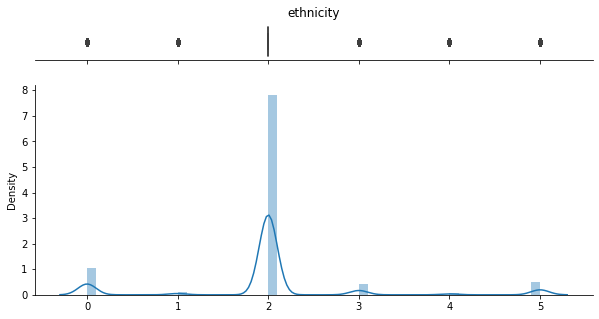

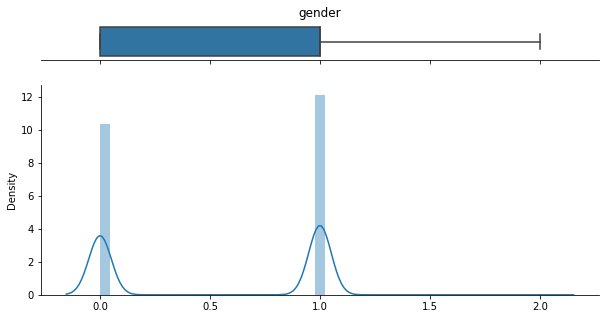

...

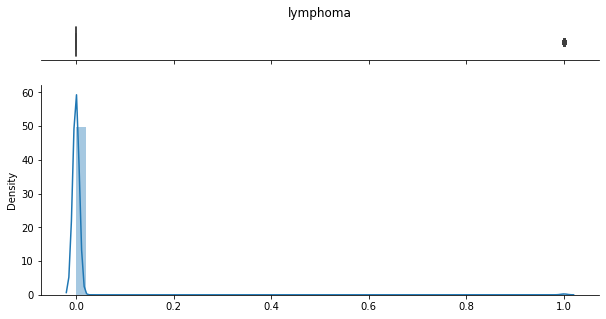

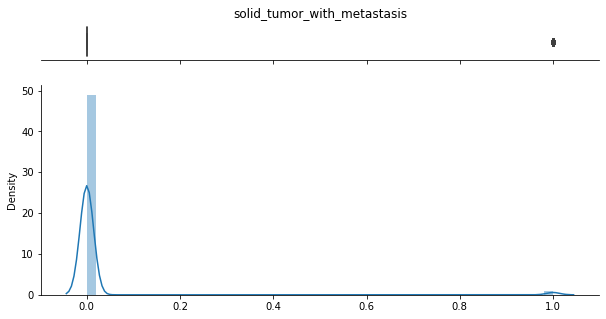

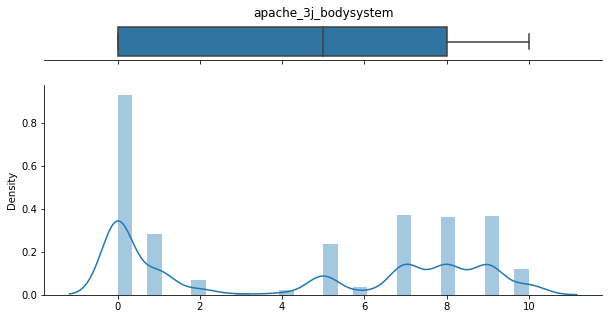

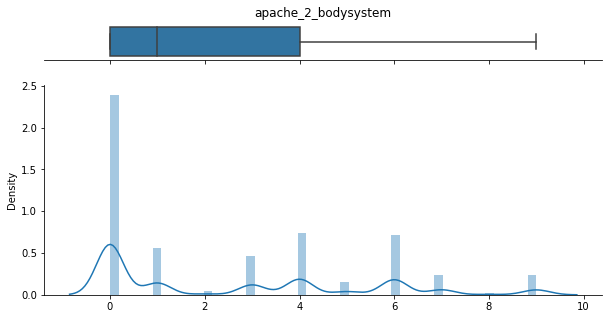

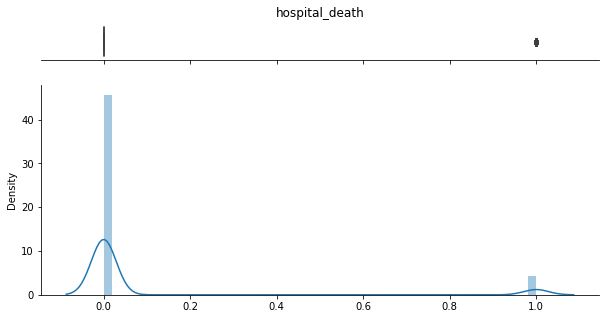

In [23]:
# Check for Outliers
warnings.filterwarnings('ignore', '.*do not.*', )
warnings.warn('DelftStack')
warnings.warn('Do not show this message')
for c in data2.columns:
    fig, ax = plt.subplots(2, 
                           figsize = (10, 5),
                           sharex = True, 
                           gridspec_kw = {'height_ratios': (0.15, 0.85)})

    ax_box = ax[0]
    ax_box = sns.boxplot(data2[c], ax = ax_box)
    ax_box.set(title = c, yticks = [], xlabel = '')
    sns.despine(ax = ax_box, left = True)
    
    ax_hist = ax[1]
    
    if c == 'Donated_Mar_2007':       
        ax_hist = sns.distplot(data2[c], kde=False, ax = ax_hist)
        ax_hist.set(xlabel = '')
        sns.despine(ax = ax_hist)
    else:
        ax_hist = sns.distplot(data2[c], ax = ax_hist)
        ax_hist.set(xlabel = '')
        sns.despine(ax = ax_hist)
        

plt.show()

## Correlation

array([[<AxesSubplot:title={'center':'age'}>,
        <AxesSubplot:title={'center':'bmi'}>,
        <AxesSubplot:title={'center':'elective_surgery'}>,
        <AxesSubplot:title={'center':'ethnicity'}>,
        <AxesSubplot:title={'center':'gender'}>,
        <AxesSubplot:title={'center':'height'}>,
        <AxesSubplot:title={'center':'icu_admit_source'}>,
        <AxesSubplot:title={'center':'icu_id'}>,
        <AxesSubplot:title={'center':'icu_stay_type'}>],
       [<AxesSubplot:title={'center':'icu_type'}>,
        <AxesSubplot:title={'center':'pre_icu_los_days'}>,
        <AxesSubplot:title={'center':'weight'}>,
        <AxesSubplot:title={'center':'apache_2_diagnosis'}>,
        <AxesSubplot:title={'center':'apache_3j_diagnosis'}>,
        <AxesSubplot:title={'center':'apache_post_operative'}>,
        <AxesSubplot:title={'center':'arf_apache'}>,
        <AxesSubplot:title={'center':'gcs_eyes_apache'}>,
        <AxesSubplot:title={'center':'gcs_motor_apache'}>],
       [<AxesSubp

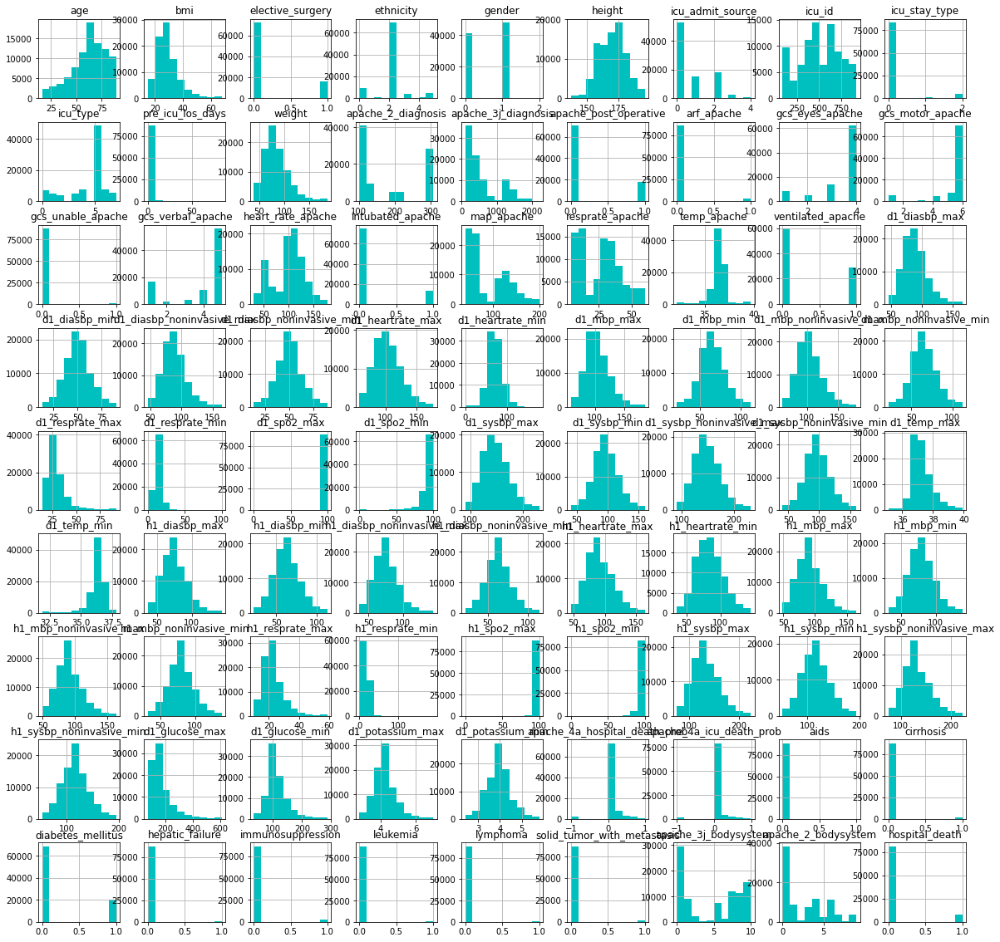

In [24]:
data2.hist(figsize=(20,20), color = 'c')

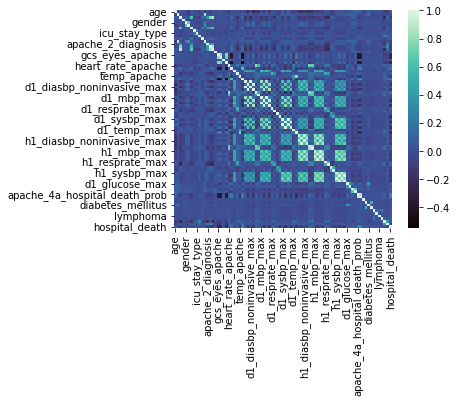

In [25]:
import seaborn as sns
ax = sns.heatmap(data.corr(),square=True, cmap="mako")

In [26]:
data.corr()["hospital_death"].sort_values()

gcs_motor_apache                -0.273661
gcs_eyes_apache                 -0.250703
gcs_verbal_apache               -0.231056
d1_sysbp_min                    -0.209809
d1_spo2_min                     -0.209326
d1_sysbp_noninvasive_min        -0.208547
d1_temp_min                     -0.202283
d1_mbp_min                      -0.194937
d1_mbp_noninvasive_min          -0.193875
d1_diasbp_min                   -0.179233
d1_diasbp_noninvasive_min       -0.178578
temp_apache                     -0.152256
h1_sysbp_noninvasive_min        -0.144104
h1_sysbp_min                    -0.143720
h1_mbp_noninvasive_min          -0.142302
h1_mbp_min                      -0.138259
h1_diasbp_noninvasive_min       -0.127325
h1_diasbp_min                   -0.122588
h1_spo2_min                     -0.105874
elective_surgery                -0.093574
apache_3j_diagnosis             -0.090362
apache_2_diagnosis              -0.088434
apache_post_operative           -0.083674
h1_sysbp_max                    -0

## How often do people die in hospital 

C:\Users\61425\AppData\Local\Temp/ipykernel_7312/1751685132.py:6: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  plt.text(-18000,-0.08, 'No Death',{'font': 'Serif','weight':'bold','Size': '16','style':'normal', 'color':'#512b58'})
C:\Users\61425\AppData\Local\Temp/ipykernel_7312/1751685132.py:9: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  plt.text(-18000,1, 'Mortality', {'font': 'Serif','weight':'bold','Size': '16','style':'normal', 'color':'#fe346e'})
C:\Users\61425\AppData\Local\Temp/ipykernel_7312/1751685132.py:15: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  plt.text(-15000,1.77, 'Percentage of Morality in Hospital ICU' ,{'font': 'Serif', 'Size': '25','weight':'bold', 'color':'black'})
C:\Users\61425\AppData\Local\

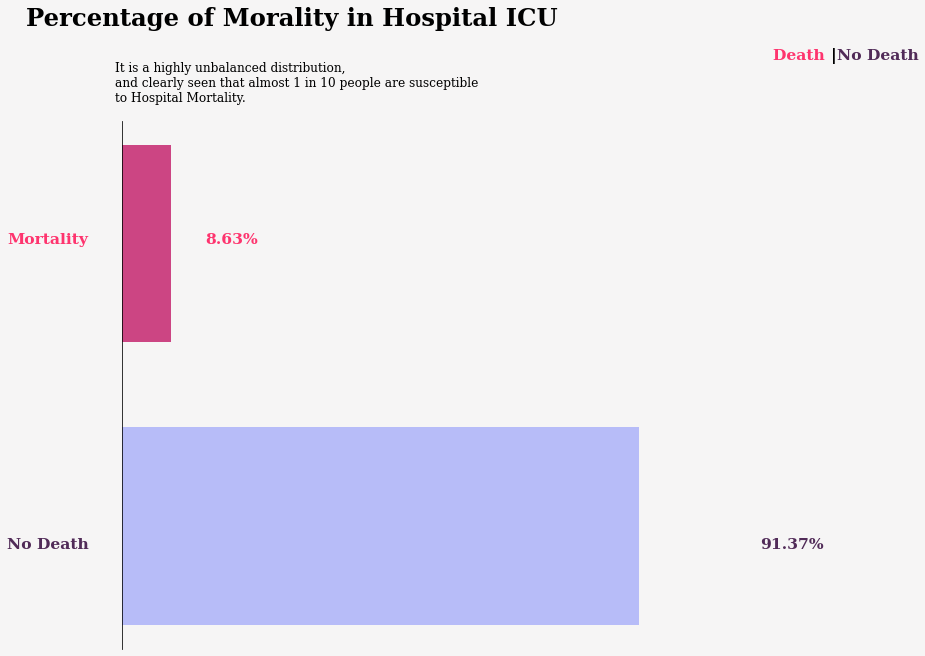

In [27]:
x = pd.DataFrame( data2.groupby(['hospital_death'])['hospital_death'].count())

# plot
fig, ax = plt.subplots(figsize = (10,10), dpi = 70)
ax.barh([1], x.hospital_death[1], height = 0.7, color = '#CC4583')
plt.text(-18000,-0.08, 'No Death',{'font': 'Serif','weight':'bold','Size': '16','style':'normal', 'color':'#512b58'})
plt.text(100000,-0.08, '91.37%',{'font':'Serif','weight':'bold' ,'size':'16','color':'#512b58'})
ax.barh([0], x.hospital_death[0], height = 0.7, color = '#B7BCF8')
plt.text(-18000,1, 'Mortality', {'font': 'Serif','weight':'bold','Size': '16','style':'normal', 'color':'#fe346e'})
plt.text(13000,1, '8.63%',{'font':'Serif', 'weight':'bold','size':'16','color':'#fe346e'})

fig.patch.set_facecolor('#f6f5f5')
ax.set_facecolor('#f6f5f5')

plt.text(-15000,1.77, 'Percentage of Morality in Hospital ICU' ,{'font': 'Serif', 'Size': '25','weight':'bold', 'color':'black'})
plt.text(102000,1.65, 'Death ', {'font': 'Serif','weight':'bold','Size': '16','weight':'bold','style':'normal', 'color':'#fe346e'})
plt.text(111000,1.65, '|', {'color':'black' , 'size':'16', 'weight': 'bold'})
plt.text(112000,1.65, 'No Death', {'font': 'Serif','weight':'bold', 'Size': '16','style':'normal', 'weight':'bold','color':'#512b58'})
plt.text(-1150,1.5, 'It is a highly unbalanced distribution,\nand clearly seen that almost 1 in 10 people are susceptible \nto Hospital Mortality.', 
        {'font':'Serif', 'size':'12.5','color': 'black'})

ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(True)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

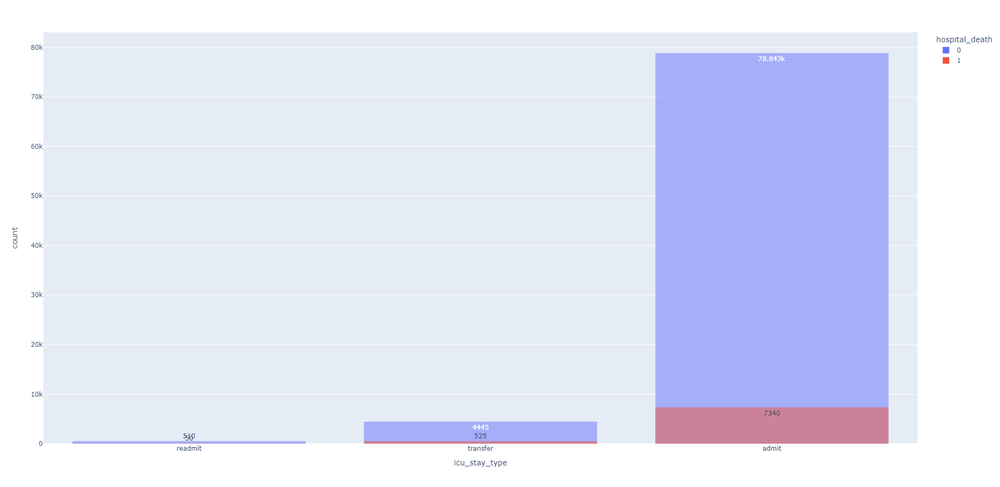

In [28]:
patient_csv = 'dataset.csv'
dataG= pd.read_csv(patient_csv)
dataG.drop(["encounter_id" ,"patient_id" ,"hospital_id","Unnamed: 83", ],axis =1, inplace=True)

dataG['gender'] = dataG['gender'].fillna("Not Specified")

import plotly.express as px

df = px.data.tips()
fig = px.histogram(dataG, x="icu_stay_type",  color = "hospital_death", barmode='overlay', text_auto=True, width=800,
    height=900).update_xaxes(categoryorder='total ascending')
fig.show()

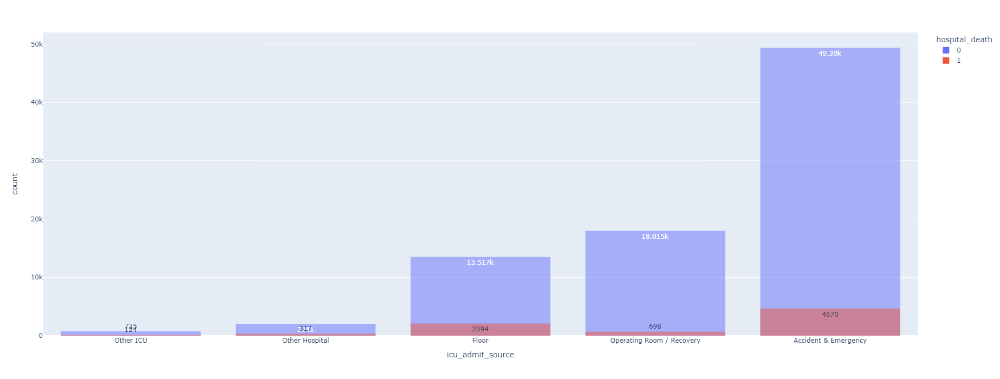

In [29]:
df = px.data.tips()
fig = px.histogram(dataG, x="icu_admit_source",  color = "hospital_death", barmode='overlay', text_auto=True, width=600,
    height=700).update_xaxes(categoryorder='total ascending')
fig.show()

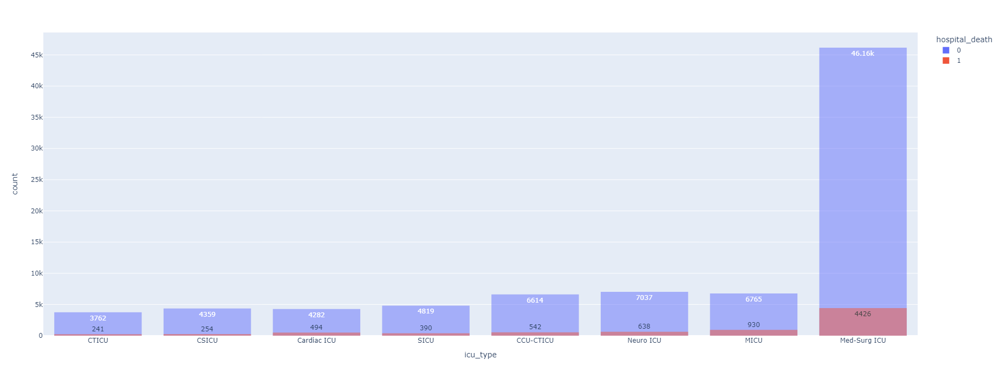

In [30]:
patient_csv = 'dataset.csv'
dataG= pd.read_csv(patient_csv)
dataG.drop(["encounter_id" ,"patient_id" ,"hospital_id","Unnamed: 83", ],axis =1, inplace=True)

dataG['gender'] = dataG['gender'].fillna("Not Specified")

import plotly.express as px

df = px.data.tips()
fig = px.histogram(dataG, x="icu_type",  color = "hospital_death", barmode='overlay', text_auto=True, width=600,
    height=700).update_xaxes(categoryorder='total ascending')
fig.show()


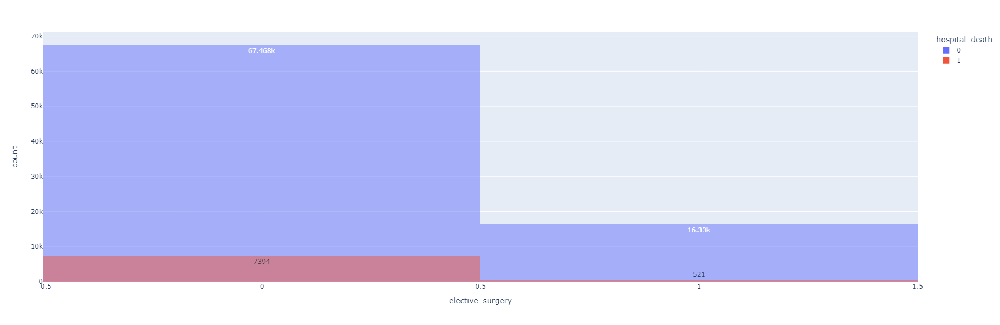

In [31]:
df = px.data.tips()

fig = px.histogram(dataG, x="elective_surgery",  color = "hospital_death", barmode='overlay', text_auto=True, width=600,
    height=600).update_xaxes(categoryorder='total ascending')
fig.show()

## Demographic Factors effecting Mortality

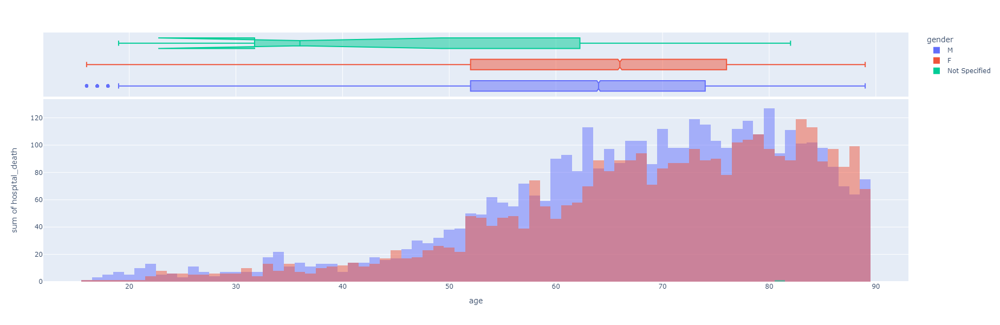

In [32]:

fig = px.histogram(dataG[['age','gender','hospital_death','bmi']], x="age", y="hospital_death", barmode='overlay',color="gender",
                   marginal="box", # or violin, rug
                   hover_data=dataG[['age','gender','hospital_death','bmi']].columns, width=600,
    height=600)
fig.show()

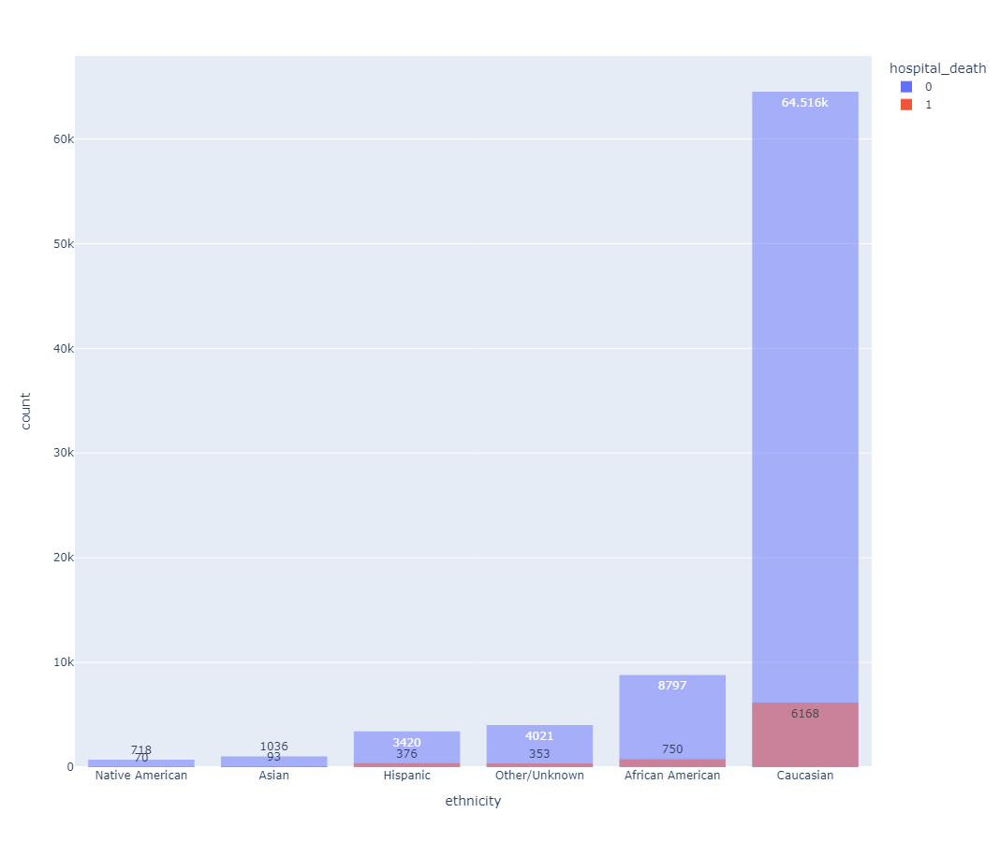

In [164]:
df = px.data.tips()
fig = px.histogram(dataG, x="ethnicity",  color = "hospital_death", barmode='overlay', text_auto=True, width=800,
    height=900).update_xaxes(categoryorder='total ascending')
fig.show()

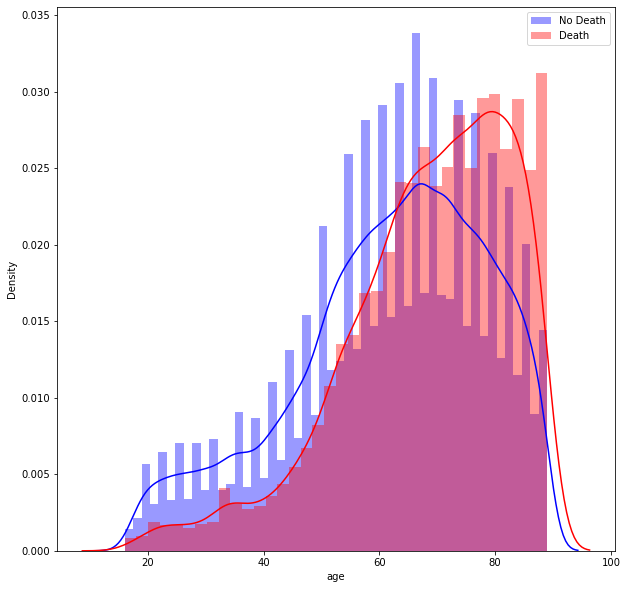

In [165]:
plt.figure(figsize=(10, 10))
sns.distplot(dataG.age[data.hospital_death == 0], color="b", label="No Death")
sns.distplot(dataG.age[data.hospital_death == 1], color="r", label="Death")
plt.legend()

C:\Users\61425\AppData\Local\Temp/ipykernel_7312/3058204293.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\61425\AppData\Local\Temp/ipykernel_7312/3058204293.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



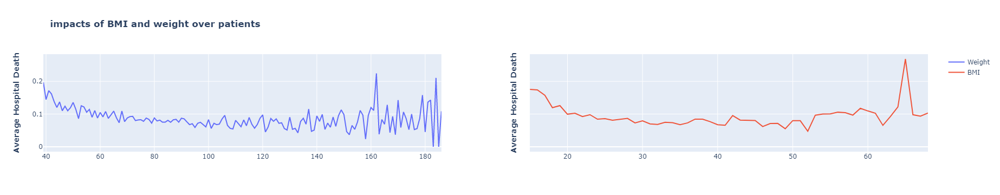

In [34]:
weight_df=data2[['weight','hospital_death','bmi']]
weight_df['weight']=weight_df['weight'].round(0)
weight_df['bmi']=weight_df['bmi'].round(0)
weight_death=weight_df[['weight','hospital_death']].groupby('weight').mean().reset_index()
bmi_death=weight_df[['bmi','hospital_death']].groupby('bmi').mean().reset_index()
fig = make_subplots(rows=1, cols=2, shared_yaxes=True)
fig.add_trace(
    go.Scatter(x=weight_death['weight'], y=weight_death['hospital_death'], name="Weight"),
   row=1, col=1
)
fig.add_trace(
    go.Scatter(x=bmi_death['bmi'], y=bmi_death['hospital_death'], name="BMI"),
    row=1, col=2
)
fig.update_layout(
    title_text="<b>impacts of BMI and weight over patients<b>"
)
fig.update_yaxes(title_text="<b>Average Hospital Death")
fig.show()

### Disease vs death

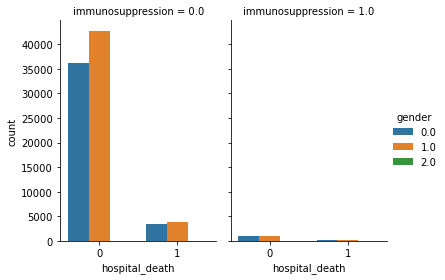

In [35]:
patient_csv = 'dataset.csv'
dataG= pd.read_csv(patient_csv)
dataG.drop(["encounter_id" ,"patient_id" ,"hospital_id","Unnamed: 83", ],axis =1, inplace=True)

dataG['gender'] = dataG['gender'].fillna("Not Specified")

DDF= pd.DataFrame(dataG, columns=['hospital_death','aids', 'cirrhosis', 'diabetes_mellitus', 'hepatic_failure','immunosuppression','leukemia', 'lymphoma', 'solid_tumor_with_metastasis'])
    

g = sns.catplot(x="hospital_death", hue="gender", col="immunosuppression",
                data=data2, kind="count",
                height=4, aspect=.7);

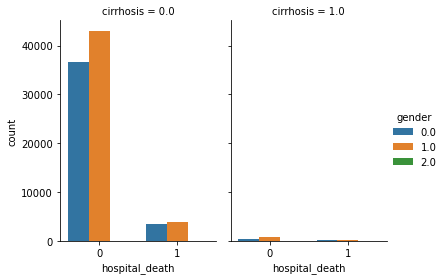

In [36]:
g = sns.catplot(x="hospital_death", hue="gender", col="cirrhosis",
                data=data2, kind="count",
                height=4, aspect=.7);

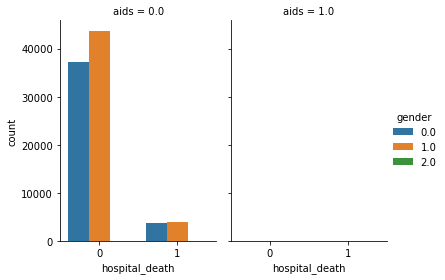

In [37]:
g = sns.catplot(x="hospital_death", hue="gender", col="aids",
                data=data2, kind="count",
                height=4, aspect=.7);

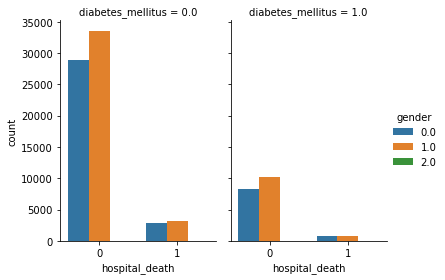

In [38]:
g = sns.catplot(x="hospital_death", hue="gender", col="diabetes_mellitus",
                data=data2, kind="count",
                height=4, aspect=.7);

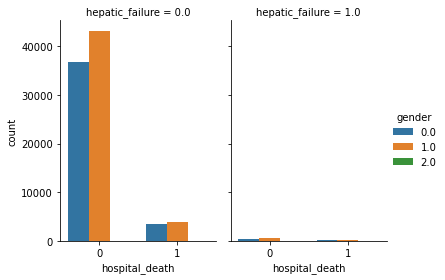

In [39]:
g = sns.catplot(x="hospital_death", hue="gender", col="hepatic_failure",
                data=data2, kind="count",
                height=4, aspect=.7);

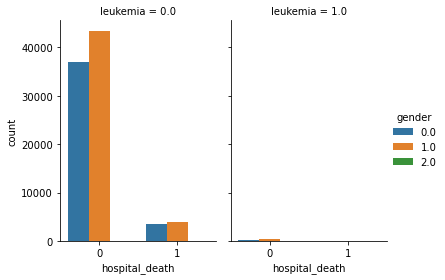

In [40]:
g = sns.catplot(x="hospital_death", hue="gender", col="leukemia",
                data=data2, kind="count",
                height=4, aspect=.7);

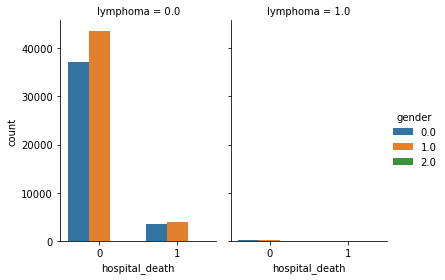

In [41]:
g = sns.catplot(x="hospital_death", hue="gender", col="lymphoma",
                data=data2, kind="count",
                height=4, aspect=.7);

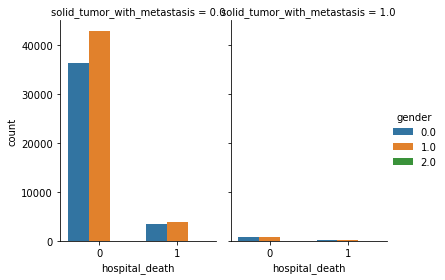

In [42]:
g = sns.catplot(x="hospital_death", hue="gender", col="solid_tumor_with_metastasis",
                data=data2, kind="count",
                height=4, aspect=.7);

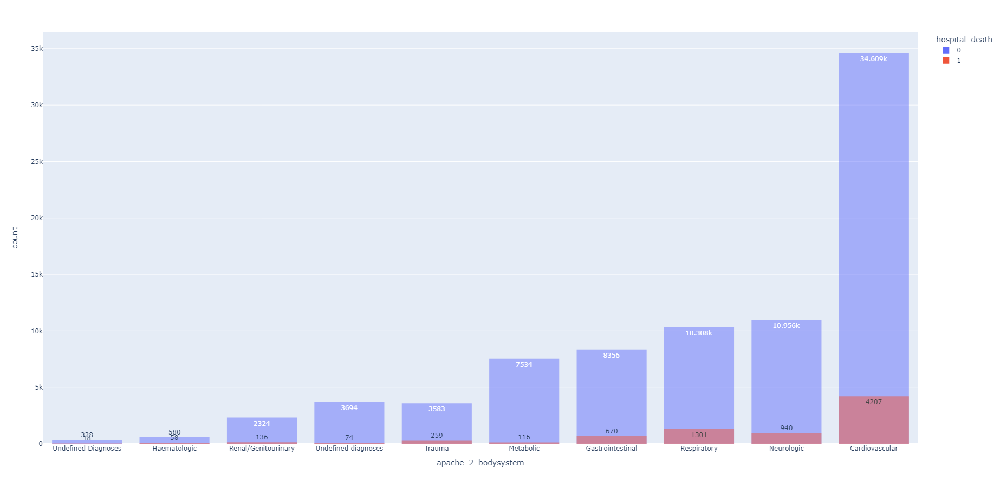

In [43]:
patient_csv = 'dataset.csv'
dataG= pd.read_csv(patient_csv)
dataG.drop(["encounter_id" ,"patient_id" ,"hospital_id","Unnamed: 83", ],axis =1, inplace=True)

dataG['gender'] = dataG['gender'].fillna("Not Specified")

import plotly.express as px

df = px.data.tips()
fig = px.histogram(dataG, x="apache_2_bodysystem",  color = "hospital_death", barmode='overlay', text_auto=True, width=800,
    height=900).update_xaxes(categoryorder='total ascending')
fig.show()

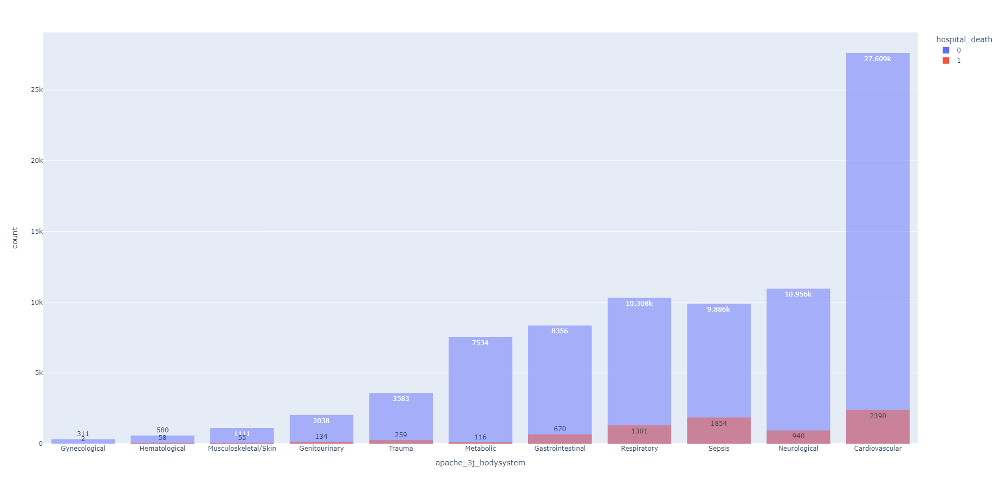

In [44]:
df = px.data.tips()
fig = px.histogram(dataG, x="apache_3j_bodysystem",  color = "hospital_death", barmode='overlay', text_auto=True, width=800,
    height=900).update_xaxes(categoryorder='total ascending')
fig.show()

# Results: Vitals

ETHNICITY

0    Caucasian
1    Caucasian
2    Caucasian
3    Caucasian
4    Caucasian
Name: ethnicity, dtype: object


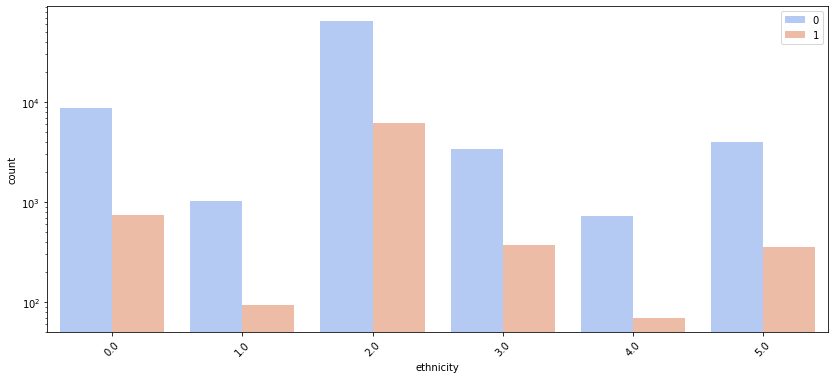

_______________________________________________________________________________
GENDER

0    M
1    F
2    F
3    F
4    M
Name: gender, dtype: object


C:\Users\61425\AppData\Local\Temp/ipykernel_7312/616974343.py:29: DeprecationWarning:

`np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



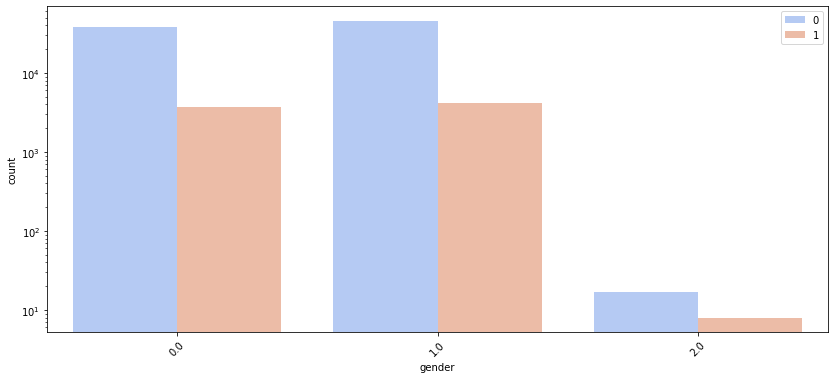

C:\Users\61425\AppData\Local\Temp/ipykernel_7312/616974343.py:29: DeprecationWarning:

`np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



_______________________________________________________________________________
HEIGHT

0    180.3
1    160.0
2    172.7
3    165.1
4    188.0
Name: height, dtype: float64


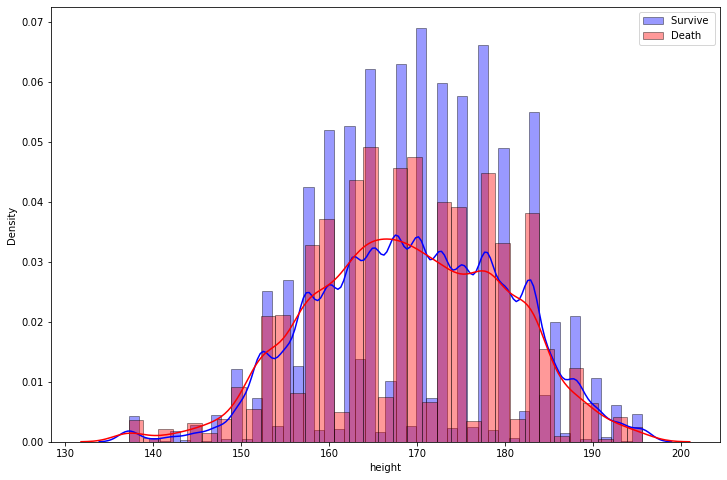

_______________________________________________________________________________
ICU_ADMIT_SOURCE

0                        Floor
1                        Floor
2         Accident & Emergency
3    Operating Room / Recovery
4         Accident & Emergency
Name: icu_admit_source, dtype: object


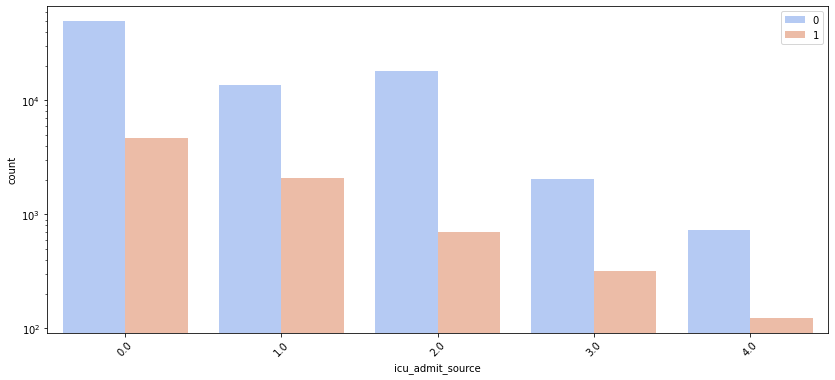

C:\Users\61425\AppData\Local\Temp/ipykernel_7312/616974343.py:29: DeprecationWarning:

`np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



_______________________________________________________________________________
ICU_ID

0    92
1    90
2    93
3    92
4    91
Name: icu_id, dtype: int64


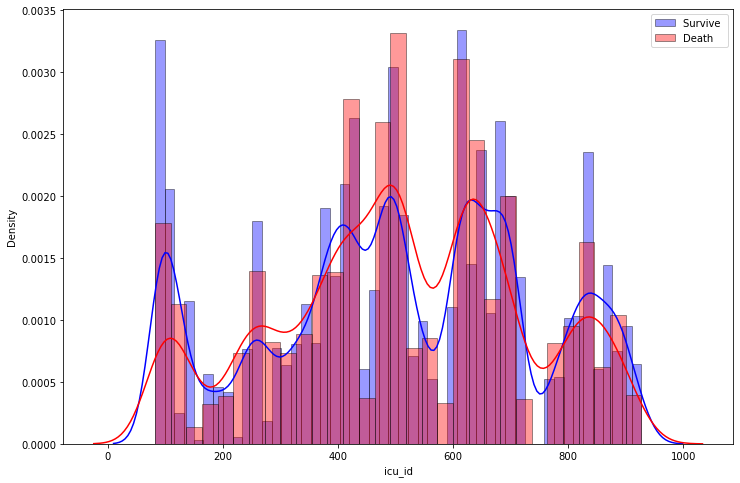

_______________________________________________________________________________
ICU_STAY_TYPE

0    admit
1    admit
2    admit
3    admit
4    admit
Name: icu_stay_type, dtype: object


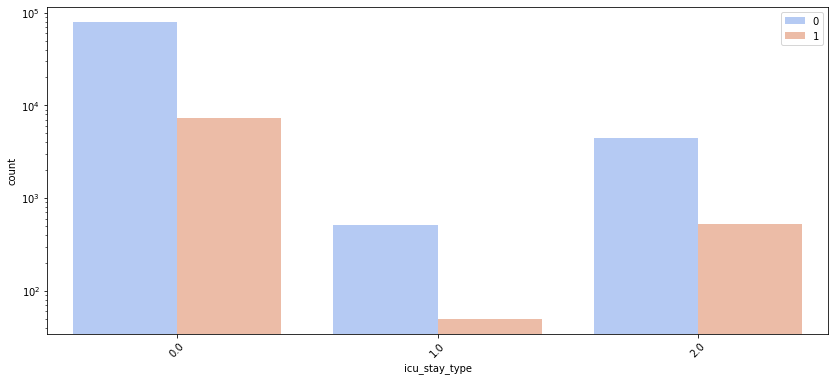

C:\Users\61425\AppData\Local\Temp/ipykernel_7312/616974343.py:29: DeprecationWarning:

`np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



_______________________________________________________________________________
ICU_TYPE

0           CTICU
1    Med-Surg ICU
2    Med-Surg ICU
3           CTICU
4    Med-Surg ICU
Name: icu_type, dtype: object


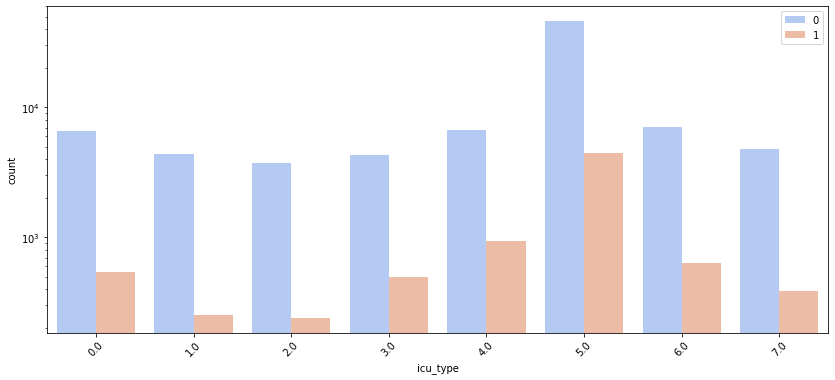

C:\Users\61425\AppData\Local\Temp/ipykernel_7312/616974343.py:29: DeprecationWarning:

`np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



_______________________________________________________________________________
PRE_ICU_LOS_DAYS

0    0.541667
1    0.927778
2    0.000694
3    0.000694
4    0.073611
Name: pre_icu_los_days, dtype: float64


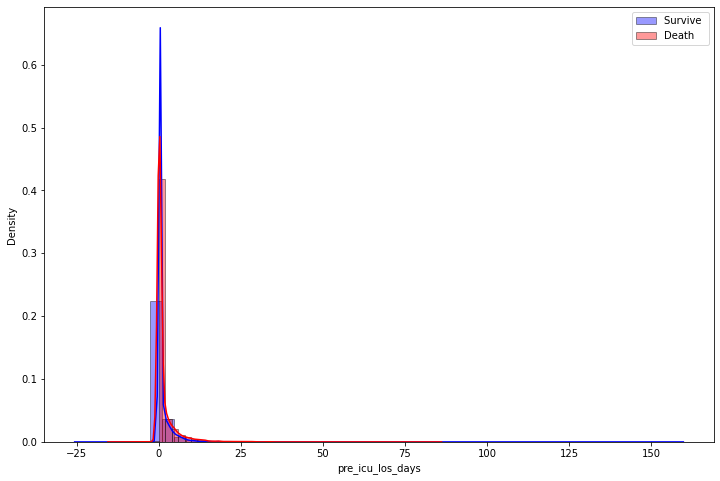

_______________________________________________________________________________
WEIGHT

0    73.9
1    70.2
2    95.3
3    61.7
4     NaN
Name: weight, dtype: float64


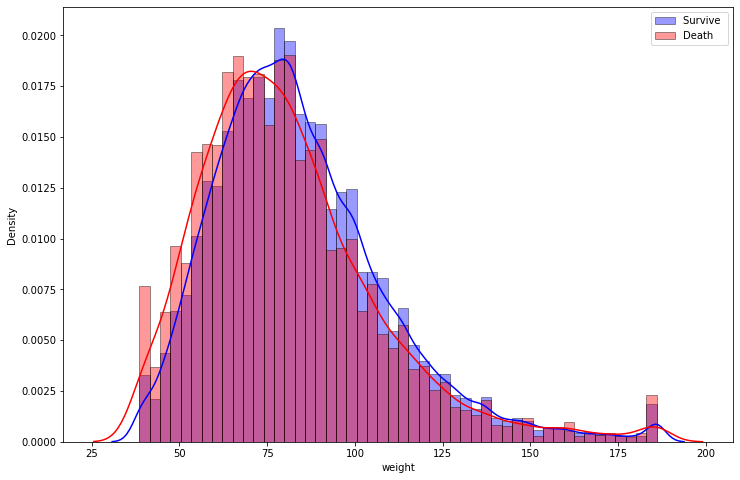

_______________________________________________________________________________
APACHE_2_DIAGNOSIS

0    113.0
1    108.0
2    122.0
3    203.0
4    119.0
Name: apache_2_diagnosis, dtype: float64


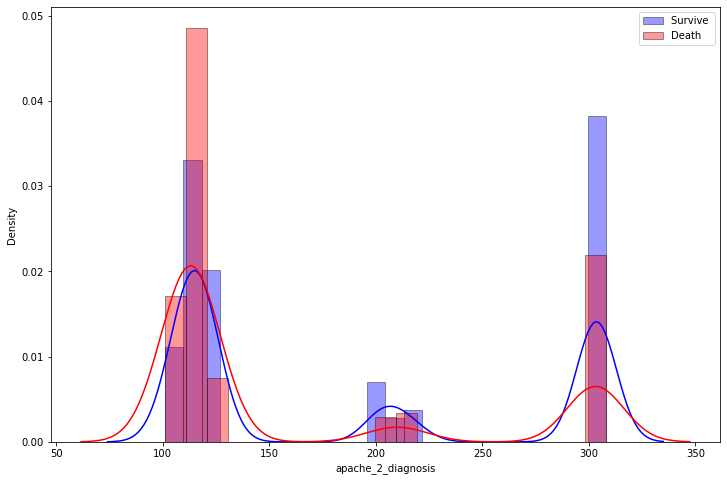

_______________________________________________________________________________
APACHE_3J_DIAGNOSIS

0     502.01
1     203.01
2     703.03
3    1206.03
4     601.01
Name: apache_3j_diagnosis, dtype: float64


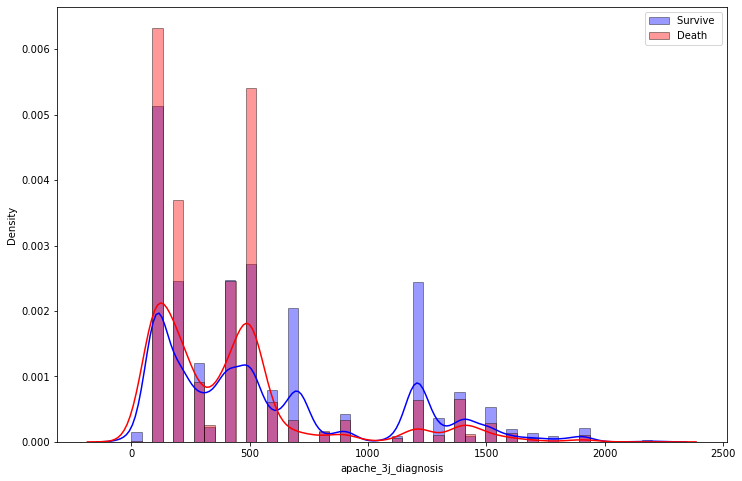

_______________________________________________________________________________
APACHE_POST_OPERATIVE

0    0
1    0
2    0
3    1
4    0
Name: apache_post_operative, dtype: int64


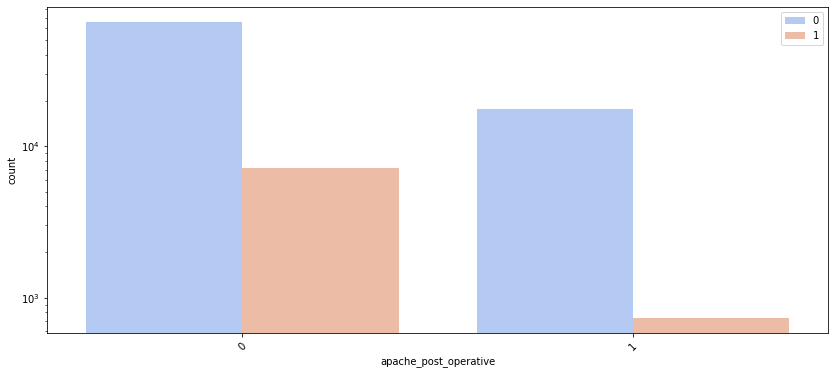

_______________________________________________________________________________
ARF_APACHE

0    0.0
1    0.0
2    0.0
3    0.0
4    0.0
Name: arf_apache, dtype: float64


C:\Users\61425\AppData\Local\Temp/ipykernel_7312/616974343.py:29: DeprecationWarning:

`np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



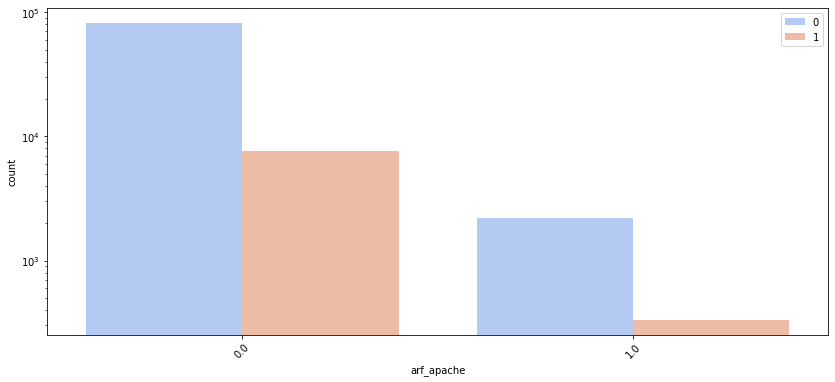

_______________________________________________________________________________
GCS_EYES_APACHE

0    3.0
1    1.0
2    3.0
3    4.0
4    NaN
Name: gcs_eyes_apache, dtype: float64


C:\Users\61425\AppData\Local\Temp/ipykernel_7312/616974343.py:29: DeprecationWarning:

`np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



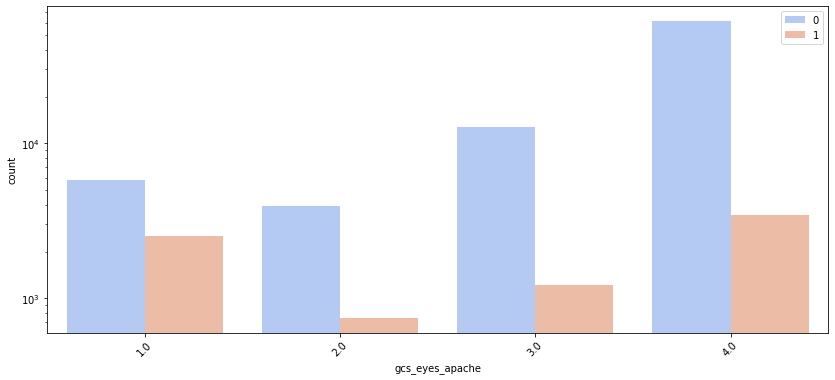

C:\Users\61425\AppData\Local\Temp/ipykernel_7312/616974343.py:29: DeprecationWarning:

`np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



_______________________________________________________________________________
GCS_MOTOR_APACHE

0    6.0
1    3.0
2    6.0
3    6.0
4    NaN
Name: gcs_motor_apache, dtype: float64


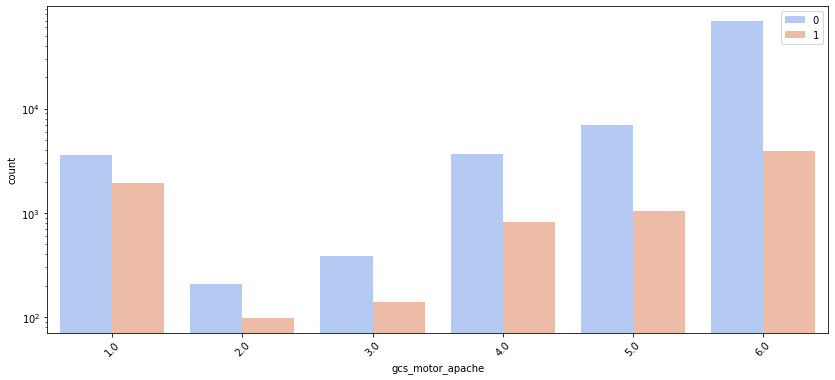

_______________________________________________________________________________
GCS_UNABLE_APACHE

0    0.0
1    0.0
2    0.0
3    0.0
4    NaN
Name: gcs_unable_apache, dtype: float64


C:\Users\61425\AppData\Local\Temp/ipykernel_7312/616974343.py:29: DeprecationWarning:

`np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



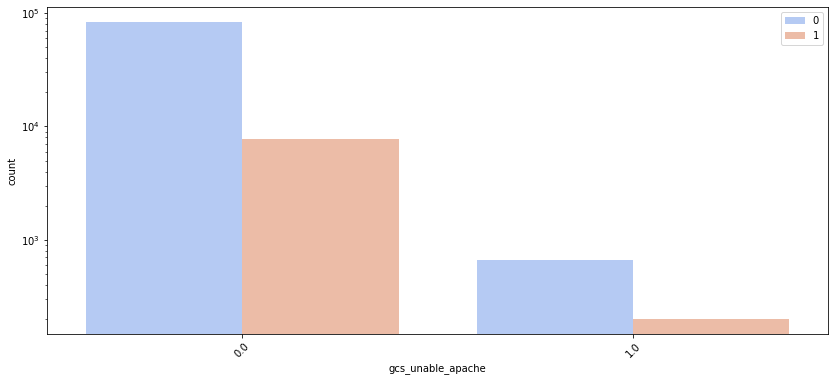

C:\Users\61425\AppData\Local\Temp/ipykernel_7312/616974343.py:29: DeprecationWarning:

`np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



_______________________________________________________________________________
GCS_VERBAL_APACHE

0    4.0
1    1.0
2    5.0
3    5.0
4    NaN
Name: gcs_verbal_apache, dtype: float64


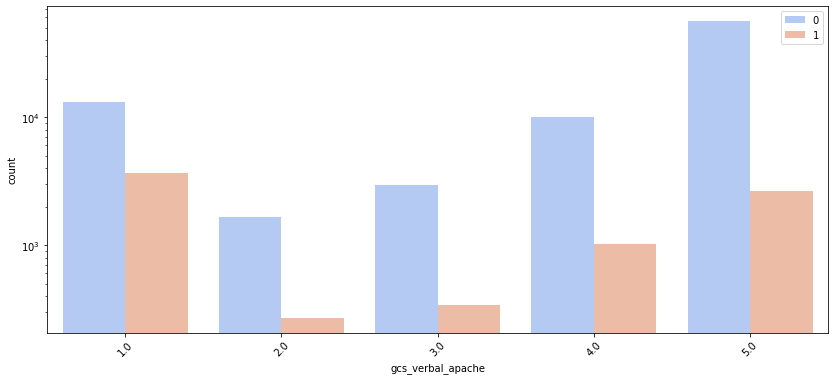

C:\Users\61425\AppData\Local\Temp/ipykernel_7312/616974343.py:29: DeprecationWarning:

`np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



_______________________________________________________________________________
HEART_RATE_APACHE

0    118.0
1    120.0
2    102.0
3    114.0
4     60.0
Name: heart_rate_apache, dtype: float64


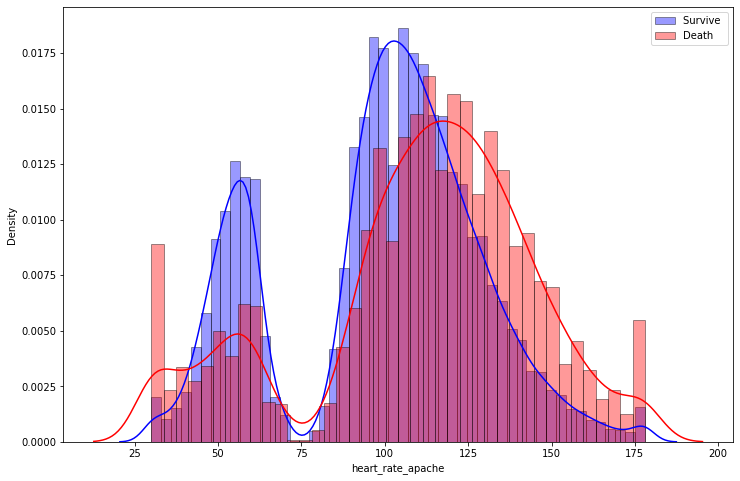

_______________________________________________________________________________
INTUBATED_APACHE

0    0.0
1    0.0
2    0.0
3    1.0
4    0.0
Name: intubated_apache, dtype: float64


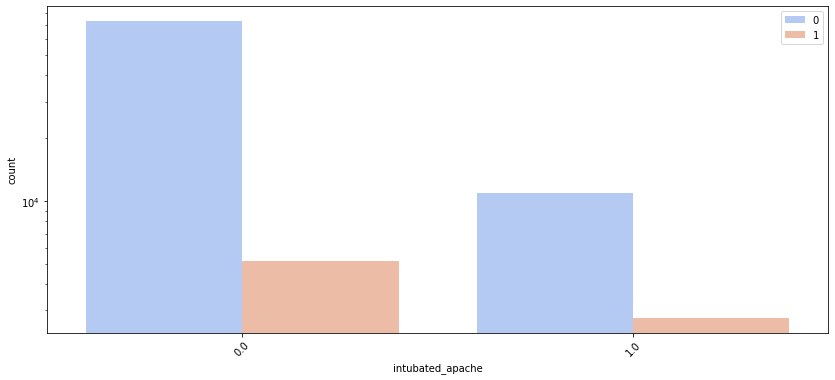

C:\Users\61425\AppData\Local\Temp/ipykernel_7312/616974343.py:29: DeprecationWarning:

`np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



_______________________________________________________________________________
MAP_APACHE

0     40.0
1     46.0
2     68.0
3     60.0
4    103.0
Name: map_apache, dtype: float64


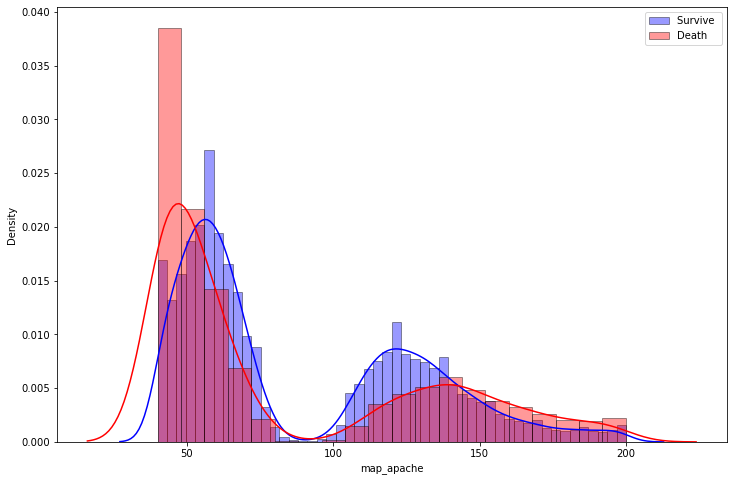

_______________________________________________________________________________
RESPRATE_APACHE

0    36.0
1    33.0
2    37.0
3     4.0
4    16.0
Name: resprate_apache, dtype: float64


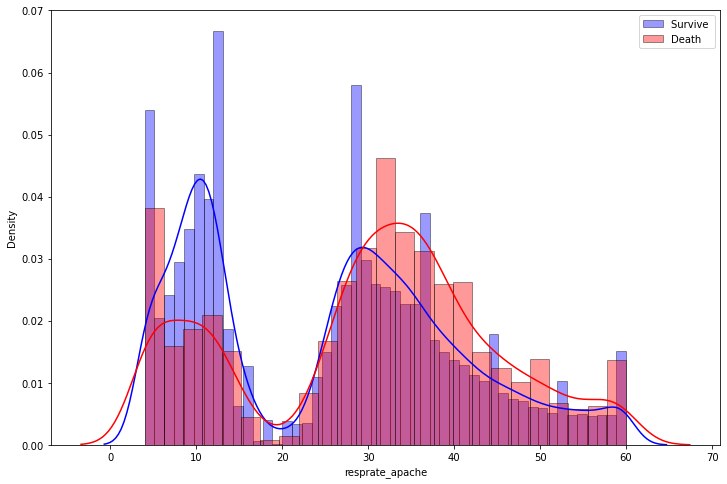

_______________________________________________________________________________
TEMP_APACHE

0    39.3
1    35.1
2    36.7
3    34.8
4    36.7
Name: temp_apache, dtype: float64


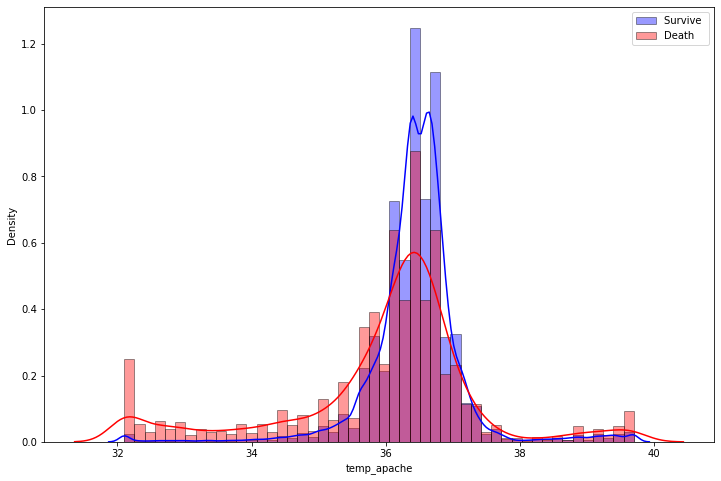

_______________________________________________________________________________
VENTILATED_APACHE

0    0.0
1    1.0
2    0.0
3    1.0
4    0.0
Name: ventilated_apache, dtype: float64


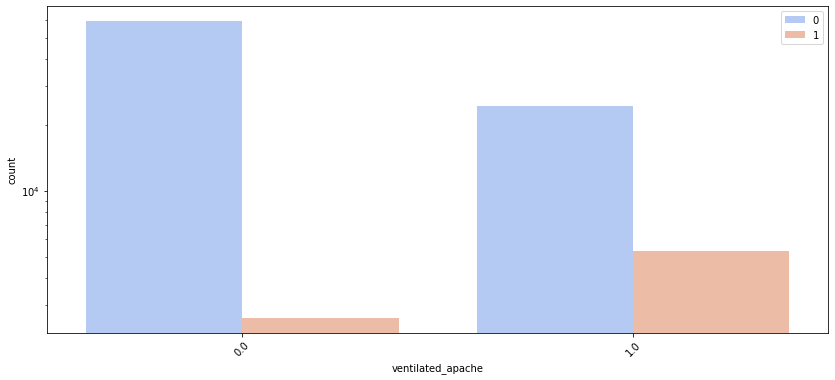

C:\Users\61425\AppData\Local\Temp/ipykernel_7312/616974343.py:29: DeprecationWarning:

`np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



_______________________________________________________________________________
D1_DIASBP_MAX

0    68.0
1    95.0
2    88.0
3    48.0
4    99.0
Name: d1_diasbp_max, dtype: float64


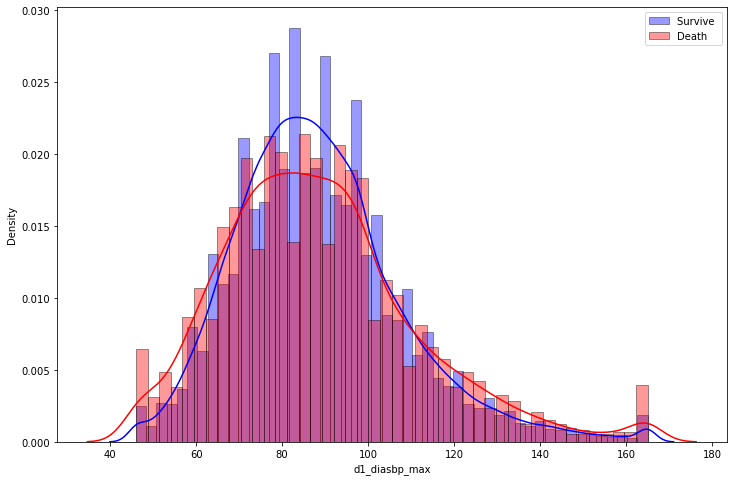

_______________________________________________________________________________
D1_DIASBP_MIN

0    37.0
1    31.0
2    48.0
3    42.0
4    57.0
Name: d1_diasbp_min, dtype: float64


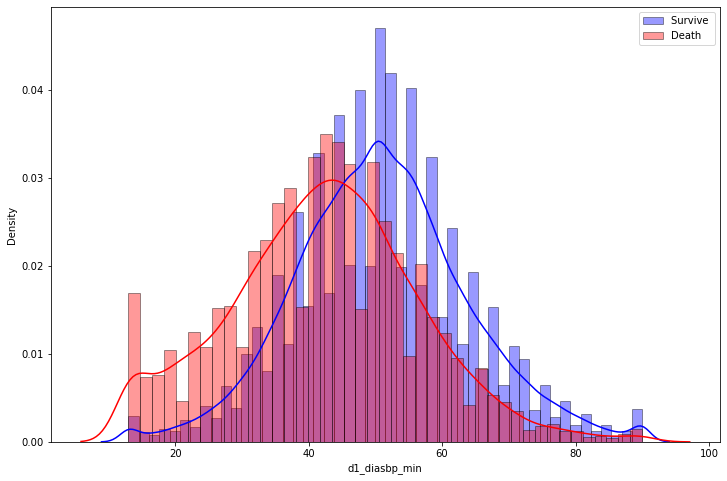

_______________________________________________________________________________
D1_DIASBP_NONINVASIVE_MAX

0    68.0
1    95.0
2    88.0
3    48.0
4    99.0
Name: d1_diasbp_noninvasive_max, dtype: float64


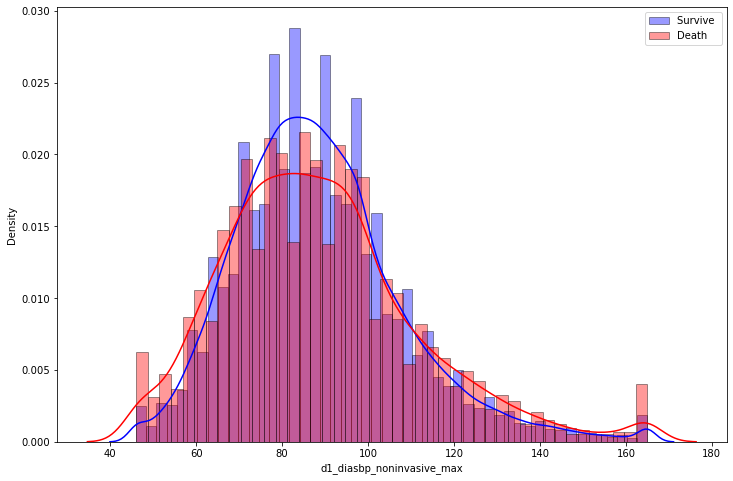

_______________________________________________________________________________
D1_DIASBP_NONINVASIVE_MIN

0    37.0
1    31.0
2    48.0
3    42.0
4    57.0
Name: d1_diasbp_noninvasive_min, dtype: float64


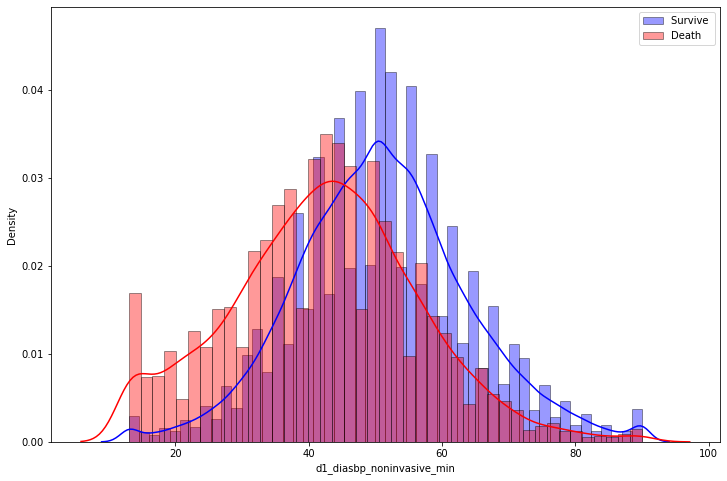

_______________________________________________________________________________
D1_HEARTRATE_MAX

0    119.0
1    118.0
2     96.0
3    116.0
4     89.0
Name: d1_heartrate_max, dtype: float64


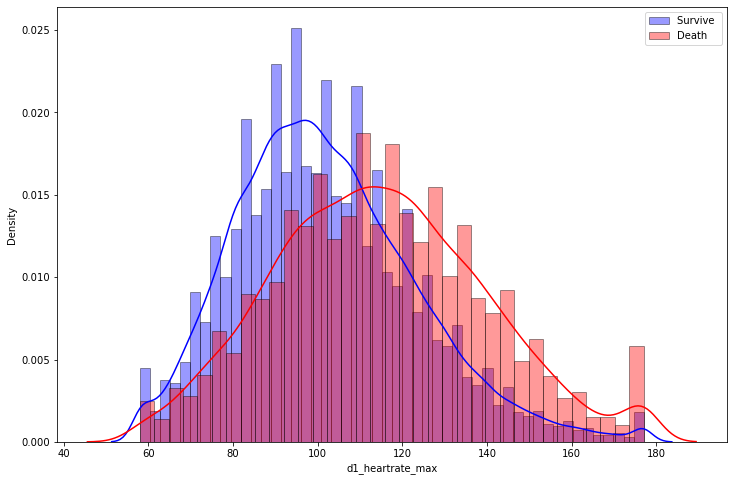

_______________________________________________________________________________
D1_HEARTRATE_MIN

0    72.0
1    72.0
2    68.0
3    92.0
4    60.0
Name: d1_heartrate_min, dtype: float64


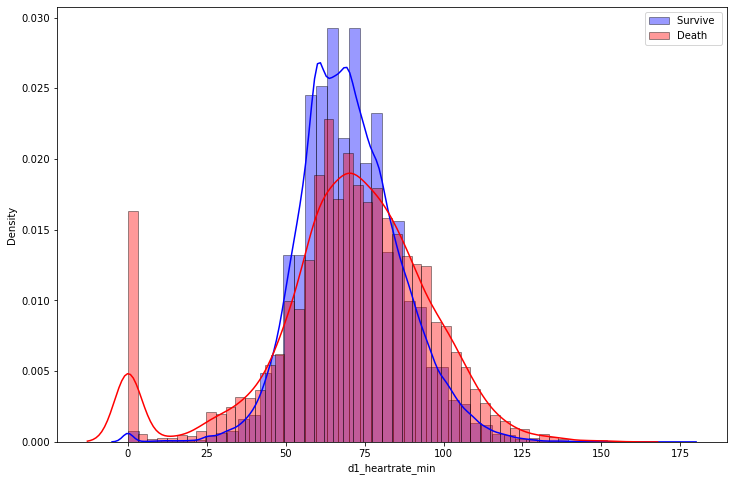

_______________________________________________________________________________
D1_MBP_MAX

0     89.0
1    120.0
2    102.0
3     84.0
4    104.0
Name: d1_mbp_max, dtype: float64


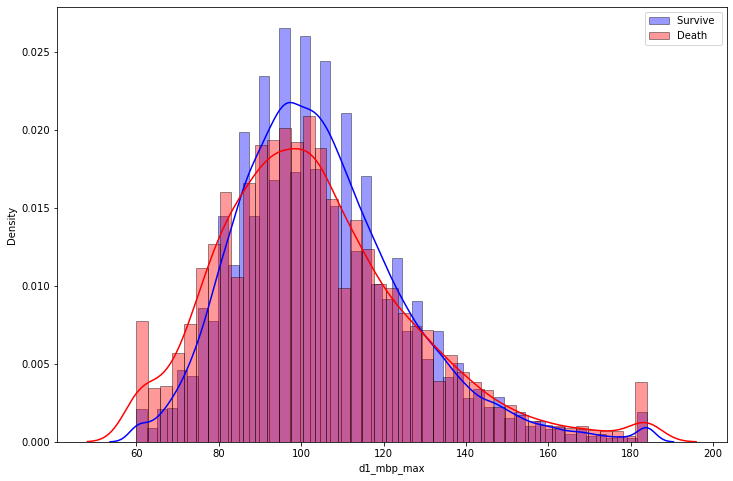

_______________________________________________________________________________
D1_MBP_MIN

0    46.0
1    38.0
2    68.0
3    84.0
4    90.0
Name: d1_mbp_min, dtype: float64


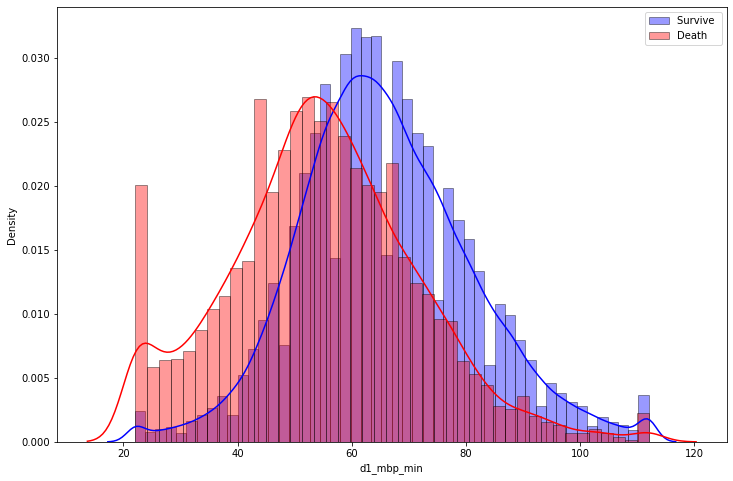

_______________________________________________________________________________
D1_MBP_NONINVASIVE_MAX

0     89.0
1    120.0
2    102.0
3     84.0
4    104.0
Name: d1_mbp_noninvasive_max, dtype: float64


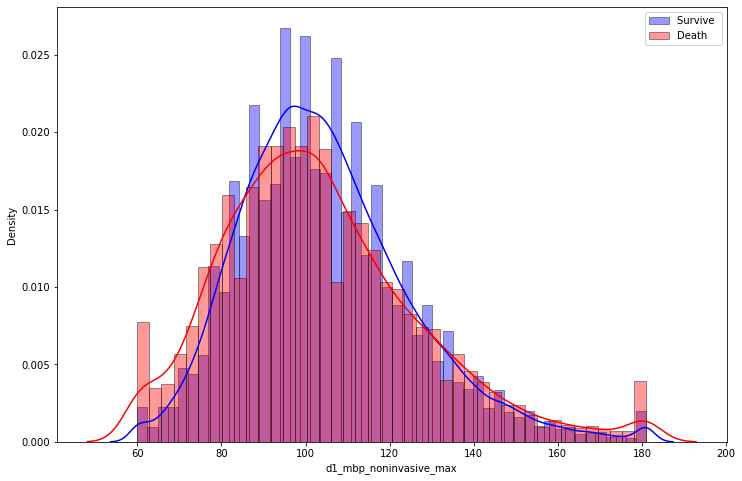

_______________________________________________________________________________
D1_MBP_NONINVASIVE_MIN

0    46.0
1    38.0
2    68.0
3    84.0
4    90.0
Name: d1_mbp_noninvasive_min, dtype: float64


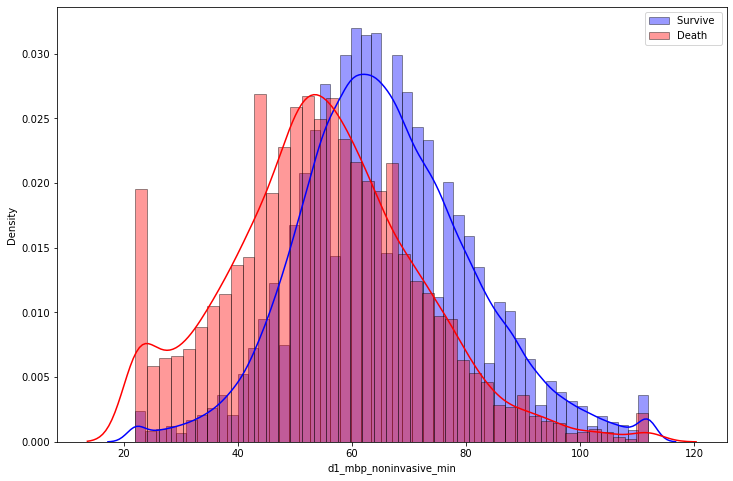

_______________________________________________________________________________
D1_RESPRATE_MAX

0    34.0
1    32.0
2    21.0
3    23.0
4    18.0
Name: d1_resprate_max, dtype: float64


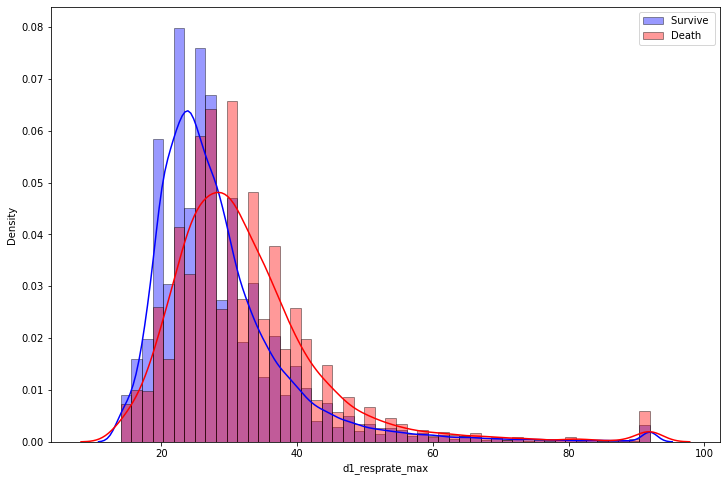

_______________________________________________________________________________
D1_RESPRATE_MIN

0    10.0
1    12.0
2     8.0
3     7.0
4    16.0
Name: d1_resprate_min, dtype: float64


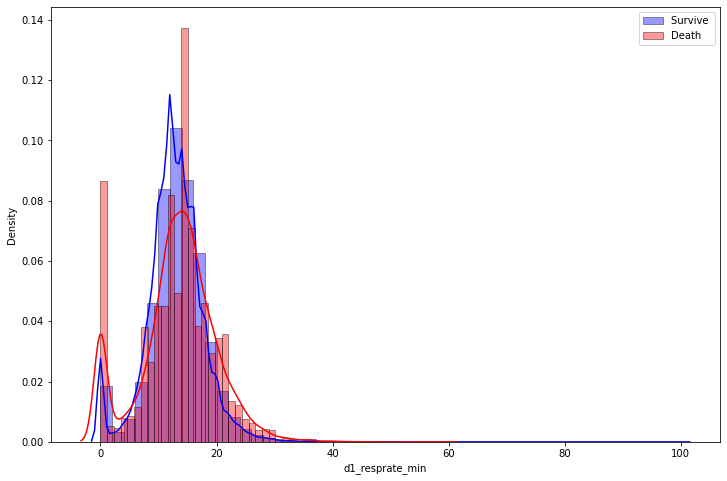

_______________________________________________________________________________
D1_SPO2_MAX

0    100.0
1    100.0
2     98.0
3    100.0
4    100.0
Name: d1_spo2_max, dtype: float64


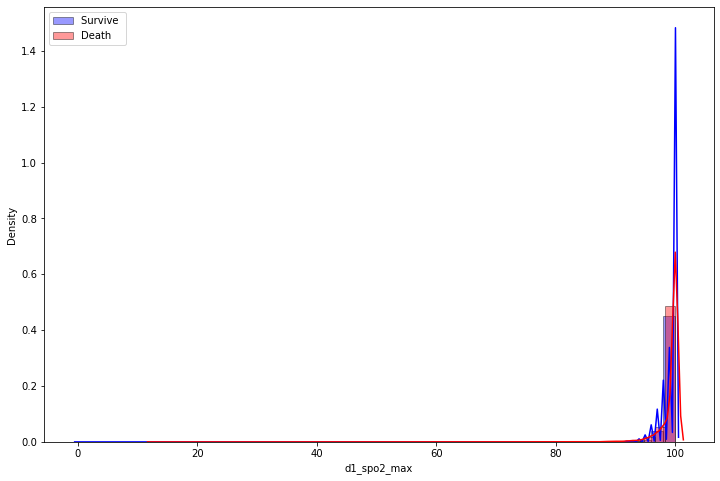

_______________________________________________________________________________
D1_SPO2_MIN

0    74.0
1    70.0
2    91.0
3    95.0
4    96.0
Name: d1_spo2_min, dtype: float64


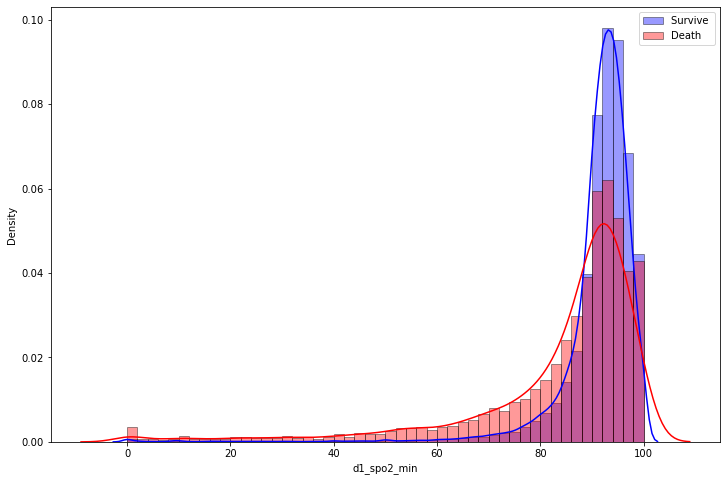

_______________________________________________________________________________
D1_SYSBP_MAX

0    131.0
1    159.0
2    148.0
3    158.0
4    147.0
Name: d1_sysbp_max, dtype: float64


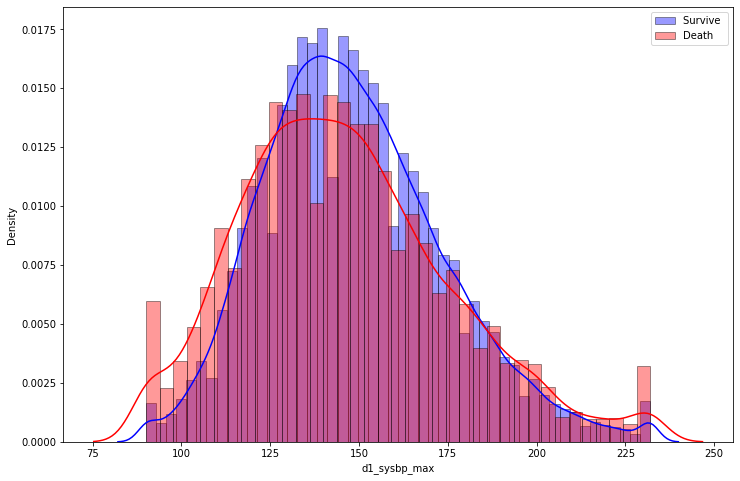

_______________________________________________________________________________
D1_SYSBP_MIN

0     73.0
1     67.0
2    105.0
3     84.0
4    120.0
Name: d1_sysbp_min, dtype: float64


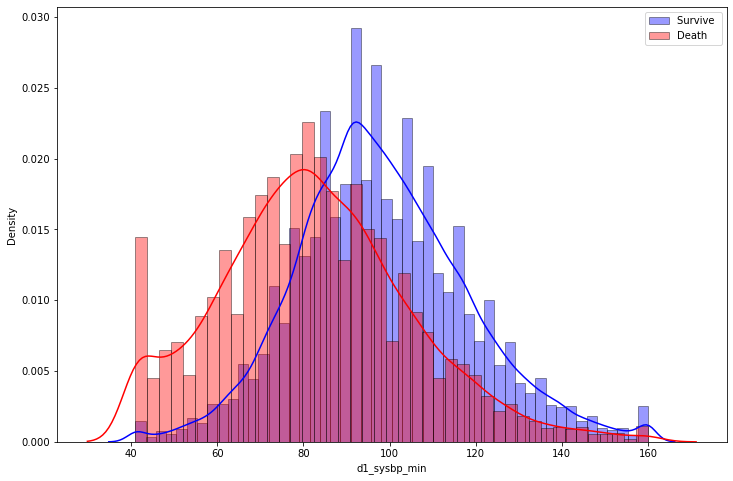

_______________________________________________________________________________
D1_SYSBP_NONINVASIVE_MAX

0    131.0
1    159.0
2    148.0
3    158.0
4    147.0
Name: d1_sysbp_noninvasive_max, dtype: float64


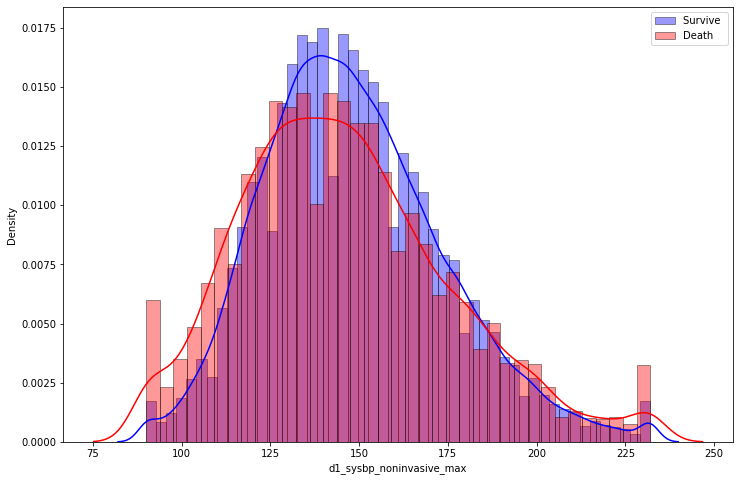

_______________________________________________________________________________
D1_SYSBP_NONINVASIVE_MIN

0     73.0
1     67.0
2    105.0
3     84.0
4    120.0
Name: d1_sysbp_noninvasive_min, dtype: float64


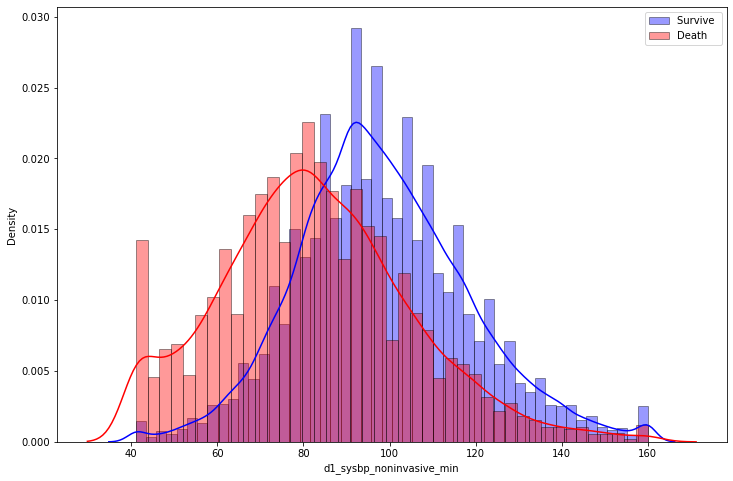

_______________________________________________________________________________
D1_TEMP_MAX

0    39.9
1    36.3
2    37.0
3    38.0
4    37.2
Name: d1_temp_max, dtype: float64


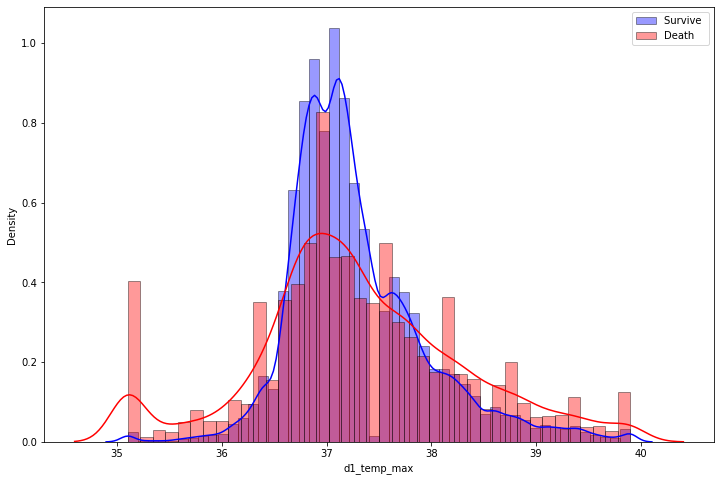

_______________________________________________________________________________
D1_TEMP_MIN

0    37.2
1    35.1
2    36.7
3    34.8
4    36.7
Name: d1_temp_min, dtype: float64


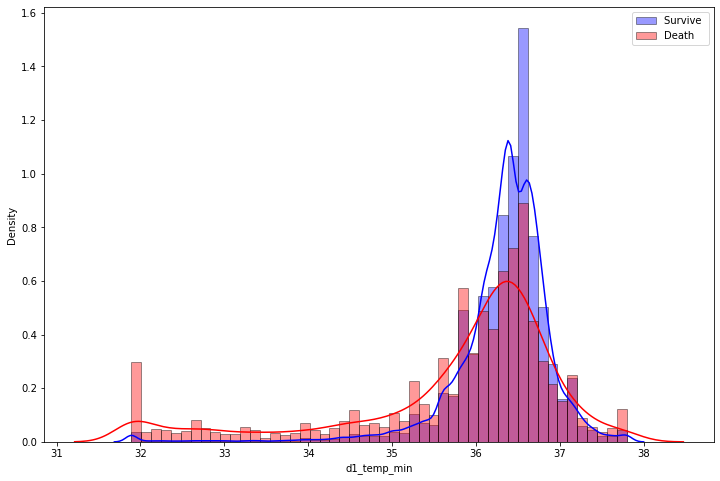

_______________________________________________________________________________
H1_DIASBP_MAX

0    68.0
1    61.0
2    88.0
3    62.0
4    99.0
Name: h1_diasbp_max, dtype: float64


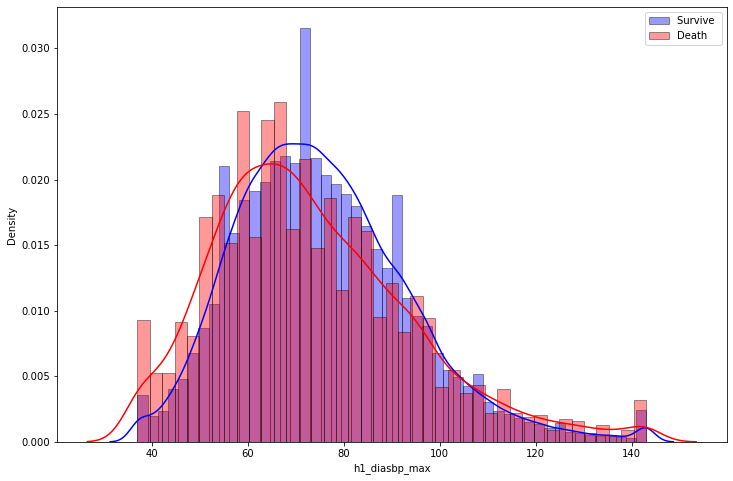

_______________________________________________________________________________
H1_DIASBP_MIN

0    63.0
1    48.0
2    58.0
3    44.0
4    68.0
Name: h1_diasbp_min, dtype: float64


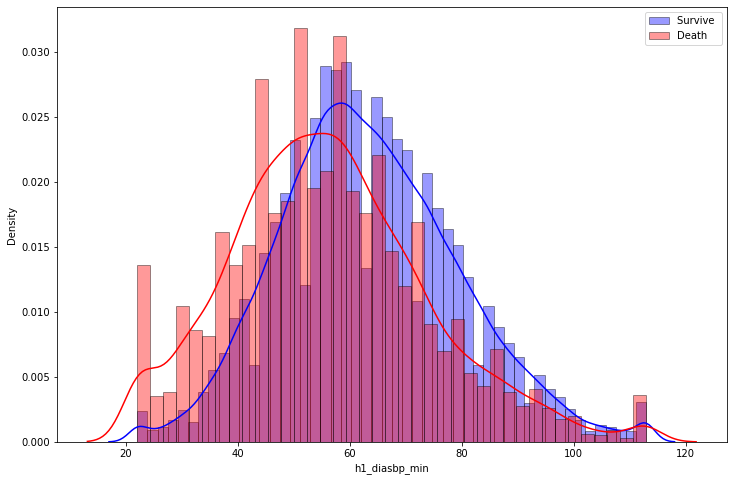

_______________________________________________________________________________
H1_DIASBP_NONINVASIVE_MAX

0    68.0
1    61.0
2    88.0
3     NaN
4    99.0
Name: h1_diasbp_noninvasive_max, dtype: float64


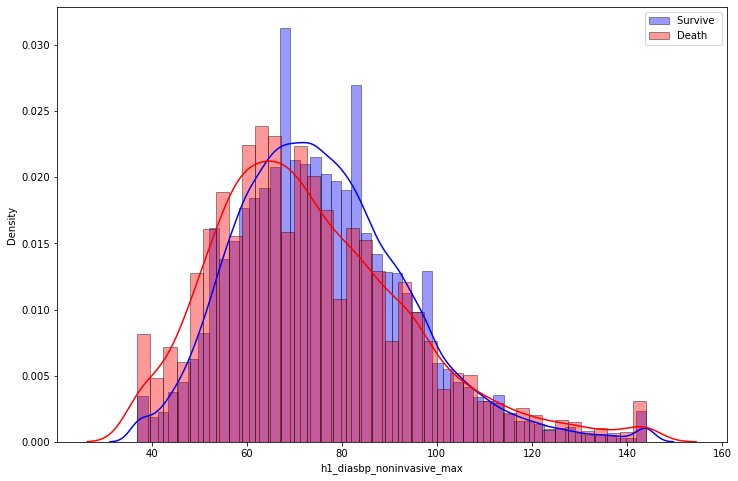

_______________________________________________________________________________
H1_DIASBP_NONINVASIVE_MIN

0    63.0
1    48.0
2    58.0
3     NaN
4    68.0
Name: h1_diasbp_noninvasive_min, dtype: float64


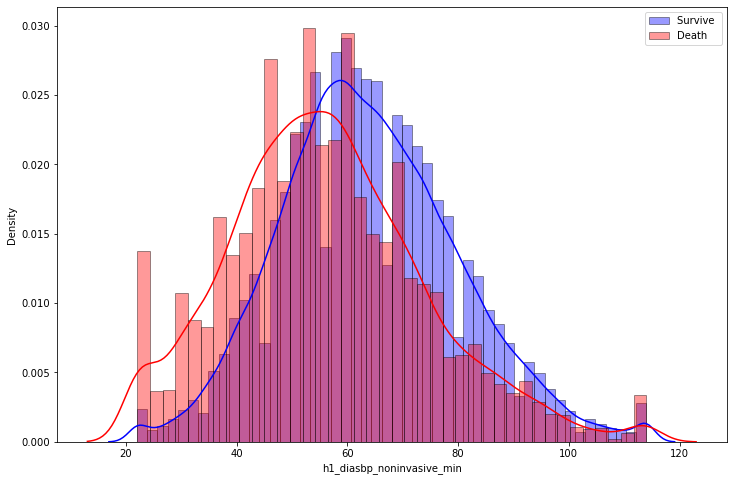

_______________________________________________________________________________
H1_HEARTRATE_MAX

0    119.0
1    114.0
2     96.0
3    100.0
4     89.0
Name: h1_heartrate_max, dtype: float64


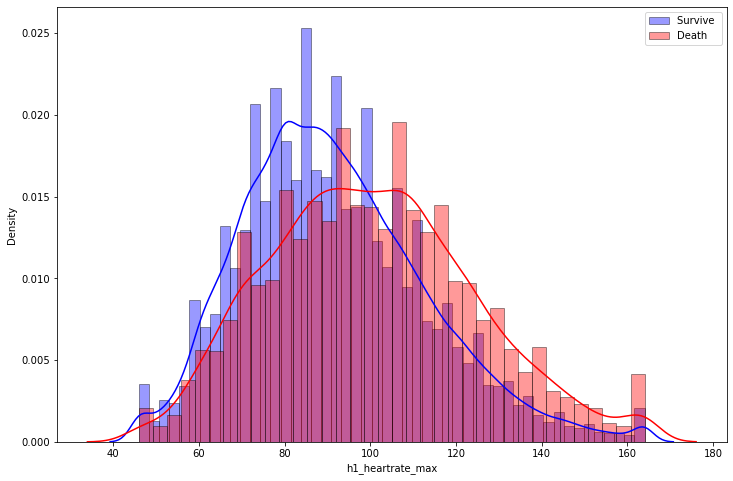

_______________________________________________________________________________
H1_HEARTRATE_MIN

0    108.0
1    100.0
2     78.0
3     96.0
4     76.0
Name: h1_heartrate_min, dtype: float64


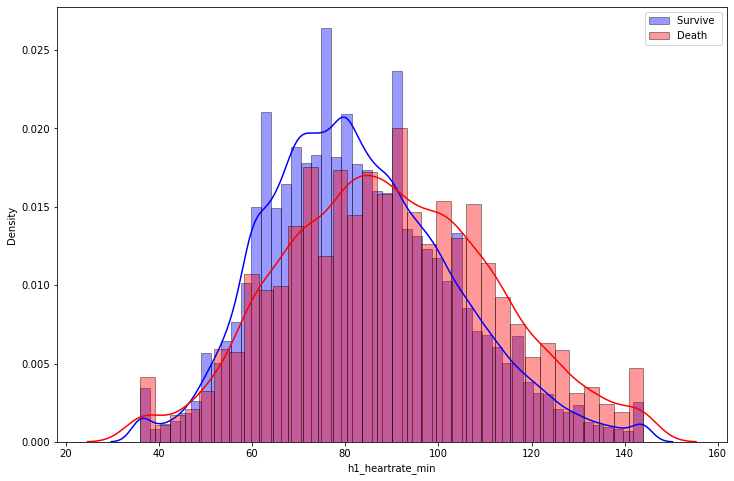

_______________________________________________________________________________
H1_MBP_MAX

0     86.0
1     85.0
2     91.0
3     92.0
4    104.0
Name: h1_mbp_max, dtype: float64


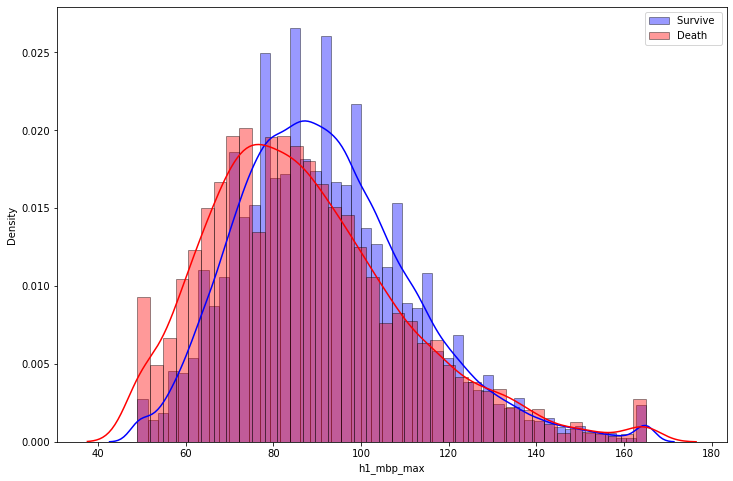

_______________________________________________________________________________
H1_MBP_MIN

0    85.0
1    57.0
2    83.0
3    71.0
4    92.0
Name: h1_mbp_min, dtype: float64


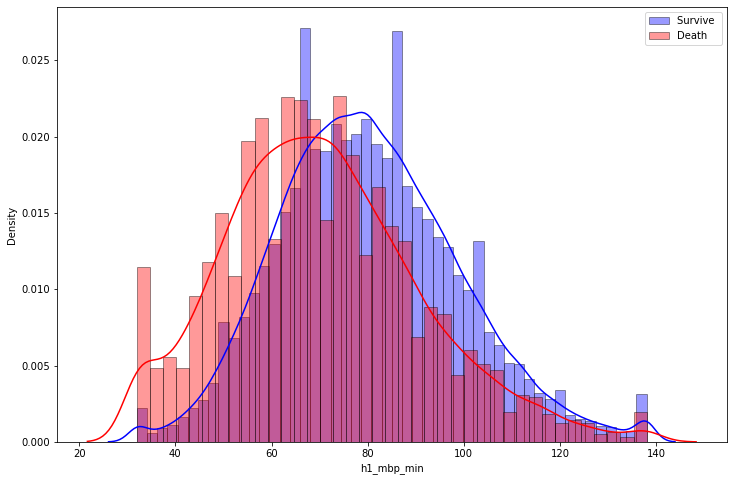

_______________________________________________________________________________
H1_MBP_NONINVASIVE_MAX

0     86.0
1     85.0
2     91.0
3      NaN
4    104.0
Name: h1_mbp_noninvasive_max, dtype: float64


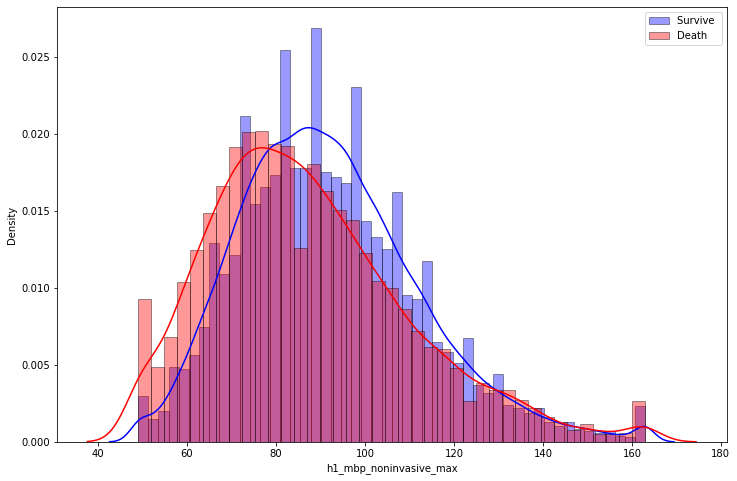

_______________________________________________________________________________
H1_MBP_NONINVASIVE_MIN

0    85.0
1    57.0
2    83.0
3     NaN
4    92.0
Name: h1_mbp_noninvasive_min, dtype: float64


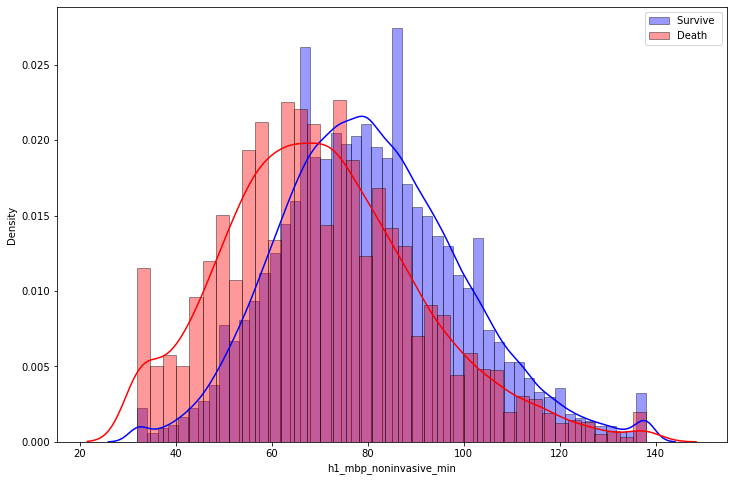

_______________________________________________________________________________
H1_RESPRATE_MAX

0    26.0
1    31.0
2    20.0
3    12.0
4     NaN
Name: h1_resprate_max, dtype: float64


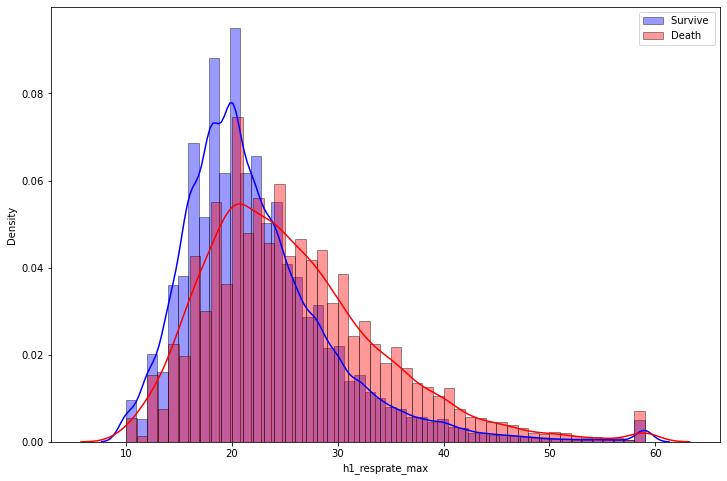

_______________________________________________________________________________
H1_RESPRATE_MIN

0    18.0
1    28.0
2    16.0
3    11.0
4     NaN
Name: h1_resprate_min, dtype: float64


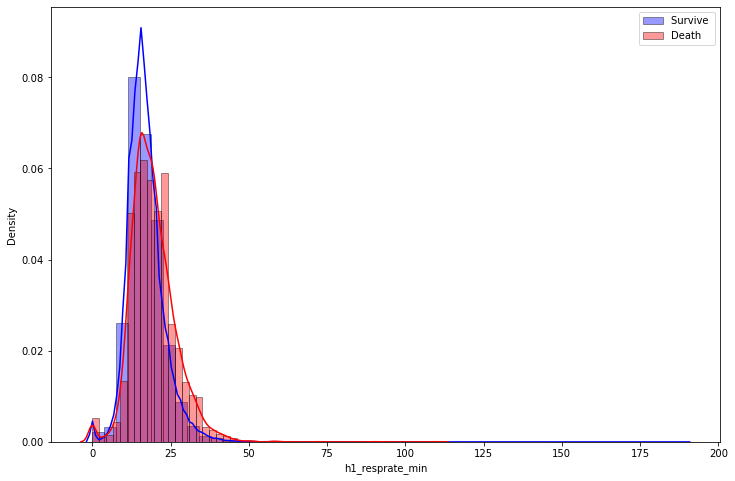

_______________________________________________________________________________
H1_SPO2_MAX

0    100.0
1     95.0
2     98.0
3    100.0
4    100.0
Name: h1_spo2_max, dtype: float64


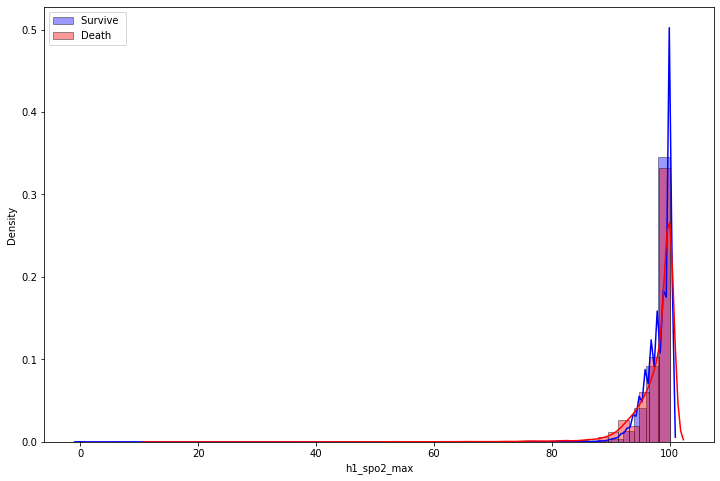

_______________________________________________________________________________
H1_SPO2_MIN

0     74.0
1     70.0
2     91.0
3     99.0
4    100.0
Name: h1_spo2_min, dtype: float64


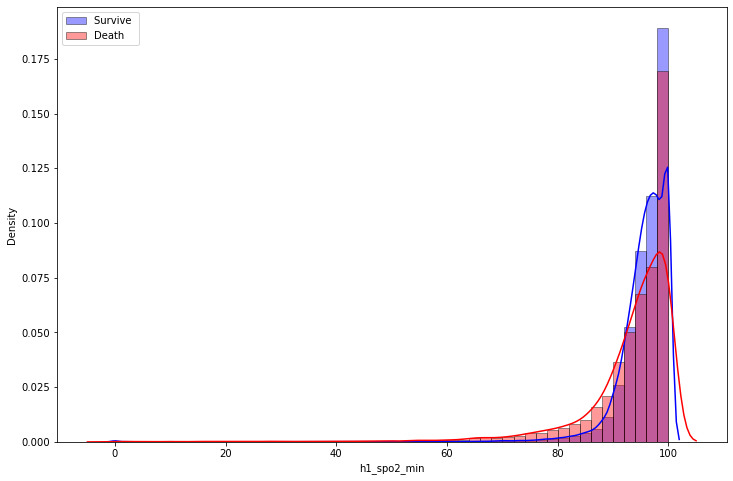

_______________________________________________________________________________
H1_SYSBP_MAX

0    131.0
1     95.0
2    148.0
3    136.0
4    130.0
Name: h1_sysbp_max, dtype: float64


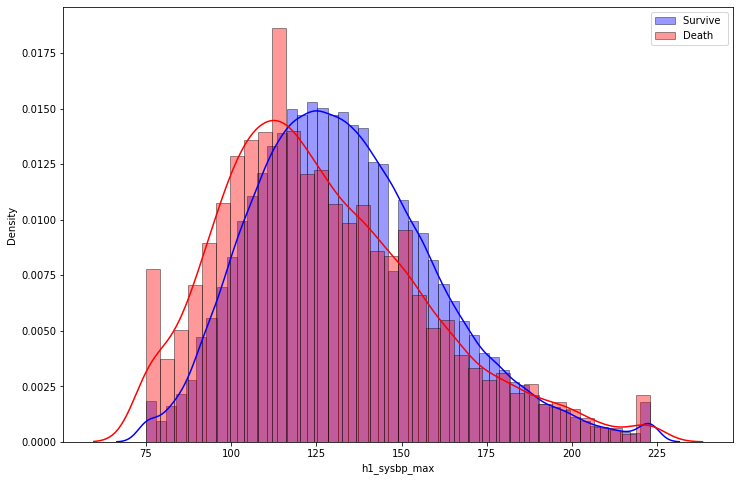

_______________________________________________________________________________
H1_SYSBP_MIN

0    115.0
1     71.0
2    124.0
3    106.0
4    120.0
Name: h1_sysbp_min, dtype: float64


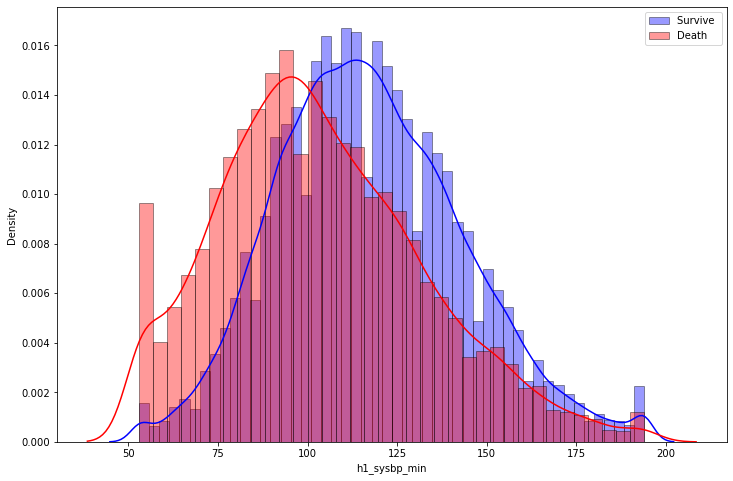

_______________________________________________________________________________
H1_SYSBP_NONINVASIVE_MAX

0    131.0
1     95.0
2    148.0
3      NaN
4    130.0
Name: h1_sysbp_noninvasive_max, dtype: float64


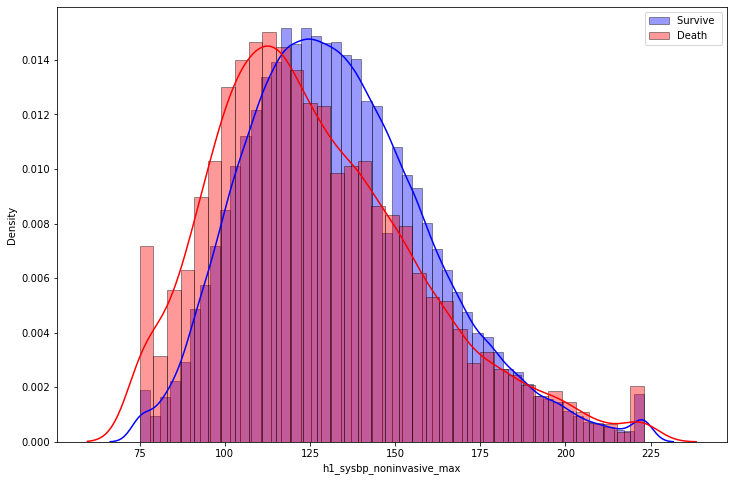

_______________________________________________________________________________
H1_SYSBP_NONINVASIVE_MIN

0    115.0
1     71.0
2    124.0
3      NaN
4    120.0
Name: h1_sysbp_noninvasive_min, dtype: float64


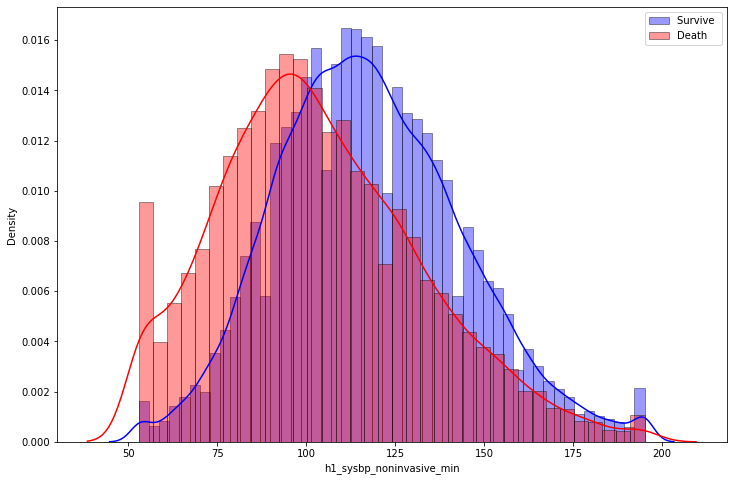

_______________________________________________________________________________
D1_GLUCOSE_MAX

0    168.0
1    145.0
2      NaN
3    185.0
4      NaN
Name: d1_glucose_max, dtype: float64


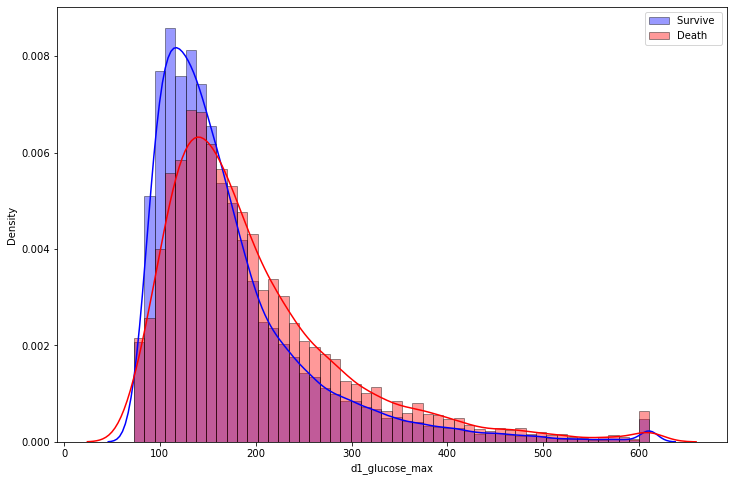

_______________________________________________________________________________
D1_GLUCOSE_MIN

0    109.0
1    128.0
2      NaN
3     88.0
4      NaN
Name: d1_glucose_min, dtype: float64


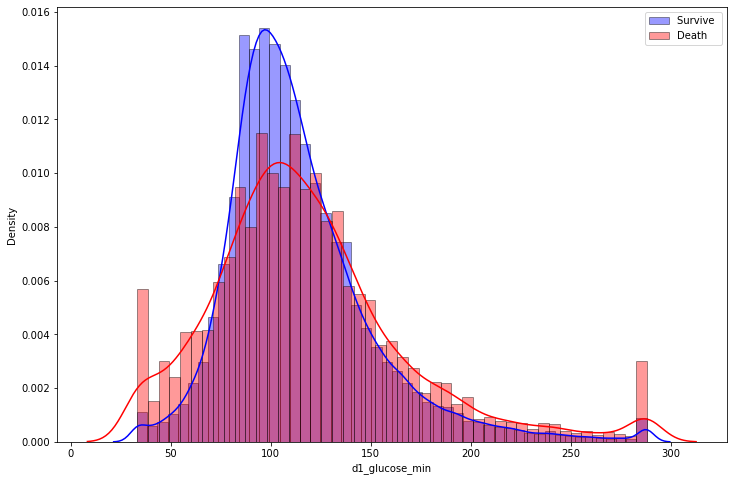

_______________________________________________________________________________
D1_POTASSIUM_MAX

0    4.0
1    4.2
2    NaN
3    5.0
4    NaN
Name: d1_potassium_max, dtype: float64


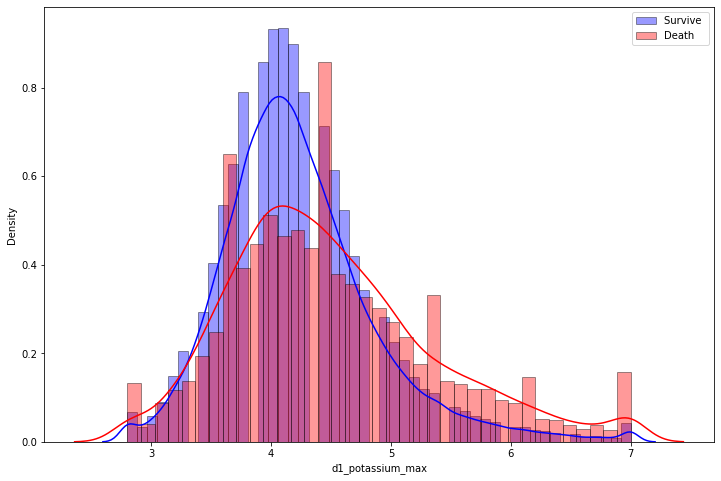

_______________________________________________________________________________
D1_POTASSIUM_MIN

0    3.4
1    3.8
2    NaN
3    3.5
4    NaN
Name: d1_potassium_min, dtype: float64


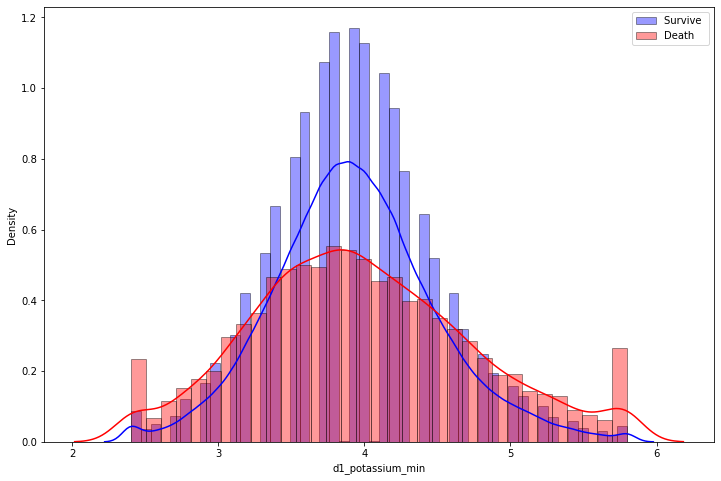

_______________________________________________________________________________
APACHE_4A_HOSPITAL_DEATH_PROB

0    0.10
1    0.47
2    0.00
3    0.04
4     NaN
Name: apache_4a_hospital_death_prob, dtype: float64


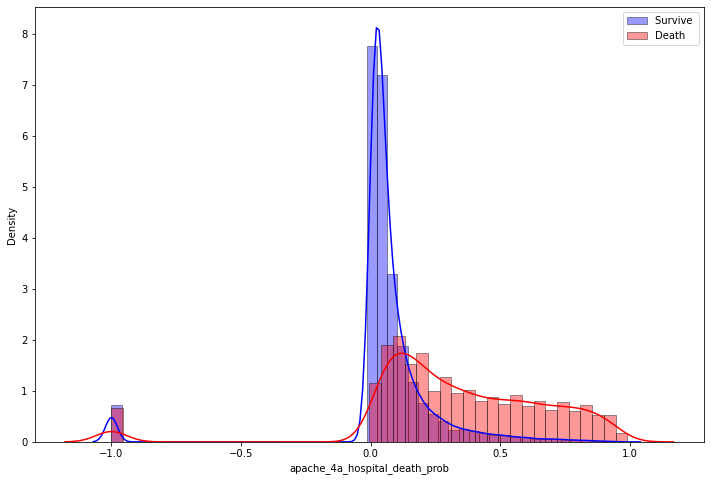

_______________________________________________________________________________
APACHE_4A_ICU_DEATH_PROB

0    0.05
1    0.29
2    0.00
3    0.03
4     NaN
Name: apache_4a_icu_death_prob, dtype: float64


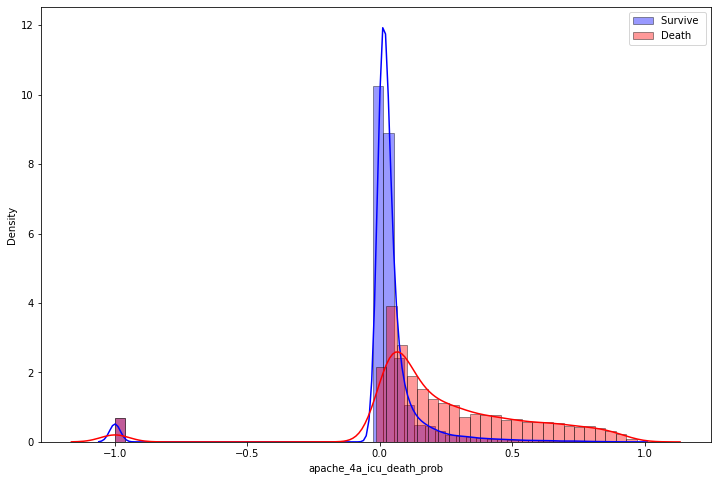

_______________________________________________________________________________
AIDS

0    0.0
1    0.0
2    0.0
3    0.0
4    0.0
Name: aids, dtype: float64


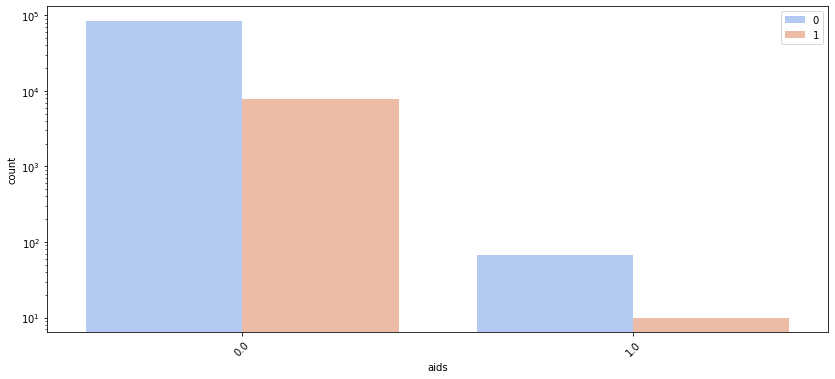

_______________________________________________________________________________
CIRRHOSIS

0    0.0
1    0.0
2    0.0
3    0.0
4    0.0
Name: cirrhosis, dtype: float64


C:\Users\61425\AppData\Local\Temp/ipykernel_7312/616974343.py:29: DeprecationWarning:

`np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



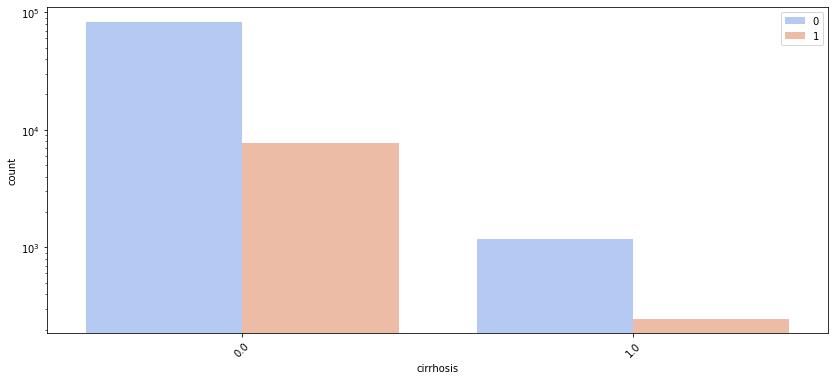

C:\Users\61425\AppData\Local\Temp/ipykernel_7312/616974343.py:29: DeprecationWarning:

`np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



_______________________________________________________________________________
DIABETES_MELLITUS

0    1.0
1    1.0
2    0.0
3    0.0
4    0.0
Name: diabetes_mellitus, dtype: float64


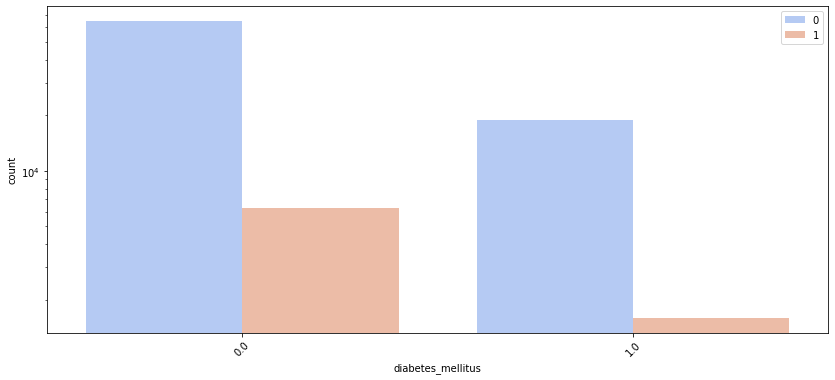

_______________________________________________________________________________
HEPATIC_FAILURE

0    0.0
1    0.0
2    0.0
3    0.0
4    0.0
Name: hepatic_failure, dtype: float64


C:\Users\61425\AppData\Local\Temp/ipykernel_7312/616974343.py:29: DeprecationWarning:

`np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



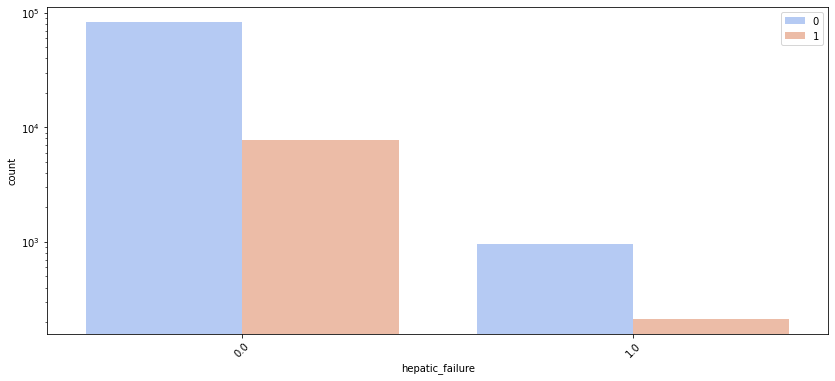

_______________________________________________________________________________
IMMUNOSUPPRESSION

0    0.0
1    0.0
2    0.0
3    0.0
4    0.0
Name: immunosuppression, dtype: float64


C:\Users\61425\AppData\Local\Temp/ipykernel_7312/616974343.py:29: DeprecationWarning:

`np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



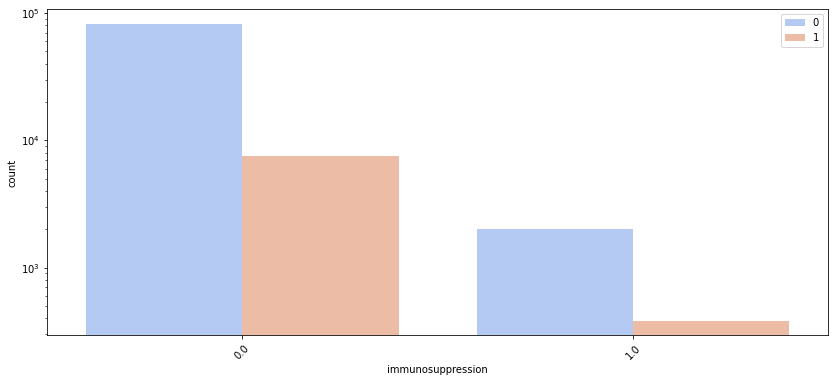

_______________________________________________________________________________
LEUKEMIA

0    0.0
1    0.0
2    0.0
3    0.0
4    0.0
Name: leukemia, dtype: float64


C:\Users\61425\AppData\Local\Temp/ipykernel_7312/616974343.py:29: DeprecationWarning:

`np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



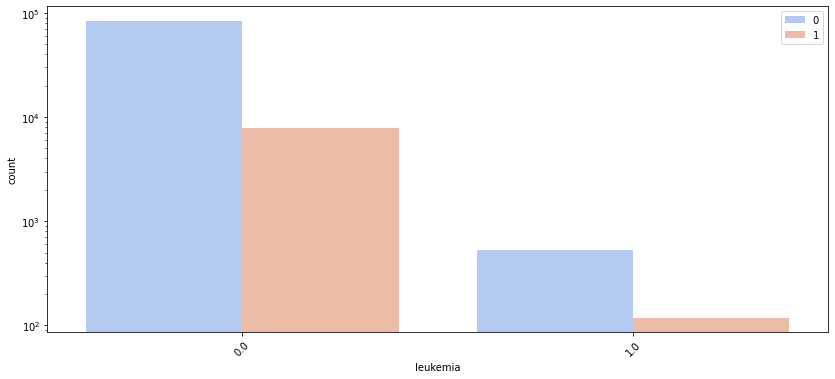

_______________________________________________________________________________
LYMPHOMA

0    0.0
1    0.0
2    0.0
3    0.0
4    0.0
Name: lymphoma, dtype: float64


C:\Users\61425\AppData\Local\Temp/ipykernel_7312/616974343.py:29: DeprecationWarning:

`np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



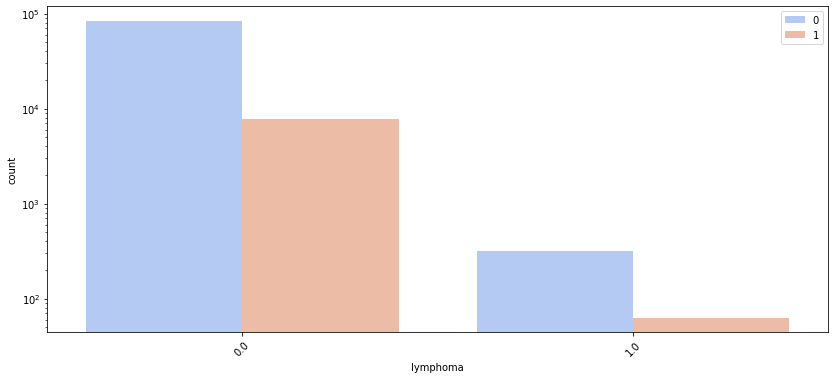

_______________________________________________________________________________
SOLID_TUMOR_WITH_METASTASIS

0    0.0
1    0.0
2    0.0
3    0.0
4    0.0
Name: solid_tumor_with_metastasis, dtype: float64


C:\Users\61425\AppData\Local\Temp/ipykernel_7312/616974343.py:29: DeprecationWarning:

`np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



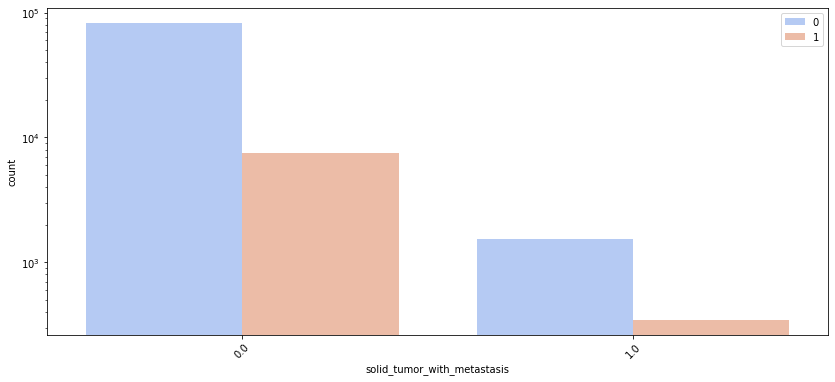

C:\Users\61425\AppData\Local\Temp/ipykernel_7312/616974343.py:29: DeprecationWarning:

`np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



_______________________________________________________________________________
APACHE_3J_BODYSYSTEM

0            Sepsis
1       Respiratory
2         Metabolic
3    Cardiovascular
4            Trauma
Name: apache_3j_bodysystem, dtype: object


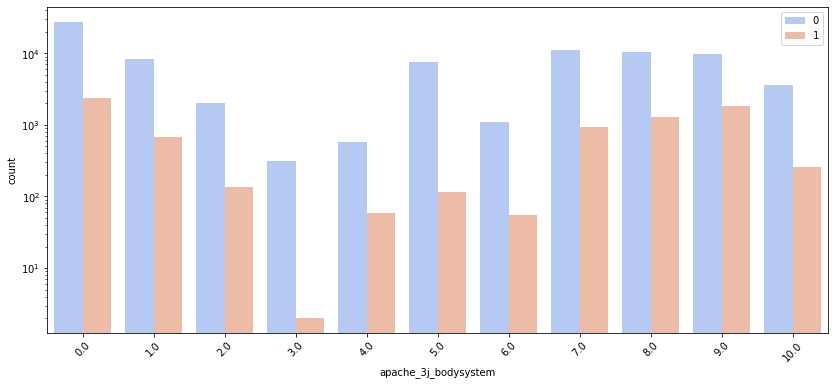

C:\Users\61425\AppData\Local\Temp/ipykernel_7312/616974343.py:29: DeprecationWarning:

`np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



_______________________________________________________________________________
APACHE_2_BODYSYSTEM

0    Cardiovascular
1       Respiratory
2         Metabolic
3    Cardiovascular
4            Trauma
Name: apache_2_bodysystem, dtype: object


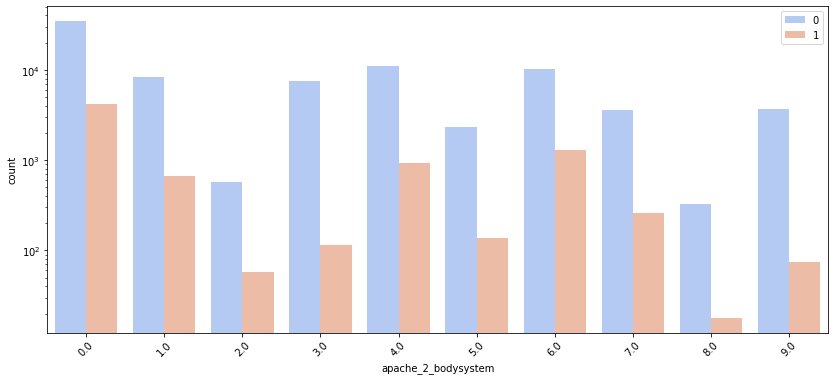

_______________________________________________________________________________
HOSPITAL_DEATH

0    0
1    0
2    0
3    0
4    0
Name: hospital_death, dtype: int64


C:\Users\61425\AppData\Local\Temp/ipykernel_7312/616974343.py:29: DeprecationWarning:

`np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



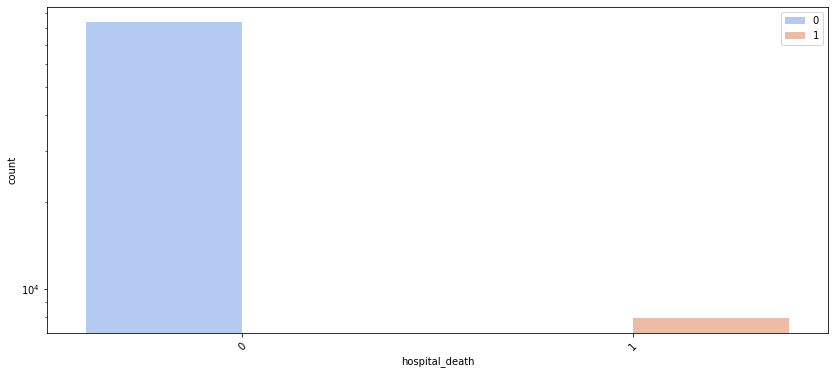

_______________________________________________________________________________


C:\Users\61425\AppData\Local\Temp/ipykernel_7312/616974343.py:29: DeprecationWarning:

`np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



In [167]:
categorical=[]
NUM=[]

for i in dataG.columns[3::]:
    print(i.upper())
    print('')
    print(dataG[i].head(5))
    


    if dataG[i].value_counts().shape[0]>20:
    
        plt.figure(figsize=(12,8))
        sns.distplot(dataG[i][dataG['hospital_death']==0],color='b', label='Survive ',hist_kws={'edgecolor':'black'})
        _=sns.distplot(dataG[i][dataG['hospital_death']==1],color='r',label='Death',hist_kws={'edgecolor':'black'})
        plt.legend()
        plt.show()        
        NUM.append(i)       
        
        
    else:
        plt.figure(figsize=(14, 6))
        sns.countplot(x=i, hue="hospital_death", data=data, palette='coolwarm')
        plt.legend(loc='upper right')
        plt.yscale('log')
        plt.xticks(rotation=45)
        plt.show()
        
        if dataG[i].dtype != np.object:
            NUM.append(i)  
        else:
            categorical.append(i)     
    
    print('_______________________________________________________________________________')

## Apache scores 

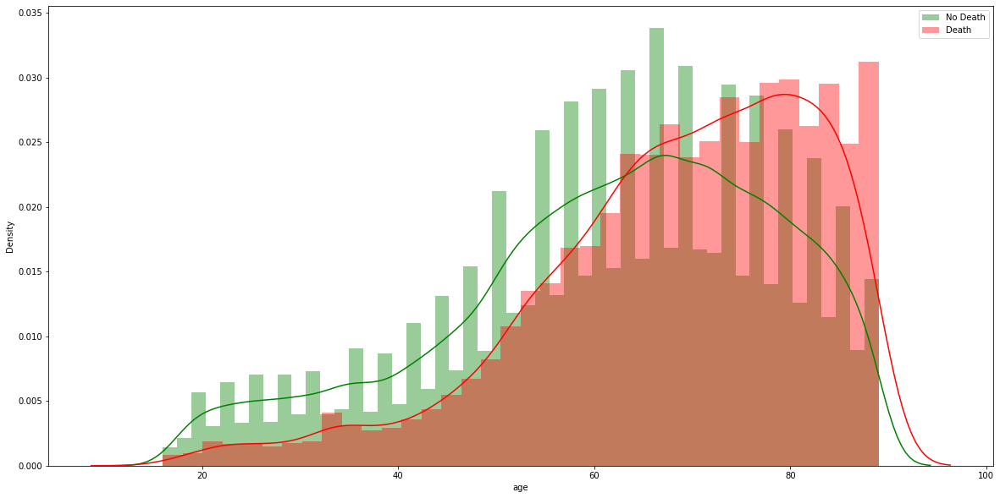

In [46]:
plt.figure(figsize=(20, 10))
sns.distplot(dataG.age[data.hospital_death == 0], color="g", label="No Death")
sns.distplot(dataG.age[data.hospital_death == 1], color="r", label="Death")
plt.legend()

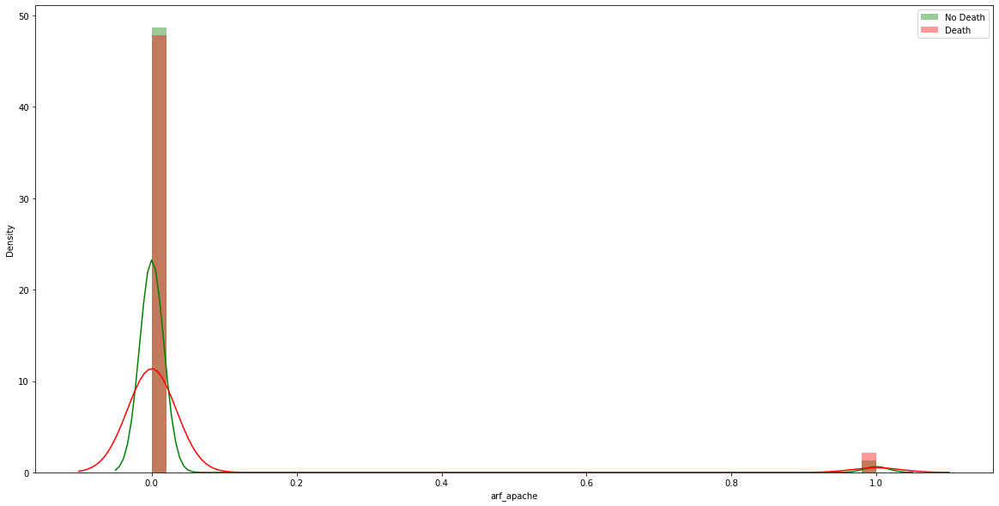

In [47]:
plt.figure(figsize=(20, 10))
sns.distplot(dataG.arf_apache[data.hospital_death == 0], color="g", label="No Death")
sns.distplot(dataG.arf_apache[data.hospital_death == 1], color="r", label="Death")
plt.legend()

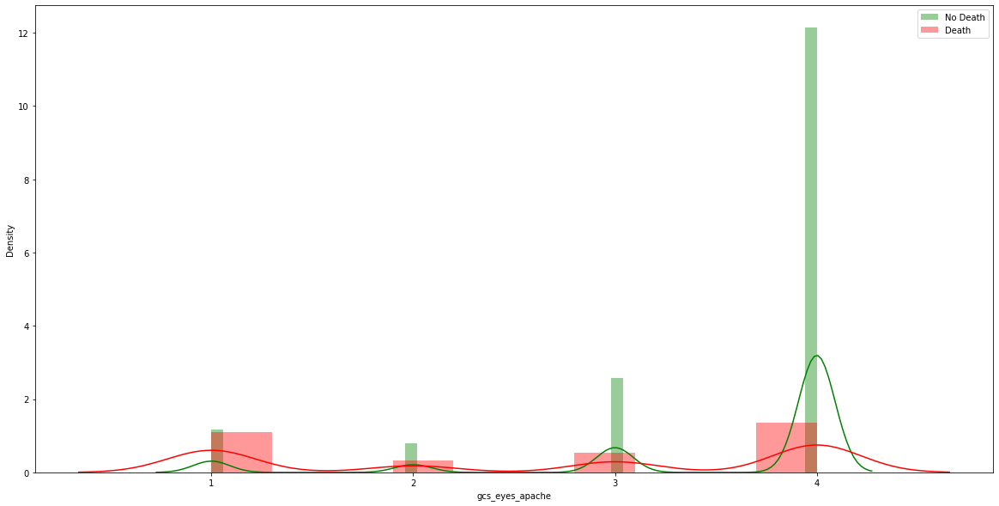

In [48]:
plt.figure(figsize=(20, 10))
sns.distplot(dataG.gcs_eyes_apache[data.hospital_death == 0], color="g", label="No Death")
sns.distplot(dataG.gcs_eyes_apache[data.hospital_death == 1], color="r", label="Death")
plt.legend()

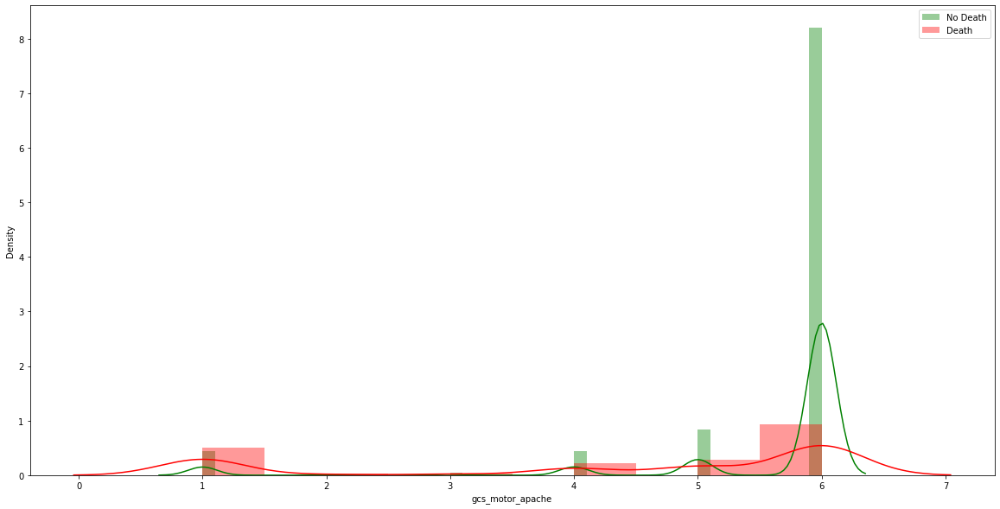

In [49]:
plt.figure(figsize=(20, 10))
sns.distplot(dataG.gcs_motor_apache[data.hospital_death == 0], color="g", label="No Death")
sns.distplot(dataG.gcs_motor_apache[data.hospital_death == 1], color="r", label="Death")
plt.legend()

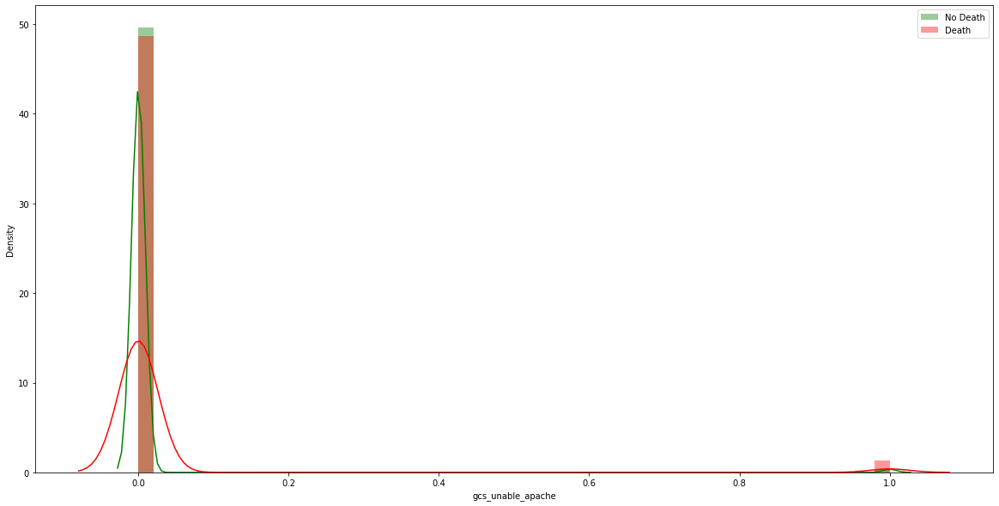

In [50]:
plt.figure(figsize=(20, 10))
sns.distplot(dataG.gcs_unable_apache[data.hospital_death == 0], color="g", label="No Death")
sns.distplot(dataG.gcs_unable_apache[data.hospital_death == 1], color="r", label="Death")
plt.legend()

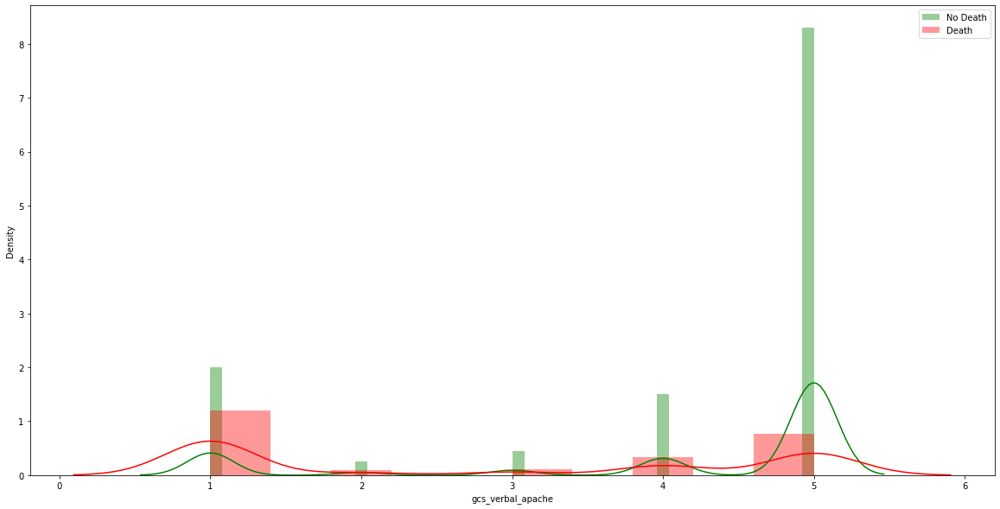

In [51]:
plt.figure(figsize=(20, 10))
sns.distplot(dataG.gcs_verbal_apache[data.hospital_death == 0], color="g", label="No Death")
sns.distplot(dataG.gcs_verbal_apache[data.hospital_death == 1], color="r", label="Death")
plt.legend()

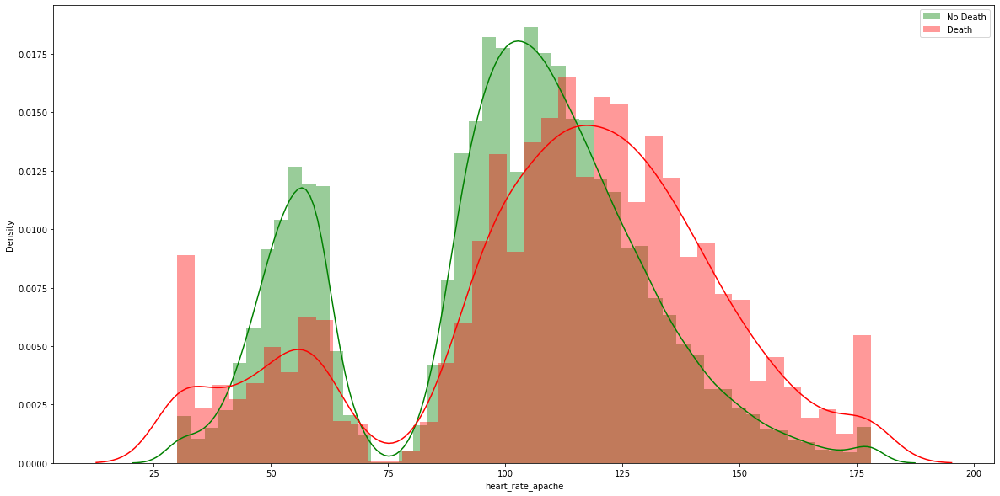

In [52]:
plt.figure(figsize=(20, 10))
sns.distplot(dataG.heart_rate_apache[data.hospital_death == 0], color="g", label="No Death")
sns.distplot(dataG.heart_rate_apache[data.hospital_death == 1], color="r", label="Death")
plt.legend()

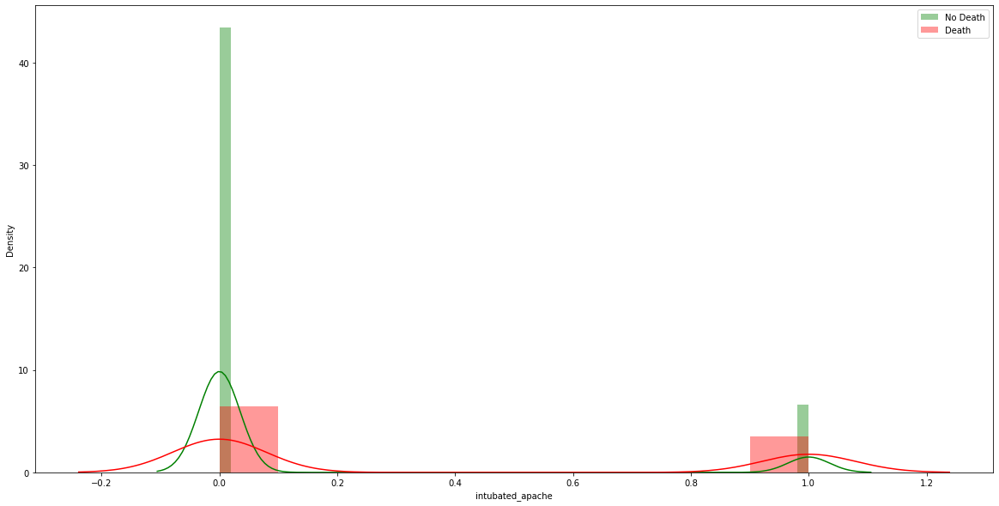

In [53]:
plt.figure(figsize=(20, 10))
sns.distplot(dataG.intubated_apache[data.hospital_death == 0], color="g", label="No Death")
sns.distplot(dataG.intubated_apache[data.hospital_death == 1], color="r", label="Death")
plt.legend()

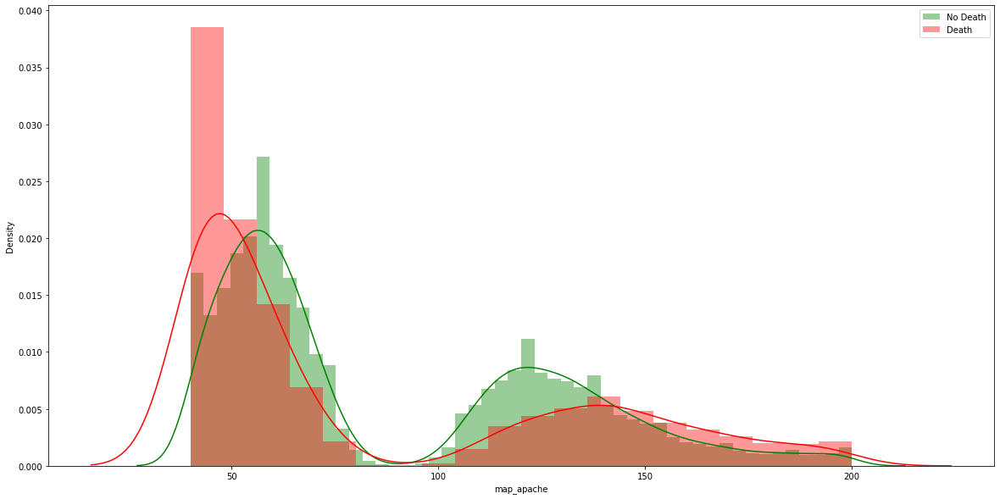

In [54]:
plt.figure(figsize=(20, 10))
sns.distplot(dataG.map_apache[data.hospital_death == 0], color="g", label="No Death")
sns.distplot(dataG.map_apache[data.hospital_death == 1], color="r", label="Death")
plt.legend()

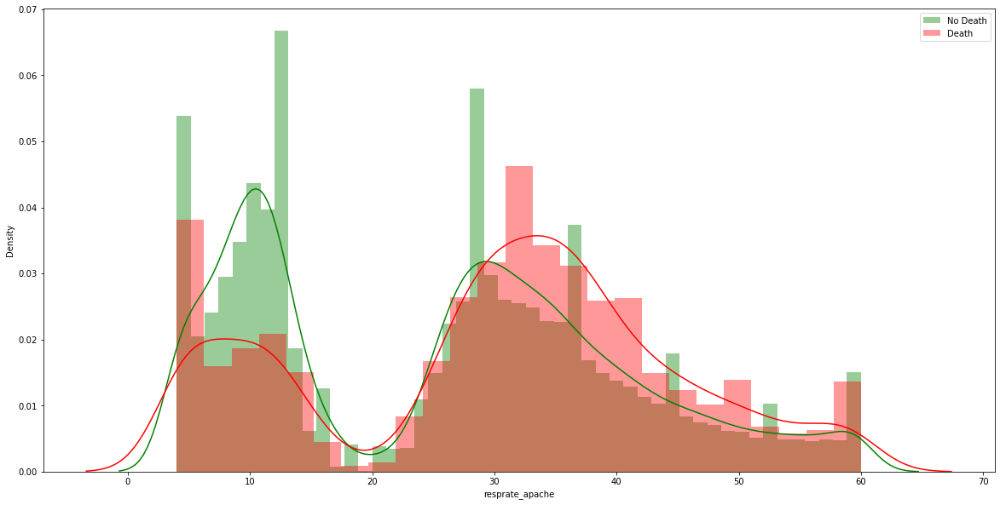

In [55]:
plt.figure(figsize=(20, 10))
sns.distplot(dataG.resprate_apache[data.hospital_death == 0], color="g", label="No Death")
sns.distplot(dataG.resprate_apache[data.hospital_death == 1], color="r", label="Death")
plt.legend()

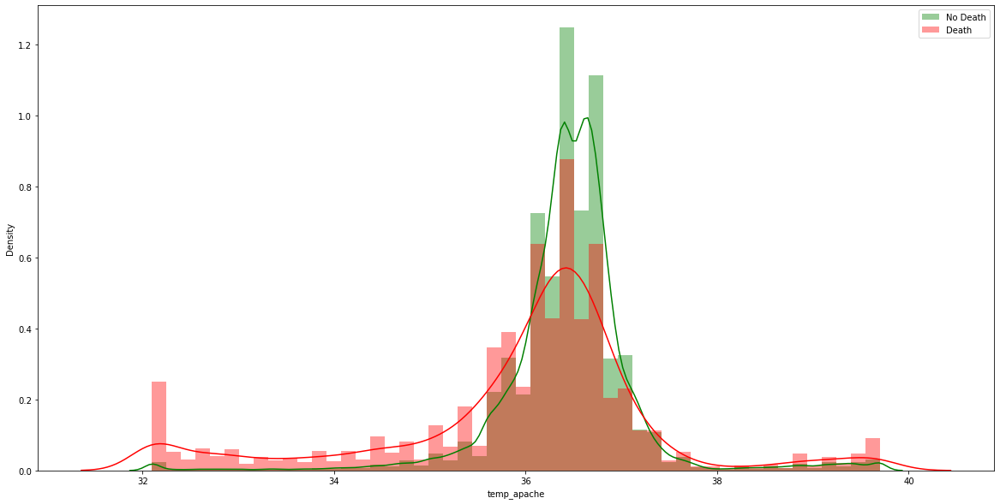

In [56]:
plt.figure(figsize=(20, 10))
sns.distplot(dataG.temp_apache[data.hospital_death == 0], color="g", label="No Death")
sns.distplot(dataG.temp_apache[data.hospital_death == 1], color="r", label="Death")
plt.legend()

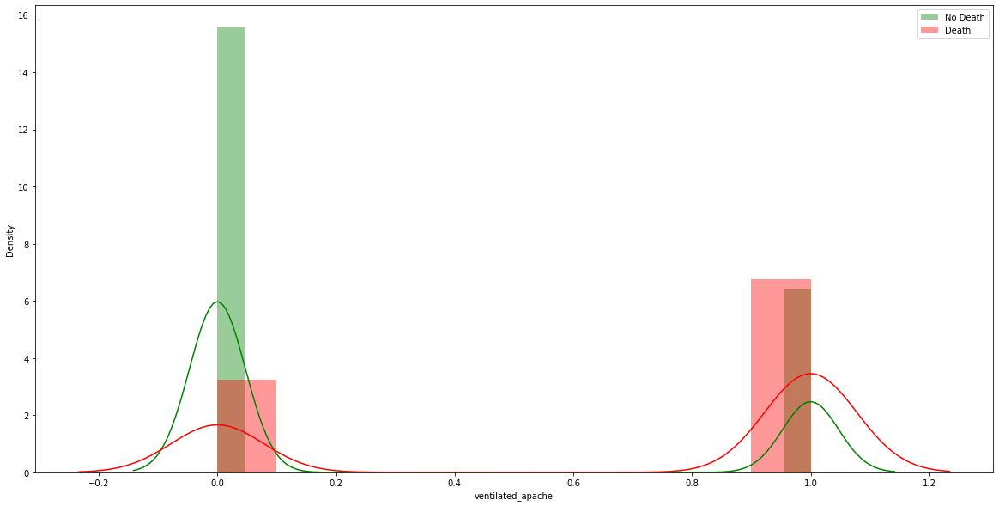

In [57]:
plt.figure(figsize=(20, 10))
sns.distplot(dataG.ventilated_apache[data.hospital_death == 0], color="g", label="No Death")
sns.distplot(dataG.ventilated_apache[data.hospital_death == 1], color="r", label="Death")
plt.legend()

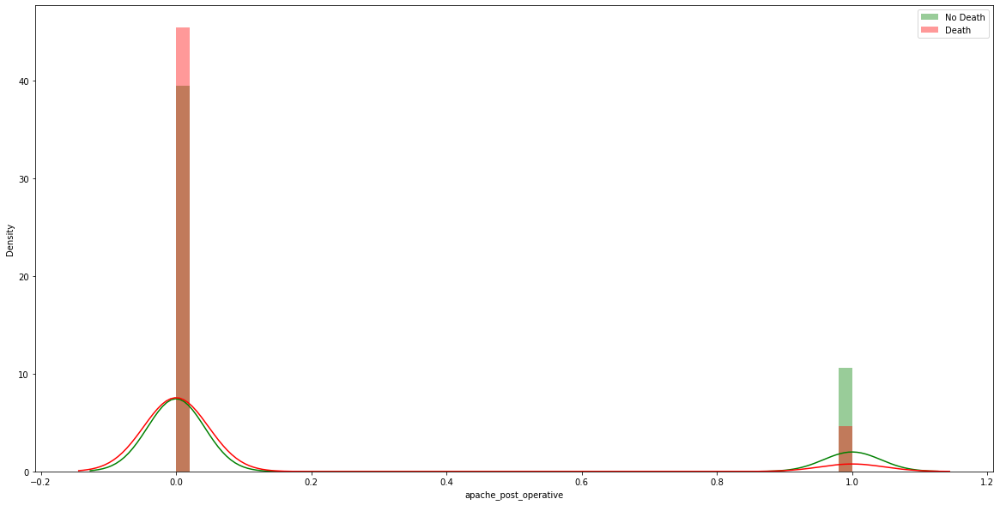

In [58]:
plt.figure(figsize=(20, 10))
sns.distplot(dataG.apache_post_operative[data.hospital_death == 0], color="g", label="No Death")
sns.distplot(dataG.apache_post_operative[data.hospital_death == 1], color="r", label="Death")
plt.legend()

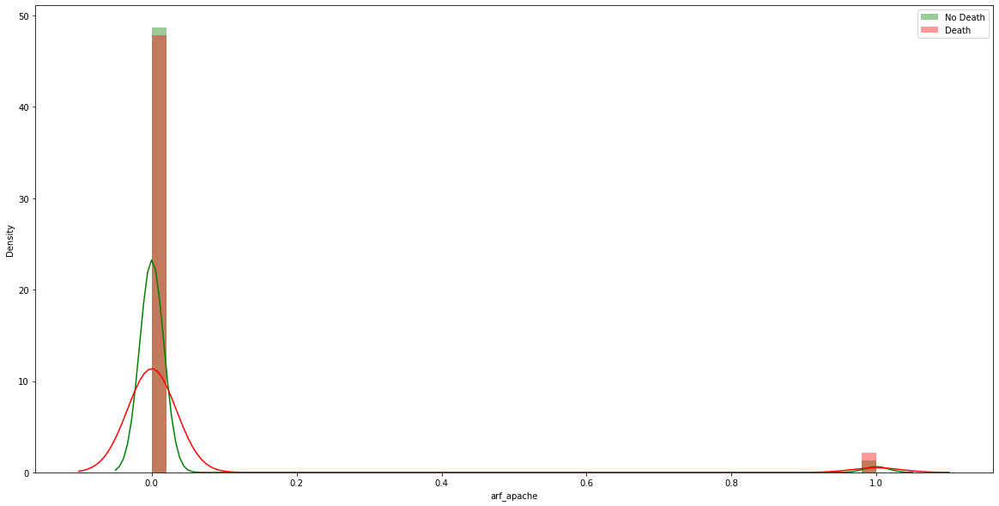

In [59]:
plt.figure(figsize=(20, 10))
sns.distplot(dataG.arf_apache[data.hospital_death == 0], color="g", label="No Death")
sns.distplot(dataG.arf_apache[data.hospital_death == 1], color="r", label="Death")
plt.legend()

# <ins>5. Models<ins>

## Base Models

In [60]:
X= data2.drop('hospital_death', axis=1).values
y = data2['hospital_death']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30,random_state=46, stratify=y)

In [61]:
estimators = [
    ('lr',LogisticRegression()),
    ('dtc',DecisionTreeClassifier()),    
    ('rfc',RandomForestClassifier()),
    ('knc',KNeighborsClassifier())]

classifiers2 = [
    LogisticRegression(max_iter=10000000000,verbose=False),
    RandomForestClassifier(verbose=False),
    ExtraTreesClassifier(verbose=False),
    AdaBoostClassifier(),
    GradientBoostingClassifier(),
    VotingClassifier(estimators=estimators),
    DummyClassifier(strategy='stratified'),
    BaggingClassifier(DecisionTreeClassifier(),max_samples=0.7,bootstrap=True),
    XGBClassifier(verbose=False),
    LinearSVC(verbose=False),
    SVC(verbose=False),   
    KNeighborsClassifier(2),
    DecisionTreeClassifier(),
    MLPClassifier((64,32,16),max_iter=1000000000),
    CatBoostClassifier(verbose=False),
    BernoulliNB(),
    GradientBoostingClassifier(verbose= False),
    SGDClassifier(verbose= False, max_iter=1000000)
]

oversamples2=[None,SMOTE(),RandomUnderSampler() ]

In [62]:
labels2= ["LR",
    "RandomForest",
    "ExtraTrees",
     "AdaBoost",
     "GradientBoosting",
    "Votingr",
    "Dummy",
    "Bagging",
    "XGB",
    "LinearSVC",
    "SVC",   
    "KNeighbors",
    "DecisionTree",
    "MLP",
    "CatB",
    "BernoulliNB",
    "Gradient Boost",
    "SGDClassifier"
    
        ]

In [63]:
score = []
oversampling = []
names = []
precision_score = []
recall_score = []
f1_score = []
accuracy_score = []

time_ = []
i=0
for classifier in classifiers2:    
    i=i+1
    for over in oversamples2: 
    
        clf2 = Pipeline(steps=[('scaler',StandardScaler()),('over',over),("classifier", classifier),])
        start_time = time.time()
        clf2.fit(X_train, y_train)   
        end_time = time.time()
            
        precision_score.append(metrics.precision_score(y_test, clf2.predict(X_test)))
        recall_score.append(metrics.recall_score(y_test, clf2.predict(X_test)))
        f1_score.append( metrics.f1_score(y_test, clf2.predict(X_test)))
        accuracy_score.append(metrics.accuracy_score(y_test, clf2.predict(X_test)))
        names.append(f'{labels2[i-1]}')
        oversampling.append(f'{over}')        
        time_.append(f'{round(end_time-start_time,2)}s')
            
            
        

d2 = {'precision_score': precision_score, 
     'recall_score': recall_score, 
     'f1_score': f1_score,
     'accuracy_score' : accuracy_score,
     'Sampling': oversampling,
     'time':time_
    }

df2 = pd.DataFrame(data=d2)
df2.insert(loc=0, column='Method', value=names)
df2

C:\Users\61425\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

C:\Users\61425\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

C:\Users\61425\anaconda3\lib\site-packages

[23:23:34] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.6.0/src/learner.cc:627: 
Parameters: { "verbose" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[23:23:36] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.6.0/src/learner.cc:627: 
Parameters: { "verbose" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[23:23:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.6.0/src/learner.cc:627: 
Parameters: { "verbose" } might not be used.

  This could be a fa

C:\Users\61425\anaconda3\lib\site-packages\sklearn\svm\_base.py:1225: ConvergenceWarning:

Liblinear failed to converge, increase the number of iterations.

C:\Users\61425\anaconda3\lib\site-packages\sklearn\svm\_base.py:1225: ConvergenceWarning:

Liblinear failed to converge, increase the number of iterations.

C:\Users\61425\anaconda3\lib\site-packages\sklearn\svm\_base.py:1225: ConvergenceWarning:

Liblinear failed to converge, increase the number of iterations.



,Method,precision_score,recall_score,f1_score,accuracy_score,Sampling,time
0,LR,0.669643,0.260870,0.375469,0.924897,None,1.02s
1,LR,0.260536,0.768696,0.389170,0.791173,SMOTE(),2.07s
2,LR,0.266879,0.766522,0.395913,0.797569,RandomUnderSampler(),0.16s
3,RandomForest,0.706682,0.271304,0.392083,0.927193,None,15.29s
4,RandomForest,0.492987,0.412609,0.449231,0.912443,SMOTE(),38.49s
5,RandomForest,0.274889,0.804348,0.409745,0.799451,RandomUnderSampler(),2.03s
6,ExtraTrees,0.757485,0.220000,0.340970,0.926403,None,6.05s
7,ExtraTrees,0.510261,0.400000,0.448452,0.914851,SMOTE(),13.03s
8,ExtraTrees,0.271938,0.803043,0.406291,0.796892,RandomUnderSampler(),1.05s
9,AdaBoost,0.630208,0.315652,0.420626,0.924747,None,7.07s


In [64]:
s = df2.style.apply(lambda x: ["background-color:lime; font-size:1rem;" if i>0.76 \
                          else "background-color:tomato; font-size:0.9rem;" for i in x],
                   subset=["recall_score", "accuracy_score"],
                   )

s

,Method,precision_score,recall_score,f1_score,accuracy_score,Sampling,time
0,LR,0.669643,0.260870,0.375469,0.924897,None,1.02s
1,LR,0.260536,0.768696,0.389170,0.791173,SMOTE(),2.07s
2,LR,0.266879,0.766522,0.395913,0.797569,RandomUnderSampler(),0.16s
3,RandomForest,0.706682,0.271304,0.392083,0.927193,None,15.29s
4,RandomForest,0.492987,0.412609,0.449231,0.912443,SMOTE(),38.49s
5,RandomForest,0.274889,0.804348,0.409745,0.799451,RandomUnderSampler(),2.03s
6,ExtraTrees,0.757485,0.220000,0.340970,0.926403,None,6.05s
7,ExtraTrees,0.510261,0.400000,0.448452,0.914851,SMOTE(),13.03s
8,ExtraTrees,0.271938,0.803043,0.406291,0.796892,RandomUnderSampler(),1.05s
9,AdaBoost,0.630208,0.315652,0.420626,0.924747,None,7.07s


# 6. Feature Selection

Feature: 0, Score: -0.08488
Feature: 1, Score: -0.06604
Feature: 2, Score: 0.30062
Feature: 3, Score: 0.15044
Feature: 4, Score: -0.06478
Feature: 5, Score: -0.07766
Feature: 6, Score: 0.05263
Feature: 7, Score: 0.03405
Feature: 8, Score: -0.14274
Feature: 9, Score: -0.04857
Feature: 10, Score: 0.18395
Feature: 11, Score: -0.07554
Feature: 12, Score: 0.08840
Feature: 13, Score: 0.10363
Feature: 14, Score: 0.14434
Feature: 15, Score: -0.01882
Feature: 16, Score: -0.08991
Feature: 17, Score: 0.53849
Feature: 18, Score: -0.00852
Feature: 19, Score: 0.17975
Feature: 20, Score: -0.00496
Feature: 21, Score: -0.03069
Feature: 22, Score: 0.04538
Feature: 23, Score: 0.08351
Feature: 24, Score: 0.05485
Feature: 25, Score: -0.00743
Feature: 26, Score: -0.12307
Feature: 27, Score: -0.08634
Feature: 28, Score: 0.10612
Feature: 29, Score: -0.11886
Feature: 30, Score: -0.12035
Feature: 31, Score: -0.09100
Feature: 32, Score: 0.03225
Feature: 33, Score: 0.02730
Feature: 34, Score: 0.04313
Feature: 35,

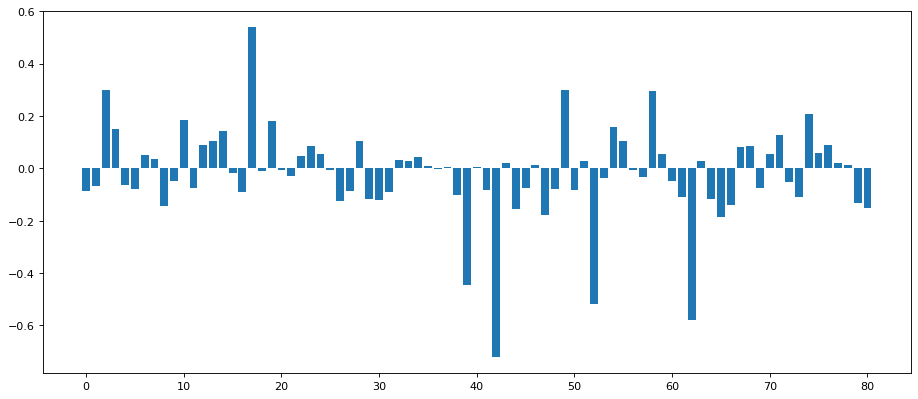

In [65]:
# define dataset
X, y = make_classification(n_samples=1000, n_features=81, n_informative=5, n_redundant=5, random_state=1)
# define the model
model = LogisticRegression()
# fit the model
model.fit(X, y)
# get importance
importance = model.coef_[0]
# summarize feature importance
for i,v in enumerate(importance):
	print('Feature: %0d, Score: %.5f' % (i,v))
# plot feature importance
plt.figure(figsize=(14,6), dpi=80)
tick_spacing = 100
pyplot.bar([x for x in range(len(importance))], importance)
pyplot.show()

# 7. Finetunning the models

In [66]:
def show_summary_report(actual, prediction, probabilities):

    if isinstance(actual, pd.Series):
        actual = actual.values.astype(int)
    prediction = prediction.astype(int)

    print('Accuracy : %.4f [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0' % accuracy_score(actual, prediction))
    print('Precision: %.4f [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0' % precision_score(actual, prediction))
    print('Recall   : %.4f [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0' % recall_score(actual, prediction))
    print('ROC AUC  : %.4f                                                                     Best: 1, Worst: < 0.5' % roc_auc_score(actual, probabilities[:, 1]))
    print('-' * 107)
    print('TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples')

    # Confusion Matrix
    mat = confusion_matrix(actual, prediction)

    # Precision/Recall
    precision, recall, _ = precision_recall_curve(actual, prediction)
    average_precision = average_precision_score(actual, prediction)
    
    # Compute ROC curve and ROC area
    fpr, tpr, _ = roc_curve(actual, probabilities[:, 1])
    roc_auc = auc(fpr, tpr)


    # plot
    fig, ax = plt.subplots(1, 3, figsize = (18, 6))
    fig.subplots_adjust(left = 0.02, right = 0.98, wspace = 0.2)

    # Confusion Matrix
    sns.heatmap(mat.T, square = True, annot = True, fmt = 'd', cbar = False, cmap = 'rocket_r', ax = ax[0])

    ax[0].set_title('Confusion Matrix')
    ax[0].set_xlabel('True label')
    ax[0].set_ylabel('Predicted label')
    
    # Precision/Recall
    step_kwargs = {'step': 'post'}
    ax[1].step(recall, precision, color = 'b', alpha = 0.2, where = 'post')
    ax[1].fill_between(recall, precision, alpha = 0.2, color = 'darkorange', **step_kwargs)
    ax[1].set_ylim([0.0, 1.0])
    ax[1].set_xlim([0.0, 1.0])
    ax[1].set_xlabel('Recall')
    ax[1].set_ylabel('Precision')
    ax[1].set_title('2-class Precision-Recall curve')

    # ROC
    ax[2].plot(fpr, tpr, color = 'darkorange', lw = 2, label = 'ROC curve (AUC = %0.2f)' % roc_auc)
    ax[2].plot([0, 1], [0, 1], color = 'black', lw = 2, linestyle = '--')
    ax[2].set_xlim([0.0, 1.0])
    ax[2].set_ylim([0.0, 1.0])
    ax[2].set_xlabel('False Positive Rate')
    ax[2].set_ylabel('True Positive Rate')
    ax[2].set_title('Receiver Operating Characteristic')
    ax[2].legend(loc = 'lower right')

    plt.show()

##  <u> 1. Logistic Regression: <u> 

## Logistic Regression model 1 (LR1)

In [71]:
# define dataset
X= data2.drop('hospital_death', axis=1)
y = data2['hospital_death']

X, y = make_classification(n_samples = 100000, random_state=42, weights=[0.9])

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30,random_state=46, stratify=y) 

In [72]:
# define pipeline
Scaler= StandardScaler()
model = LogisticRegression(random_state=42,max_iter=100000, class_weight = 'balanced')
under = RandomUnderSampler()
steps = [('Scaler',Scaler), ('under', under), ('model', model)]

pipelineLR1 = Pipeline(steps=steps)
# Fitting the model
pipelineLR1.fit(X_train, y_train)

Pipeline(steps=[('Scaler', StandardScaler()), ('under', RandomUnderSampler()),
                ('model',
                 LogisticRegression(class_weight='balanced', max_iter=100000,
                                    random_state=42))])

Accuracy : 0.8552 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.4060 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.8485 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9246                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


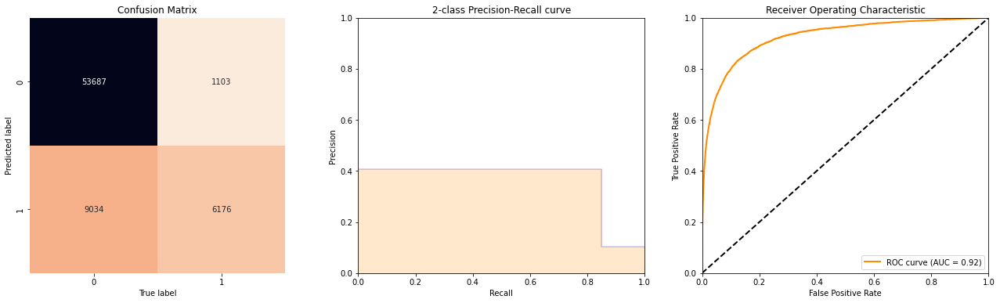

In [73]:

# Model scores on test and training data
y_train_predLR1 = pipelineLR1.predict(X_train)
y_train_probLR1 = pipelineLR1.predict_proba(X_train)

show_summary_report(y_train, y_train_predLR1, y_train_probLR1)

Accuracy : 0.8578 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.4106 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.8442 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9230                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


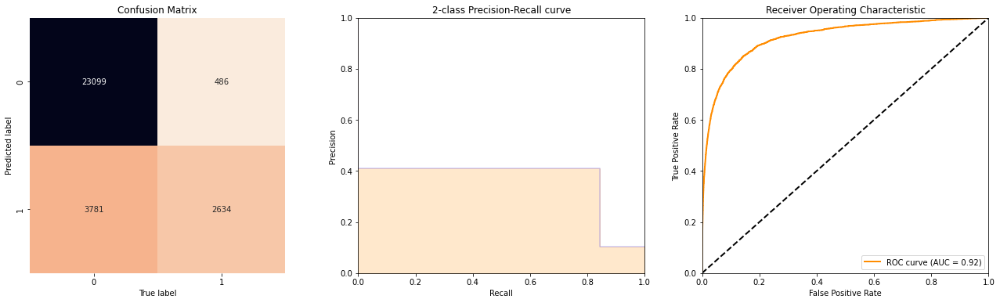

In [74]:
y_test_predLR1 = pipelineLR1.predict(X_test)
y_test_probLR1 = pipelineLR1.predict_proba(X_test)
show_summary_report(y_test, y_test_predLR1, y_test_probLR1)

In [75]:
# Metrics
LR1P= precision_score(y_test, y_test_predLR1, pos_label=1)
LR1TA= accuracy_score(y_train, y_train_predLR1) 
LR1A= accuracy_score(y_test, y_test_predLR1)
LR1R = recall_score(y_test, y_test_predLR1, pos_label=1)
LR1ROC = 0.9230

## Cross Validation

In [76]:
cv_scoresLR1 = cross_val_score(pipelineLR1, X_train, y_train, cv=4)
print("Cross Validation Scores are:", cv_scoresLR1)
meanLR1= np.mean(cv_scoresLR1)
print("Average 4-Fold CV Score", meanLR1)

Cross Validation Scores are: [0.85325714 0.85868571 0.85508571 0.85611429]
Average 4-Fold CV Score 0.8557857142857144


# 2. <u>RandomForestClassifier <u>

In [77]:
X= data2.drop('hospital_death', axis=1)
y = data2['hospital_death']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30,random_state=46, stratify=y)

In [78]:
scaler = StandardScaler()
model = RandomForestClassifier( n_estimators= 150, max_features= 150, min_samples_split=3)
under = RandomUnderSampler()

steps = [('Scaler', StandardScaler()), ('under', under), ('model', model)]
pipelineRF1 = Pipeline(steps=steps)
pipelineRF1.fit(X_train, y_train)

Pipeline(steps=[('Scaler', StandardScaler()), ('under', RandomUnderSampler()),
                ('model',
                 RandomForestClassifier(max_features=150, min_samples_split=3,
                                        n_estimators=150))])

Accuracy : 0.8217 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.3267 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 1.0000 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9787                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


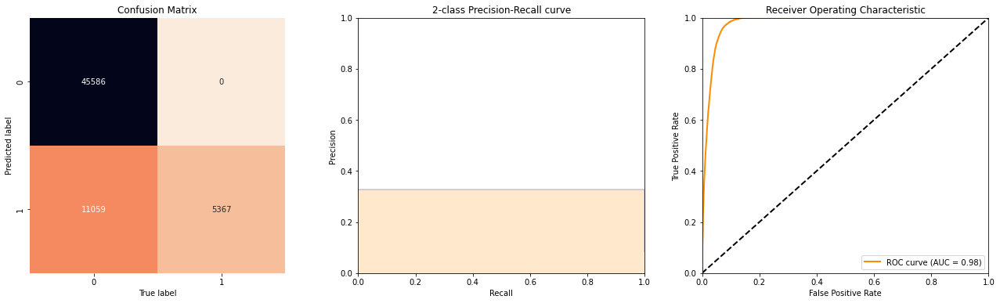

In [79]:
y_train_predRF1 = pipelineRF1.predict(X_train)
y_train_probRF1 = pipelineRF1.predict_proba(X_train)
show_summary_report(y_train, y_train_predRF1, y_train_probRF1)

Accuracy : 0.7836 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.2609 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.8187 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8765                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


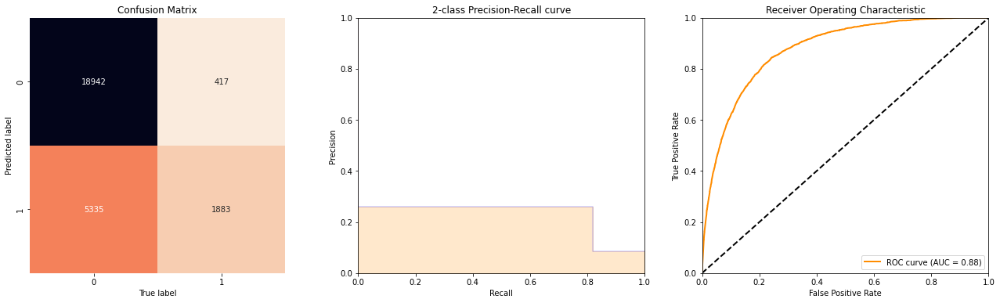

In [80]:
y_test_predRF1 = pipelineRF1.predict(X_test)
y_test_probRF1 = pipelineRF1.predict_proba(X_test)
show_summary_report(y_test, y_test_predRF1, y_test_probRF1)

In [81]:
# Metrics
RF1P= precision_score(y_test, y_test_predRF1, pos_label=1)
RF1TA= accuracy_score(y_train, y_train_predRF1) 
RF1A= accuracy_score(y_test, y_test_predRF1)
RF1R = recall_score(y_test, y_test_predRF1, pos_label=1)
RF1ROC = 0.8765

## Cross Validation

In [82]:
cv_scoresRF1 = cross_val_score(pipelineRF1, X_train, y_train, cv=4)
print("Cross Validation Scores are:", cv_scoresRF1)
meanRF1= np.mean(cv_scoresLR1)
print("Average 4-Fold CV Score", meanRF1)

Cross Validation Scores are: [0.78842805 0.79745856 0.78333226 0.78088112]
Average 4-Fold CV Score 0.8557857142857144


# 3. <u> ExtraTrees <u>

In [83]:
X= data2.drop('hospital_death', axis=1)
y = data2['hospital_death']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30,random_state=46, stratify=y)

In [84]:
# define pipeline
Scaler = StandardScaler()
model = ExtraTreesClassifier(n_estimators= 150, max_features= 150, min_samples_split=4, random_state=46)
under = RandomUnderSampler()
steps = [('Scaler', StandardScaler()), ('under', under), ('model', model)]
pipelineET1 = Pipeline(steps=steps)

pipelineET1.fit(X_train, y_train)

Pipeline(steps=[('Scaler', StandardScaler()), ('under', RandomUnderSampler()),
                ('model',
                 ExtraTreesClassifier(max_features=150, min_samples_split=4,
                                      n_estimators=150, random_state=46))])

Accuracy : 0.8353 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.3445 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 1.0000 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9984                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


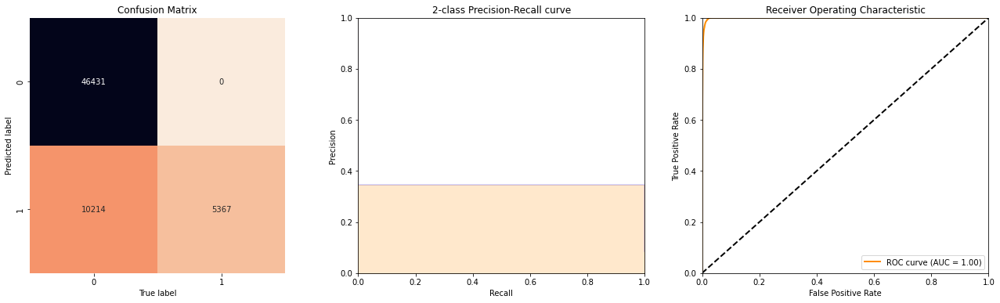

In [85]:
# Model scores on test and training data
y_train_predET1 = pipelineET1.predict(X_train)
y_train_probET1 = pipelineET1.predict_proba(X_train)

show_summary_report(y_train, y_train_predET1, y_train_probET1)

Accuracy : 0.7978 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.2723 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.7991 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8812                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


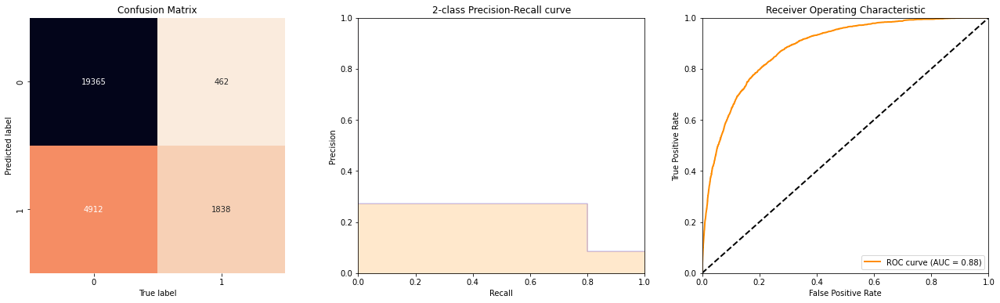

In [86]:
y_test_predET1 = pipelineET1.predict(X_test)
y_test_probET1 = pipelineET1.predict_proba(X_test)
show_summary_report(y_test, y_test_predET1, y_test_probET1)

In [87]:
# Metrics
ET1P= precision_score(y_test, y_test_predET1, pos_label=1)
ET1TA= accuracy_score(y_train, y_train_predET1) 
ET1A= accuracy_score(y_test, y_test_predET1)
ET1R = recall_score(y_test, y_test_predET1, pos_label=1)
ET1ROC = 0.8812

## Cross Validation

In [88]:
cv_scoresET1 = cross_val_score(pipelineET1, X_train, y_train, cv=4)
print("Cross Validation Scores are:", cv_scoresET1)
meanET1= np.mean(cv_scoresET1)
print("Average 4-Fold CV Score", meanET1)

Cross Validation Scores are: [0.79558795 0.80074824 0.79191124 0.79403986]
Average 4-Fold CV Score 0.7955718248081016


# <u> 4. Gradient Boosting<u>

In [89]:
X= data2.drop('hospital_death', axis=1)
y = data2['hospital_death']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30,random_state=46, stratify=y)

In [90]:
modelGB = GradientBoostingClassifier(n_estimators= 300, random_state=46, max_depth=10, subsample=0.5)
Scaler = StandardScaler()
under = RandomUnderSampler(random_state=42, replacement=True)
steps = [('Scaler', StandardScaler()), ('under', under), ('modelGB', modelGB)]
pipelineGB1 = Pipeline(steps=steps)
pipelineGB1.fit(X_train, y_train)


Pipeline(steps=[('Scaler', StandardScaler()),
                ('under',
                 RandomUnderSampler(random_state=42, replacement=True)),
                ('modelGB',
                 GradientBoostingClassifier(max_depth=10, n_estimators=300,
                                            random_state=46, subsample=0.5))])

Accuracy : 0.8244 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.3301 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 1.0000 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9829                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


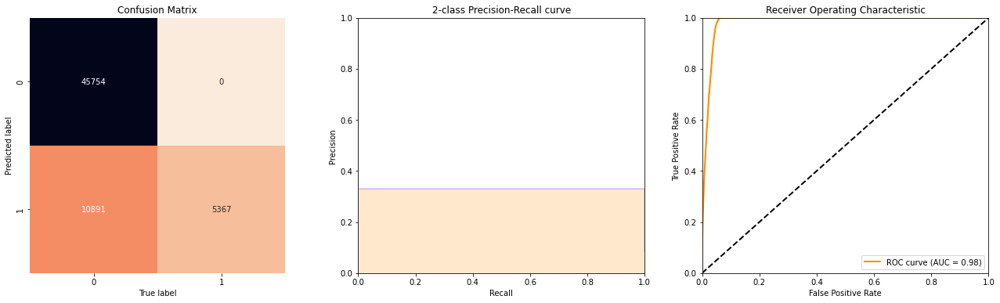

In [91]:
y_train_predGB1 = pipelineGB1.predict(X_train)
y_train_probGB1 = pipelineGB1.predict_proba(X_train)

show_summary_report(y_train, y_train_predGB1, y_train_probGB1)

Accuracy : 0.7892 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.2671 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.8230 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8880                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


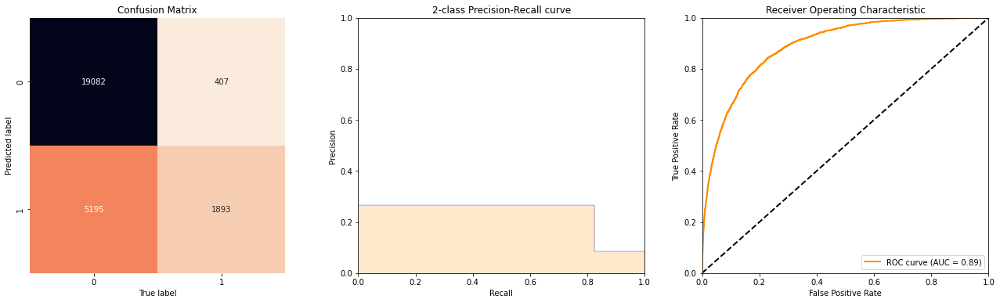

In [92]:
y_test_predGB1 = pipelineGB1.predict(X_test)
y_test_probGB1 = pipelineGB1.predict_proba(X_test)
show_summary_report(y_test, y_test_predGB1, y_test_probGB1)

In [93]:
# Metrics
GB1P= precision_score(y_test, y_test_predGB1, pos_label=1)
GB1TA= accuracy_score(y_train, y_train_predGB1) 
GB1A= accuracy_score(y_test, y_test_predGB1)
GB1R = recall_score(y_test, y_test_predGB1, pos_label=1)
GB1ROC = 0.8880

# Cross Validation

In [94]:
cv_scoresGB1 = cross_val_score(pipelineGB1, X_train, y_train, cv=4)
print("Cross Validation Scores are:", cv_scoresGB1)
meanGB1= np.mean(cv_scoresGB1)
print("Average 4-Fold CV Score", meanGB1)

Cross Validation Scores are: [0.79636199 0.78733148 0.78836354 0.79191124]
Average 4-Fold CV Score 0.7909920660517319


# <u> 5. Bagging<u>

## 5a) Bagging and DecisionTreeClassifier

In [95]:
X= data2.drop('hospital_death', axis=1).values
y = data2['hospital_death']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30,random_state=46, stratify=y ) 
X, y = make_classification(n_samples=1000, n_features=20, n_informative=15, n_redundant=5, random_state=5)

In [96]:
model = BaggingClassifier(DecisionTreeClassifier())   
Scaler = StandardScaler()
under = RandomUnderSampler(random_state=42, replacement=True)


steps = [('Scaler', StandardScaler()), ('under', under), ('model', model)]
pipelineBDT = Pipeline(steps=steps)
pipelineBDT.fit(X_train, y_train)

Pipeline(steps=[('Scaler', StandardScaler()),
                ('under',
                 RandomUnderSampler(random_state=42, replacement=True)),
                ('model',
                 BaggingClassifier(base_estimator=DecisionTreeClassifier()))])

Accuracy : 0.8252 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.3293 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.9830 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9605                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


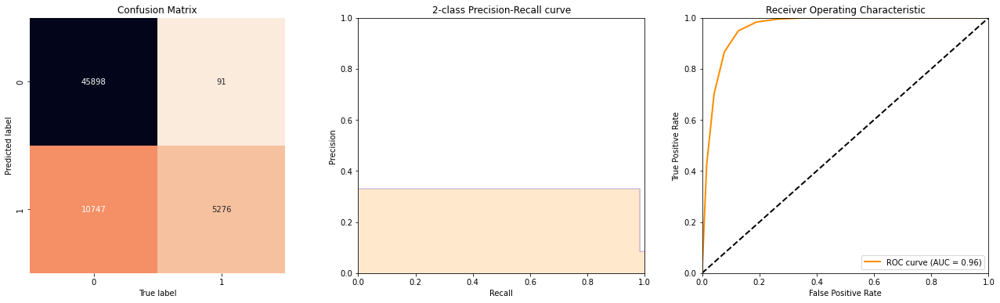

In [97]:
y_train_predBDT = pipelineBDT.predict(X_train)
y_train_probBDT = pipelineBDT.predict_proba(X_train)

show_summary_report(y_train, y_train_predBDT, y_train_probBDT)

Accuracy : 0.7876 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.2544 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.7530 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8538                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


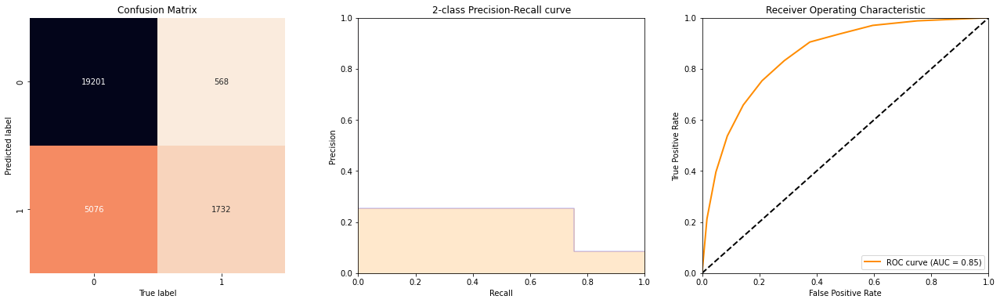

In [98]:
y_test_predBDT = pipelineBDT.predict(X_test)
y_test_probBDT = pipelineBDT.predict_proba(X_test)
show_summary_report(y_test, y_test_predBDT, y_test_probBDT)

In [99]:
BDTP= precision_score(y_test, y_test_predBDT, pos_label=1)
BDTTA= accuracy_score(y_train, y_train_predBDT) 
BDTA= accuracy_score(y_test, y_test_predBDT)
BDTR = recall_score(y_test, y_test_predBDT, pos_label=1)
BDT1ROC = 0.8538

## Cross Validation

In [100]:
cv_scoresBDT = cross_val_score(pipelineBDT, X_train, y_train, cv=4)
print("Cross Validation Scores are:", cv_scoresBDT)
meanBDT= np.mean(cv_scoresBDT)
print("Average 4-Fold CV Score", meanBDT)

Cross Validation Scores are: [0.80165129 0.79745856 0.7928788  0.79333032]
Average 4-Fold CV Score 0.7963297426304587


## 5b) Bagging and Logistic Regression

In [101]:
X= data2.drop('hospital_death', axis=1).values
y = data2['hospital_death']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30,random_state=46, stratify=y ) 

X, y = make_classification(n_samples=1000, n_features=20, n_informative=15, n_redundant=5, random_state=5)

In [102]:
model = BaggingClassifier(LogisticRegression(max_iter=10000, class_weight = 'balanced'))   
Scaler = StandardScaler()
under = RandomUnderSampler(random_state=42, replacement=True)


steps = [('Scaler', StandardScaler()), ('under', under), ('model', model)]
pipelineBLR = Pipeline(steps=steps)
pipelineBLR.fit(X_train, y_train)


# Fit the bagging classifier
pipelineBLR.fit(X_train, y_train)

Pipeline(steps=[('Scaler', StandardScaler()),
                ('under',
                 RandomUnderSampler(random_state=42, replacement=True)),
                ('model',
                 BaggingClassifier(base_estimator=LogisticRegression(class_weight='balanced',
                                                                     max_iter=10000)))])

Accuracy : 0.8022 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.2715 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.7637 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8679                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


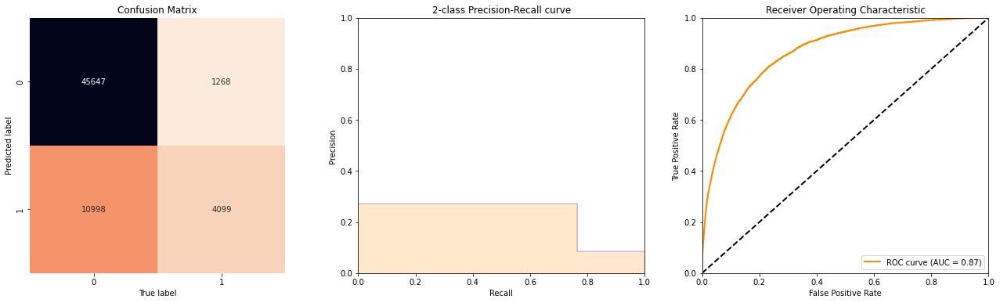

In [103]:
y_train_predBLR = pipelineBLR.predict(X_train)
y_train_probBLR= pipelineBLR.predict_proba(X_train)

show_summary_report(y_train, y_train_predBLR, y_train_probBLR)

Accuracy : 0.8005 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.2703 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.7678 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8700                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


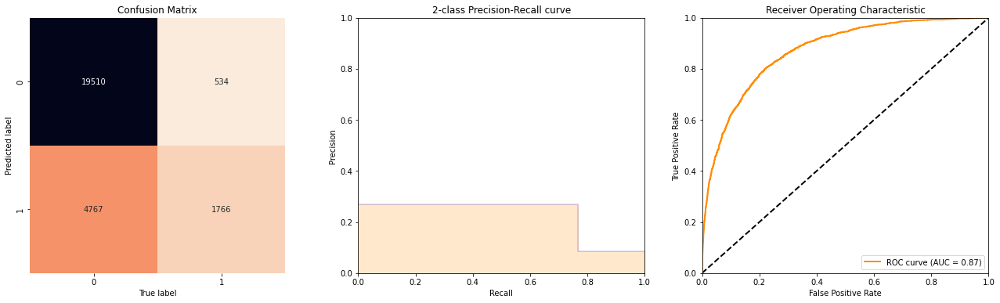

In [104]:
y_test_predBLR = pipelineBLR.predict(X_test)
y_test_probBLR = pipelineBLR.predict_proba(X_test)
show_summary_report(y_test, y_test_predBLR, y_test_probBLR)

In [105]:
BLRP= precision_score(y_test, y_test_predBLR, pos_label=1)
BLRTA= accuracy_score(y_train, y_train_predBLR) 
BLRA= accuracy_score(y_test, y_test_predBLR)
BLRR = recall_score(y_test, y_test_predBLR, pos_label=1)
BLR1ROC = 0.8700

## Cross Validation

In [106]:
cv_scoresBLR = cross_val_score(pipelineBLR, X_train, y_train, cv=4)
print("Cross Validation Scores are:", cv_scoresBLR)
meanBLR= np.mean(cv_scoresBLR)
print("Average 4-Fold CV Score", meanBLR)

Cross Validation Scores are: [0.79281429 0.79713604 0.79352383 0.7981681 ]
Average 4-Fold CV Score 0.7954105656969619


## 5c) Bagging & BernoulliNB

In [107]:
X= data2.drop('hospital_death', axis=1).values
y = data2['hospital_death']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30,random_state=46, stratify=y ) 

X, y = make_classification(n_samples=1000, n_features=20, n_informative=15, n_redundant=5, random_state=5)

In [108]:
model = BaggingClassifier(BernoulliNB())   
Scaler = StandardScaler()
under = RandomUnderSampler(random_state=42, replacement=True)


steps = [('Scaler', StandardScaler()), ('under', under), ('model', model)]
pipelineBBNB = Pipeline(steps=steps)
pipelineBBNB.fit(X_train, y_train)


# Fit the bagging classifier
pipelineBBNB.fit(X_train, y_train)

Pipeline(steps=[('Scaler', StandardScaler()),
                ('under',
                 RandomUnderSampler(random_state=42, replacement=True)),
                ('model', BaggingClassifier(base_estimator=BernoulliNB()))])

Accuracy : 0.7396 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.2167 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.7684 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8272                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


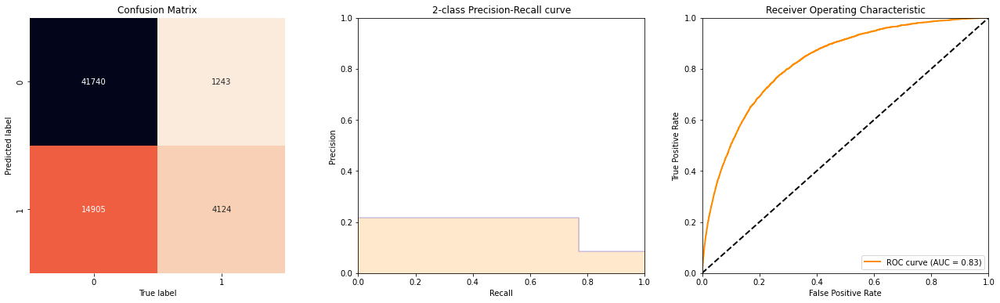

In [109]:
y_train_predBBNB = pipelineBBNB.predict(X_train)
y_train_probBBNB = pipelineBBNB.predict_proba(X_train)

show_summary_report(y_train, y_train_predBBNB, y_train_probBBNB)

Accuracy : 0.7354 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.2148 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.7743 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8309                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


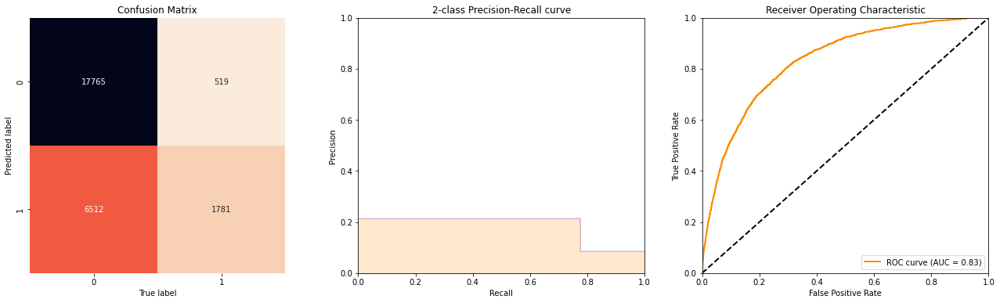

In [110]:
y_test_predBBNB= pipelineBBNB.predict(X_test)
y_test_probBBNB = pipelineBBNB.predict_proba(X_test)
show_summary_report(y_test, y_test_predBBNB, y_test_probBBNB)

In [111]:
BBNBP= precision_score(y_test, y_test_predBBNB, pos_label=1)
BBNBTA= accuracy_score(y_train, y_train_predBBNB) 
BBNBA= accuracy_score(y_test, y_test_predBBNB)
BBNBR = recall_score(y_test, y_test_predBBNB, pos_label=1)
BBNBROC = 0.8309

## Cross Validation

In [112]:
cv_scoresBBNB = cross_val_score(pipelineBBNB, X_train, y_train, cv=4)
print("Cross Validation Scores are:", cv_scoresBBNB)
meanBBNB= np.mean(cv_scoresBBNB)
print("Average 4-Fold CV Score", meanBBNB)

Cross Validation Scores are: [0.74108237 0.74101787 0.73972779 0.73740566]
Average 4-Fold CV Score 0.7398084241759659


## 5d) Bagging & KNN

In [113]:
X= data2.drop('hospital_death', axis=1).values
y = data2['hospital_death']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30,random_state=46, stratify=y ) 

X, y = make_classification(n_samples=1000, n_features=20, n_informative=15, n_redundant=5, random_state=5)

In [114]:
model = BaggingClassifier(KNeighborsClassifier(n_neighbors = 1))   
Scaler = StandardScaler()
under = RandomUnderSampler(random_state=42, replacement=True)


steps = [('Scaler', StandardScaler()), ('under', under), ('model', model)]
pipelineBKNN = Pipeline(steps=steps)
pipelineBKNN.fit(X_train, y_train)


# Fit the bagging classifier
pipelineBKNN.fit(X_train, y_train)

Pipeline(steps=[('Scaler', StandardScaler()),
                ('under',
                 RandomUnderSampler(random_state=42, replacement=True)),
                ('model',
                 BaggingClassifier(base_estimator=KNeighborsClassifier(n_neighbors=1)))])

Accuracy : 0.8180 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.3148 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.9370 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9196                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


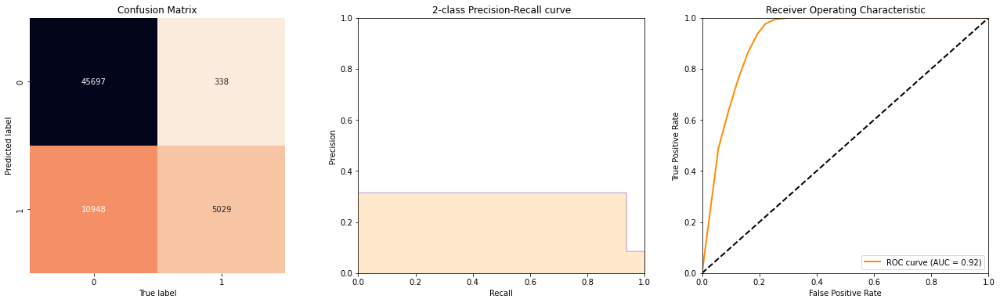

In [115]:
y_train_predBKNN = pipelineBKNN.predict(X_train)
y_train_probBKNN = pipelineBKNN.predict_proba(X_train)

show_summary_report(y_train, y_train_predBKNN, y_train_probBKNN)

Accuracy : 0.7703 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.2136 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.6170 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.7733                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


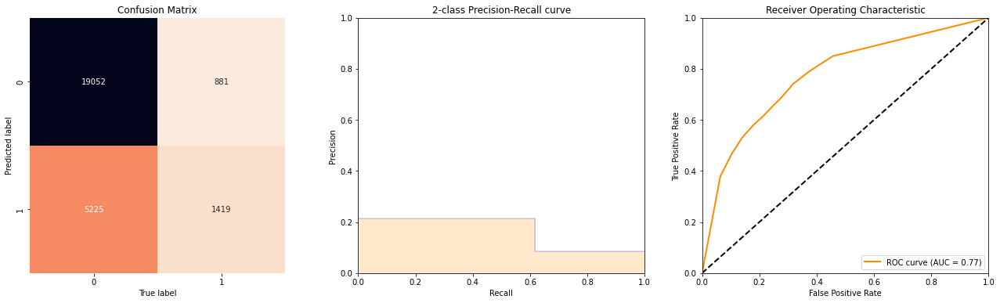

In [116]:
y_test_predBKNN = pipelineBKNN.predict(X_test)
y_test_probBKNN = pipelineBKNN.predict_proba(X_test)
show_summary_report(y_test, y_test_predBKNN, y_test_probBKNN)

In [118]:
BKNNP= precision_score(y_test, y_test_predBKNN, pos_label=1)
BKNNTA= accuracy_score(y_train, y_train_predBKNN) 
BKNNA= accuracy_score(y_test, y_test_predBKNN)
BKNNR = recall_score(y_test, y_test_predBKNN, pos_label=1)
BKNNROC = 0.7733

## Cross Validation

In [119]:
cv_scoresBBNB = cross_val_score(pipelineBBNB, X_train, y_train, cv=4)
print("Cross Validation Scores are:", cv_scoresBBNB)
meanBBNB= np.mean(cv_scoresBBNB)
print("Average 4-Fold CV Score", meanBBNB)

Cross Validation Scores are: [0.73972779 0.73934077 0.74063085 0.73585758]
Average 4-Fold CV Score 0.7388892472424692


## 5e) Bagging and SVC

In [120]:
X= data2.drop('hospital_death', axis=1).values
y = data2['hospital_death']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30,random_state=46, stratify=y ) 
X, y = make_classification(n_samples=1000, n_features=20, n_informative=15, n_redundant=5, random_state=5)

In [121]:
model = BaggingClassifier(SVC(kernel='linear', C = 1.0,  cache_size=200, class_weight= 'balanced',  gamma='auto',  verbose=False))   
Scaler = StandardScaler() 
under = RandomUnderSampler(random_state=42, replacement=True)


steps = [('Scaler', StandardScaler()), ('under', under), ('model', model)]
pipelineBSVC = Pipeline(steps=steps)
pipelineBSVC.fit(X_train, y_train)


# Fit the bagging classifier
pipelineBSVC.fit(X_train, y_train)

Pipeline(steps=[('Scaler', StandardScaler()),
                ('under',
                 RandomUnderSampler(random_state=42, replacement=True)),
                ('model',
                 BaggingClassifier(base_estimator=SVC(class_weight='balanced',
                                                      gamma='auto',
                                                      kernel='linear')))])

Accuracy : 0.8020 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.2714 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.7647 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8156                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


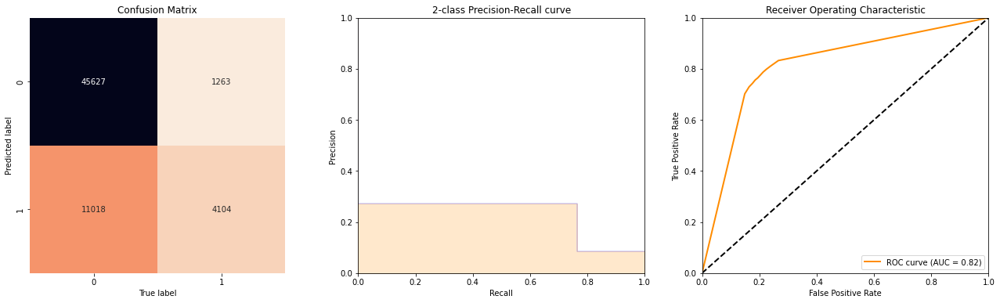

In [122]:
y_train_predBSVC = pipelineBSVC.predict(X_train)
y_train_probBSVC = pipelineBSVC.predict_proba(X_train)

show_summary_report(y_train, y_train_predBSVC, y_train_probBSVC)

Accuracy : 0.8016 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.2722 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.7722 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8180                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


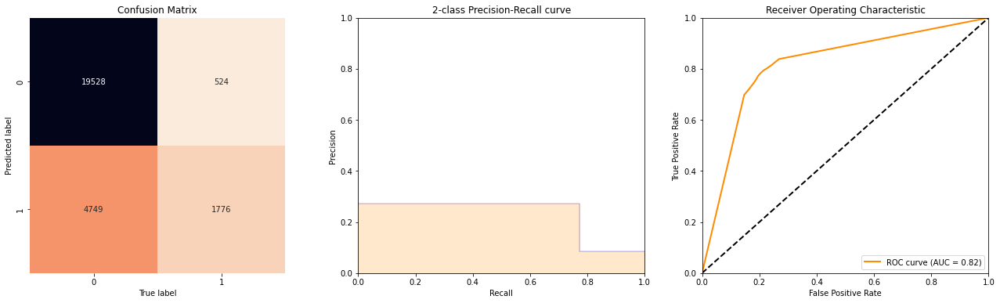

In [123]:
y_test_predBSVC = pipelineBSVC.predict(X_test)
y_test_probBSVC = pipelineBSVC.predict_proba(X_test)
show_summary_report(y_test, y_test_predBSVC, y_test_probBSVC)

In [124]:
BSVCP= precision_score(y_test, y_test_predBSVC, pos_label=1)
BSVCTA= accuracy_score(y_train, y_train_predBSVC) 
BSVCA= accuracy_score(y_test, y_test_predBSVC)
BSVCR = recall_score(y_test, y_test_predBSVC, pos_label=1)
BSVCROC = 0.8180

## Cross Validation

In [125]:
cv_scoresBSVC = cross_val_score(pipelineBSVC, X_train, y_train, cv=4)
print("Cross Validation Scores are:", cv_scoresBSVC)
meanBSVC= np.mean(cv_scoresBSVC)
print("Average 4-Fold CV Score", meanBSVC)

Cross Validation Scores are: [0.79178224 0.79868413 0.79597497 0.80023221]
Average 4-Fold CV Score 0.7966683867638522


## 5f) Bagging & CatBoost

In [126]:
X= data2.drop('hospital_death', axis=1).values
y = data2['hospital_death']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30,random_state=46, stratify=y ) 
X, y = make_classification(n_samples=1000, n_features=20, n_informative=15, n_redundant=5, random_state=5)

In [127]:
model = BaggingClassifier(CatBoostClassifier( verbose= False))   
Scaler = StandardScaler()
under = RandomUnderSampler(random_state=42, replacement=True)


steps = [('Scaler', StandardScaler()), ('under', under), ('model', model)]
pipelineBCB = Pipeline(steps=steps)
pipelineBCB.fit(X_train, y_train)


# Fit the bagging classifier
pipelineBCB.fit(X_train, y_train)

Pipeline(steps=[('Scaler', StandardScaler()),
                ('under',
                 RandomUnderSampler(random_state=42, replacement=True)),
                ('model',
                 BaggingClassifier(base_estimator=<catboost.core.CatBoostClassifier object at 0x000002485828FA30>))])

Accuracy : 0.8164 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.3090 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.9070 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9341                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


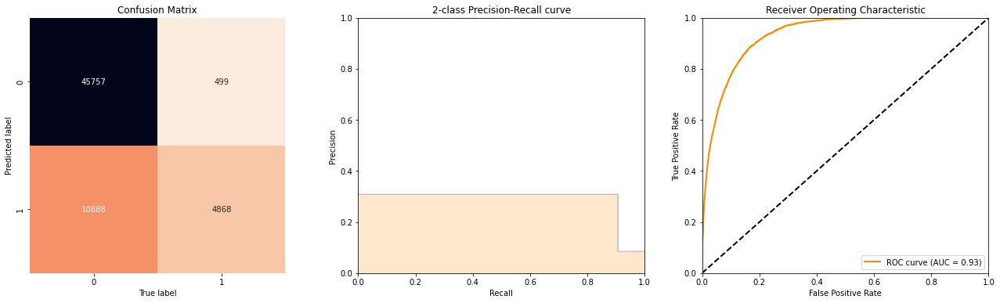

In [128]:
y_train_predBCB = pipelineBCB.predict(X_train)
y_train_probBCB = pipelineBCB.predict_proba(X_train)

show_summary_report(y_train, y_train_predBCB, y_train_probBCB)

Accuracy : 0.7946 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.2719 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.8187 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8926                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


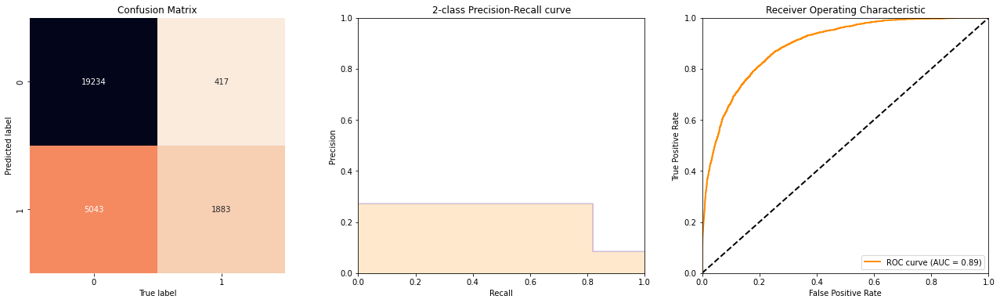

In [129]:
y_test_predBCB = pipelineBCB.predict(X_test)
y_test_probBCB = pipelineBCB.predict_proba(X_test)
show_summary_report(y_test, y_test_predBCB, y_test_probBCB)

In [130]:
BCBP= precision_score(y_test, y_test_predBCB, pos_label=1)
BCBTA= accuracy_score(y_train, y_train_predBCB) 
BCBA= accuracy_score(y_test, y_test_predBCB)
BCBR = recall_score(y_test, y_test_predBCB, pos_label=1)
BCBROC = 0.8926

## Cross Validation

In [131]:
cv_scoresBCB = cross_val_score(pipelineBCB, X_train, y_train, cv=4)
print("Cross Validation Scores are:", cv_scoresBCB)
meanBCB= np.mean(cv_scoresBCB)
print("Average 4-Fold CV Score", meanBCB)

Cross Validation Scores are: [0.80255434 0.79965168 0.79687802 0.79403986]
Average 4-Fold CV Score 0.79828097787525


# <u> 6.CatBoost<u>

In [132]:
X= data2.drop('hospital_death', axis=1).values
y = data2['hospital_death']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30,random_state=46, stratify=y ) 
X, y = make_classification(n_samples=1000, n_features=20, n_informative=15, n_redundant=5, random_state=5)

In [133]:
# define pipeline
model = CatBoostClassifier( scale_pos_weight=3, verbose= False)
Scaler = StandardScaler()
under = RandomUnderSampler(sampling_strategy=0.5)
steps = [('Scaler', StandardScaler()),  ('under', under), ('model', model)]
pipelineCB = Pipeline(steps=steps)
pipelineCB.fit(X_train, y_train)

Pipeline(steps=[('Scaler', StandardScaler()),
                ('under', RandomUnderSampler(sampling_strategy=0.5)),
                ('model',
                 <catboost.core.CatBoostClassifier object at 0x00000248586D3B80>)])

Accuracy : 0.8032 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.2994 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.9508 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9473                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


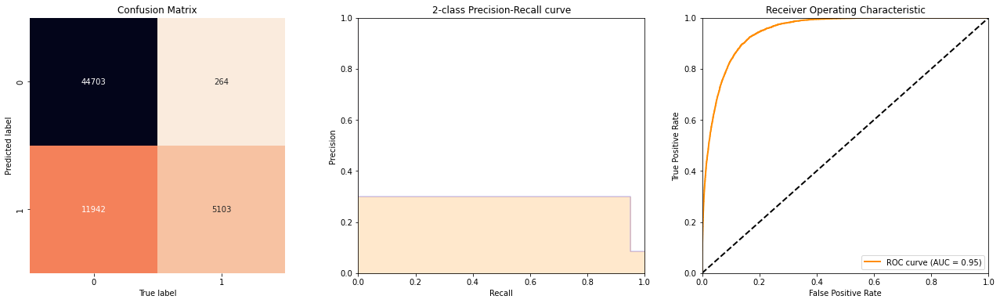

In [134]:
y_train_predCB = pipelineCB.predict(X_train)
y_train_probCB = pipelineCB.predict_proba(X_train)
show_summary_report(y_train, y_train_predCB, y_train_probCB)

Accuracy : 0.7786 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.2589 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.8370 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8925                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


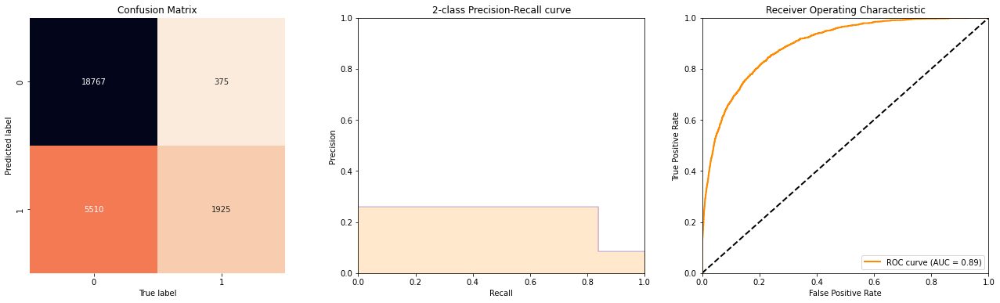

In [135]:
y_test_predCB= pipelineCB.predict(X_test)
y_test_probCB = pipelineCB.predict_proba(X_test)
show_summary_report(y_test, y_test_predCB, y_test_probCB)

In [136]:
CBP= precision_score(y_test, y_test_predCB, pos_label=1)
CBTA= accuracy_score(y_train, y_train_predCB) 
CBA= accuracy_score(y_test, y_test_predCB)
CBR = recall_score(y_test, y_test_predCB, pos_label=1)
CBROC = 0.8925

## Cross Validation

In [137]:
cv_scoresCB = cross_val_score(pipelineCB, X_train, y_train, cv=4)
print("Cross Validation Scores are:", cv_scoresCB)
meanCB= np.mean(cv_scoresCB)
print("Average 4-Fold CV Score", meanCB)

Cross Validation Scores are: [0.78300974 0.78442882 0.77907502 0.7823647 ]
Average 4-Fold CV Score 0.782219570405728


#  <u> 7.Linear SVC  <u>

In [138]:
X= data2.drop('hospital_death', axis=1).values
y = data2['hospital_death']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30,random_state=46, stratify=y ) 
X, y = make_classification(n_samples=1000, n_features=20, n_informative=15, n_redundant=5, random_state=5, weights=[0.9])


In [139]:
scaler = StandardScaler()
model = LinearSVC( class_weight= 'balanced', max_iter=1000,)
under = RandomUnderSampler(sampling_strategy=0.5)

steps = [('scaler', scaler), ('under', under), ('model', model)]
pipelineLSVC = Pipeline(steps=steps)
pipelineLSVC.fit(X_train, y_train)

C:\Users\61425\anaconda3\lib\site-packages\sklearn\svm\_base.py:1225: ConvergenceWarning:

Liblinear failed to converge, increase the number of iterations.



Pipeline(steps=[('scaler', StandardScaler()),
                ('under', RandomUnderSampler(sampling_strategy=0.5)),
                ('model', LinearSVC(class_weight='balanced'))])

In [140]:
y_train_predLSVC = pipelineLSVC.predict(X_train)
y_test_predLSVC = pipelineLSVC.predict(X_test)

In [142]:
LSVCP= precision_score(y_test, y_test_predLSVC, pos_label=1)
LSVCTA= accuracy_score(y_train, y_train_predLSVC) 
LSVCA= accuracy_score(y_test, y_test_predLSVC)
LSVCR = recall_score(y_test, y_test_predLSVC, pos_label=1)
LSVCROC = 0.7862

In [143]:
cv_scoresLSVC = cross_val_score(pipelineLSVC, X_train, y_train, cv=4)
print("Cross Validation Scores are:", cv_scoresLSVC)
meanLSVC= np.mean(cv_scoresLSVC)
print("Average 4-Fold CV Score", meanLSVC)

C:\Users\61425\anaconda3\lib\site-packages\sklearn\svm\_base.py:1225: ConvergenceWarning:

Liblinear failed to converge, increase the number of iterations.

C:\Users\61425\anaconda3\lib\site-packages\sklearn\svm\_base.py:1225: ConvergenceWarning:

Liblinear failed to converge, increase the number of iterations.

C:\Users\61425\anaconda3\lib\site-packages\sklearn\svm\_base.py:1225: ConvergenceWarning:

Liblinear failed to converge, increase the number of iterations.



Cross Validation Scores are: [0.80119977 0.80281236 0.80061923 0.8052635 ]
Average 4-Fold CV Score 0.8024737147648842


C:\Users\61425\anaconda3\lib\site-packages\sklearn\svm\_base.py:1225: ConvergenceWarning:

Liblinear failed to converge, increase the number of iterations.



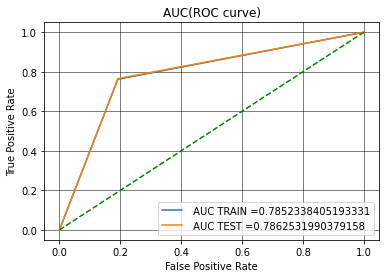

In [141]:
train_fpr1, train_tpr1, tr_thresholds1 = roc_curve(y_train, y_train_predLSVC)
test_fpr1, test_tpr1, te_thresholds1 = roc_curve(y_test, y_test_predLSVC)

plt.grid()

plt.plot(train_fpr1, train_tpr1, label=" AUC TRAIN ="+str(auc(train_fpr1, train_tpr1)))
plt.plot(test_fpr1, test_tpr1, label=" AUC TEST ="+str(auc(test_fpr1, test_tpr1)))
plt.plot([0,1],[0,1],'g--')
plt.legend()
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("AUC(ROC curve)")
plt.grid(color='black', linestyle='-', linewidth=0.5)
plt.show()

# <u> 8. XGBoost <u>

In [144]:
X= data2.drop('hospital_death', axis=1)
y = data2['hospital_death']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30,random_state=46, stratify=y ) 

scaler = StandardScaler()
model =   XGBClassifier(scale_pos_weight=2, n_estimators=100, learning_rate=0.2)
under = RandomUnderSampler()

# define pipeline
steps = [('scaler', scaler),('under', under), ('model', model)]
pipelineXGB1 = Pipeline(steps=steps)
pipelineXGB1.fit(X_train, y_train)

Pipeline(steps=[('scaler', StandardScaler()), ('under', RandomUnderSampler()),
                ('model',
                 XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
                               colsample_bylevel=1, colsample_bynode=1,
                               colsample_bytree=1, early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               gamma=0, gpu_id=-1, grow_policy='depthwise',
                               importance_type=None, interaction_constraints='',
                               learning_rate=0.2, max_bin=256,
                               max_cat_to_onehot=4, max_delta_step=0,
                               max_depth=6, max_leaves=0, min_child_weight=1,
                               missing=nan, monotone_constraints='()',
                               n_estimators=100, n_jobs=0, num_parallel_tree=1,
                               predictor='auto', random_state=0, reg_alpha=0,
                               reg_lambda=1, ...))])

Accuracy : 0.7694 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.2710 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.9849 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.9511                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


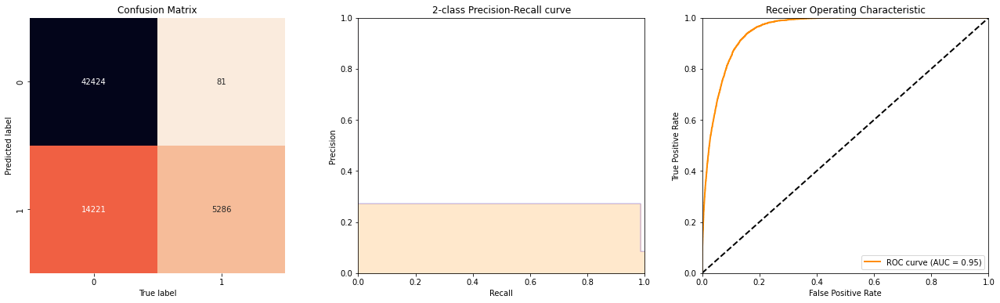

In [145]:
y_train_predXGB1 = pipelineXGB1.predict(X_train)
y_train_probXGB1 = pipelineXGB1.predict_proba(X_train)
show_summary_report(y_train, y_train_predXGB1, y_train_probXGB1)

Accuracy : 0.7365 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.2273 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.8522 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8813                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


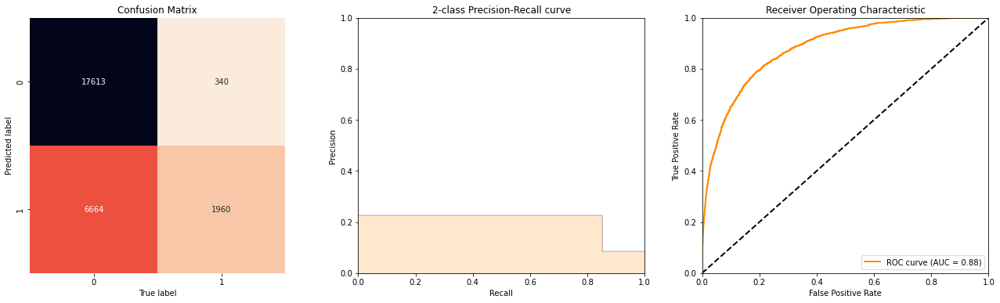

In [146]:
y_test_predXGB1 = pipelineXGB1.predict(X_test)
y_test_probXGB1= pipelineXGB1.predict_proba(X_test)
show_summary_report(y_test, y_test_predXGB1, y_test_probXGB1)

In [147]:
XGB1P= precision_score(y_test, y_test_predXGB1, pos_label=1)
XGB1TA= accuracy_score(y_train, y_train_predXGB1) 
XGB1A= accuracy_score(y_test, y_test_predXGB1)
XGB1R = recall_score(y_test, y_test_predXGB1, pos_label=1)
XGB1ROC = 0.8813

## Cross Validation

In [148]:
cv_scoresXGB1 = cross_val_score(pipelineXGB1, X_train, y_train, cv=4)
print("Cross Validation Scores are:", cv_scoresXGB1)
meanXGB1= np.mean(cv_scoresXGB1)
print("Average 4-Fold CV Score", meanXGB1)

Cross Validation Scores are: [0.73637361 0.7398568  0.73766368 0.74037283]
Average 4-Fold CV Score 0.7385667290201897


# <u> 9. Bernoulli NB <u>

In [149]:
X= data2.drop('hospital_death', axis=1).values
y = data2['hospital_death']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30,random_state=46, stratify=y ) 


In [150]:
model = BernoulliNB(alpha=0.5,  fit_prior=True) 
Scaler = StandardScaler()
under = RandomUnderSampler( random_state=42, replacement=True)


steps = [('Scaler', StandardScaler()), ('under', under), ('model', model)]
pipelineBNB = Pipeline(steps=steps)
pipelineBNB.fit(X_train, y_train)


# Fit the bagging classifier
pipelineBNB.fit(X_train, y_train)

Pipeline(steps=[('Scaler', StandardScaler()),
                ('under',
                 RandomUnderSampler(random_state=42, replacement=True)),
                ('model', BernoulliNB(alpha=0.5))])

Accuracy : 0.7397 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.2168 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.7682 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8270                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


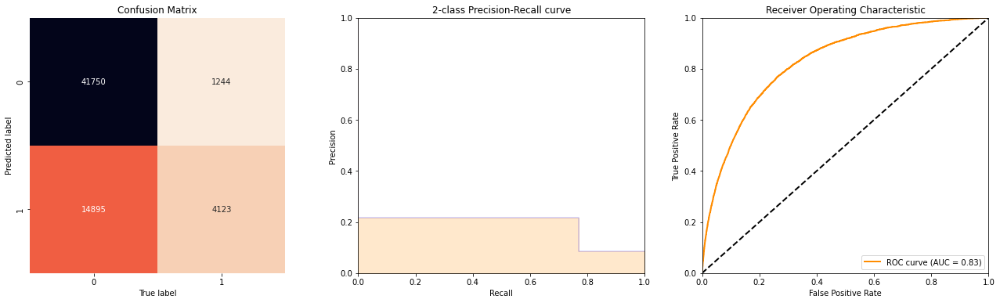

In [151]:
y_train_predBNB = pipelineBNB.predict(X_train)
y_train_probBNB = pipelineBNB.predict_proba(X_train)

show_summary_report(y_train, y_train_predBNB, y_train_probBNB)

Accuracy : 0.7354 [TP / N] Proportion of predicted labels that match the true labels. Best: 1, Worst: 0
Precision: 0.2145 [TP / (TP + FP)] Not to label a negative sample as positive.        Best: 1, Worst: 0
Recall   : 0.7726 [TP / (TP + FN)] Find all the positive samples.                     Best: 1, Worst: 0
ROC AUC  : 0.8307                                                                     Best: 1, Worst: < 0.5
-----------------------------------------------------------------------------------------------------------
TP: True Positives, FP: False Positives, TN: True Negatives, FN: False Negatives, N: Number of samples


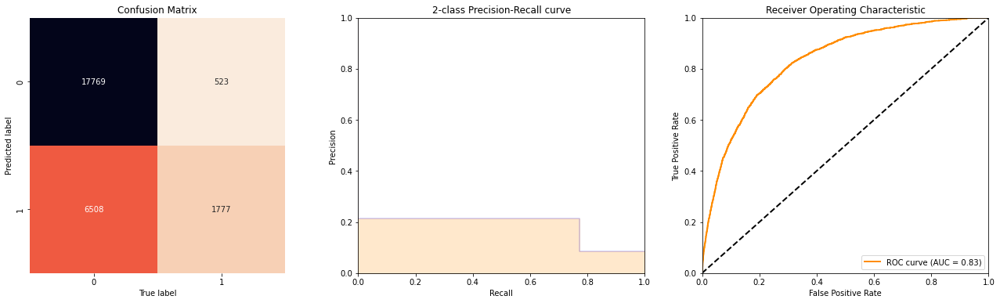

In [152]:
y_test_predBNB = pipelineBNB.predict(X_test)
y_test_probBNB = pipelineBNB.predict_proba(X_test)
show_summary_report(y_test, y_test_predBNB, y_test_probBNB)

In [153]:
BNBP= precision_score(y_test, y_test_predBNB, pos_label=1)
BNBTA= accuracy_score(y_train, y_train_predBNB) 
BNBA= accuracy_score(y_test, y_test_predBNB)
BNBR = recall_score(y_test, y_test_predBNB, pos_label=1)
BNBROC = 0.8307

## Cross Validation

In [154]:
cv_scoresBNB = cross_val_score(pipelineBNB, X_train, y_train, cv=4)
print("Cross Validation Scores are:", cv_scoresBNB)
meanBNB= np.mean(cv_scoresBNB)
print("Average 4-Fold CV Score", meanBNB)

Cross Validation Scores are: [0.74101787 0.74146939 0.73901825 0.73650261]
Average 4-Fold CV Score 0.7395020318648003


# <u> 10. SGDClassifier <u>

### Gridsearch

In [155]:
from sklearn.linear_model import SGDClassifier

sgd = SGDClassifier()
parameters = {
    'alpha' : [0.000001,0.00001, 0.0001, 0.001, 0.01, 0.1, 1],
    'loss' : ['hinge', 'log'],
    'penalty' : ['l1', 'l2']
}

grid_search = GridSearchCV(sgd, parameters, cv = 3, n_jobs = -1)
grid_search.fit(X_train, y_train)

GridSearchCV(cv=3, estimator=SGDClassifier(), n_jobs=-1,
             param_grid={'alpha': [1e-06, 1e-05, 0.0001, 0.001, 0.01, 0.1, 1],
                         'loss': ['hinge', 'log'], 'penalty': ['l1', 'l2']})

In [156]:
grid_search.best_params_

{'alpha': 1e-05, 'loss': 'hinge', 'penalty': 'l2'}

In [157]:
X= data2.drop('hospital_death', axis=1).values
y = data2['hospital_death']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30,random_state=46, stratify=y ) 



In [158]:
model = SGDClassifier(loss="hinge", penalty='l1', alpha=1e-06)
Scaler = StandardScaler()
under = RandomUnderSampler( random_state=42, replacement=True)


steps = [('Scaler', StandardScaler()), ('under', under), ('model', model)]
pipelineSGD = Pipeline(steps=steps)
pipelineSGD.fit(X_train, y_train)


# Fit the bagging classifier
pipelineSGD.fit(X_train, y_train)

y_train_predSGD = pipelineSGD.predict(X_train)
y_predSGD = pipelineSGD.predict(X_test)

In [160]:
SGDP= precision_score(y_test, y_predSGD, pos_label=1)
SGDTA= accuracy_score(y_train, y_train_predSGD) 
SGDA= accuracy_score(y_test, y_predSGD)
SGDR = recall_score(y_test, y_predSGD, pos_label=1)
SGDROC = 0.7063

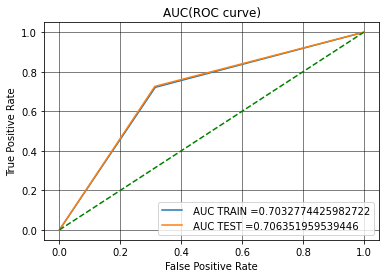

In [159]:
train_fpr, train_tpr, tr_thresholds = roc_curve(y_train, y_train_predSGD)
test_fpr, test_tpr, te_thresholds = roc_curve(y_test, y_predSGD)

plt.grid()

plt.plot(train_fpr, train_tpr, label=" AUC TRAIN ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label=" AUC TEST ="+str(auc(test_fpr, test_tpr)))
plt.plot([0,1],[0,1],'g--')
plt.legend()
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("AUC(ROC curve)")
plt.grid(color='black', linestyle='-', linewidth=0.5)
plt.show()

## Cross Validation

In [161]:
cv_scoresSGD = cross_val_score(pipelineSGD, X_train, y_train, cv=4)
print("Cross Validation Scores are:", cv_scoresSGD)
meanSGD= np.mean(cv_scoresSGD)
print("Average 4-Fold CV Score", meanSGD)

Cross Validation Scores are: [0.71037864 0.6690963  0.78978262 0.70599239]
Average 4-Fold CV Score 0.7188124879055666


# 8. Final Results

In [162]:
results=  {'Model': ['Logistic Regression',
                           'RandomForestClassifier', 
                           'Extra Tress', 
                           'GradientBoostingClassifier', 
                           'BaggingClassifier(DecisionTreeClassifier)',
                          'BaggingClassifier(LogisticRegression)',
                          'BaggingClassifier(BernoulliNB)',
                          'BaggingClassifier(KNeighborsClassifier)',
                          ' BaggingClassifier(SVC)',
                          'BaggingClassifier(CatBoostClassifier)',
                    'CatBoostClassifier',
                     'LinearSVC()','XGBClassifier',
                    ' BernoulliNB','SGDClassifier'], 
                 'Test_Accuracy': [LR1TA,RF1TA, ET1TA,GB1TA,BDTTA,BLRTA,BBNBTA,BKNNTA,BSVCTA,BCBTA,CBTA,LSVCTA,XGB1TA,BNBTA,SGDTA],
                 'Accuracy': [LR1A,RF1A, ET1A,GB1A,BDTA,BLRA,BBNBA,BKNNA,BSVCA,BCBA,CBA,LSVCA,XGB1A,BNBA,SGDA], 
                 'Recall_score':[LR1R,RF1R, ET1R,GB1R,BDTR,BLRR,BBNBR,BKNNR,BSVCR,BCBR,CBR,LSVCR,XGB1R,BNBR,SGDR], 
                 'Precision':[LR1P,RF1P, ET1P,GB1P,BDTP,BLRP,BBNBP,BKNNP,BSVCP,BCBP,CBP,LSVCP,XGB1P,BNBP,SGDP], 
                 'ROC':[LR1ROC, RF1ROC, ET1ROC,GB1ROC,BDT1ROC,BLR1ROC,BBNBROC,BKNNROC,BSVCROC,BCBROC,CBROC,LSVCROC,XGB1ROC,BNBROC,SGDROC ]}  

df4 = pd.DataFrame(results)  




s = df4.style.apply(lambda x: ["background-color:lime; font-size:1rem;" if i>0.81 \
                          else "background-color:tomato; font-size:0.9rem;" for i in x],
                   subset=["Test_Accuracy","Accuracy","Recall_score","Precision","ROC"],
                   )


s

,Model,Test_Accuracy,Accuracy,Recall_score,Precision,ROC
0,Logistic Regression,0.855186,0.857767,0.844231,0.410600,0.923000
1,RandomForestClassifier,0.821664,0.783572,0.818696,0.260876,0.876500
2,Extra Tress,0.835290,0.797795,0.799130,0.272296,0.881200
3,GradientBoostingClassifier,0.824373,0.789216,0.823043,0.267071,0.888000
4,BaggingClassifier(DecisionTreeClassifier),0.825227,0.787636,0.753043,0.254407,0.853800
5,BaggingClassifier(LogisticRegression),0.802200,0.800542,0.767826,0.270320,0.870000
6,BaggingClassifier(BernoulliNB),0.739599,0.735448,0.774348,0.214759,0.830900
7,BaggingClassifier(KNeighborsClassifier),0.818003,0.770252,0.616957,0.213576,0.773300
8,BaggingClassifier(SVC),0.801958,0.801595,0.772174,0.272184,0.818000
9,BaggingClassifier(CatBoostClassifier),0.816374,0.794559,0.818696,0.271874,0.892600


<AxesSubplot:xlabel='Model'>

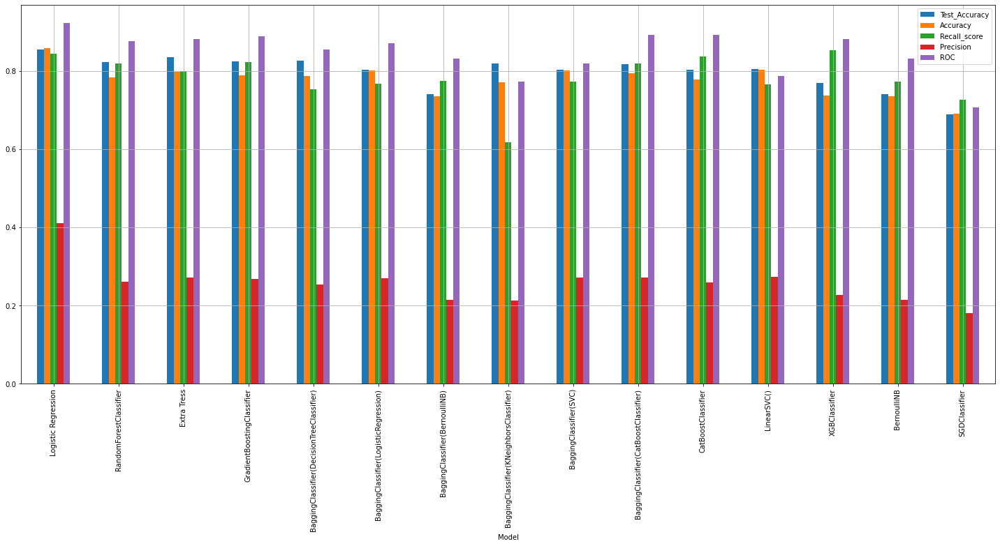

In [163]:
df4.plot(kind='bar',figsize=(25,10),grid=True, x ='Model')